To tackle the problem of counting the cars and trucks from a spectator point of view on the side of the road, I got inspired with the way vehicles are counted by city planners. What is normally used is a cable that is sensitive to presure and any time the tires of a vehicle cross this special cables it adds to the count. They can use the ammount of tires and different presures to determine which kind of vehicle has crossed this detection point.

In my case as I only have access to the provided images, I also wanted to implement a detection point and consider every vehicle that crosses this point as counted. For this a specific point had to be selected and I chose the one located in between the pixels 420 and 450 (30 pixels width) of the image of a total width of 1600 pixels. This specific area show the lanes after the merge lane has already disappeared for the cars that are heading to the left (of the top view perspective in the images). Therefore, this helps reduce the posibility of cars changing lanes midway and affecting the count.

Of course as the count will only happen at this specific part, some vehicles can be left out on the first frame that is available as this vehicles will never cross the proposed area. In order to avoid this, before this automatic counting process begins the code asks the user to input the amount of cars/trucks that they see in these 2 parts of the road to consider them in the final count. This could have also been automated using kmeans to find each vehicle and adding them to the count, but some vehicles could be exactly in the boundary of the image and therefore the user can decide to include them or not to avoid duplicate counting.


All images are scaled to have pixel values between 0 and 1 as this will facilitate working with them and grouping pixel values later on. The code then proceeds slicing the image at the specified 30 width detectionn point and keeping the height of 150 pixels. Additionally, a dettection point that was completely empty was identified and named empty road, this turned out to be very handy as substracting it from the image that has vehicles removes all the enviromental noise (lane divider lines and road textures). (This was based on the idea of geoinformatics to locate objects from a DSM and a DTM).

As the substraction is not perfect and not all unnecessary pixels will become 0 after the substraction, then it was important to clean the image from this noise/unnecessary pixels. To do so, the image is first converted into a binary image, where all values lower than a specified threshold are not significant and therefore have to become 0. Then as the cars/trucks have different heights in their front ends and back ends realtive to teir ceiling they show with wholes in the resulting image. Therefore, to be sure they are considered as a whole car/truck a remove_small_holes was used to fill in this empty areas. Additionally, the lonely_pixels_to_0 function was generated to find small pixels that will survive these first cleaning processes and can cause false centroid detections. This function, finds this groups of connected pixels where each pixel has a value of 1. The pixels are only considered part of a group if their max distance from another pixel in within a certain threshold. After this, if the group of identified pixels is smaller than a specified group size then a rectangle of values of 0 substitutes it. If the group is bigger than the threshold then it creates a rectangle around the centroid of the pixel group using the max and min coordinates of the pixel group and fills all the pixels inside it with a value of 1.

With rectangles of value 1 representing the vehicles in an empty background of value 0 it is easier to identify the centroids of each passing vehicle and do logic operations.

With the centroids identified, then with a conditional expression, the amount of identified vehicles is collected by lane, so if a vehicle is moving along the area concerning the lane 2 then the code can keep track of this vehicle and check how long does it take to move outside of the detection area.

Depending on the lane with and unidentified object, the vehicle frame counting process will start, this will keep track of how many frames the unidentified vehicle has been in the detection area, and when that vehicle reaches almost the edge of the detection area, the amount of frames is counted to determine if it was a small vehicle (car or motorbike) or a truck.

    Small vehicles, that will be called cars in this code, take a maximum of 6 frames to cross the entire detection area.

    Everything that takes more than 6 frames is considered a long vehicle, that will be called trucks in this code.
    
After this the frame counter per lane resets and continues considering other vehicles in the detection area.


The code then keeps track of the amount of cars that passed by lane, how many of these were cars, how many were trucks and the total amount of cars, trucks in general.


In [ ]:
# importing the required modules
import numpy as np
import matplotlib.pyplot as plt
import copy
import os

from PIL import Image
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score




import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
import os
os.environ['OMP_NUM_THREADS'] = '2'

# to get matplot figures render correctly in the notebook use:
%matplotlib inline 


Loading images for inspection

In [ ]:
image_path = 'C:\\Users\\rodri\\Downloads\\MACHINE LEARNING HOMEWORK\\3EC PROJECT\\IMAGES\\file000164.png'
image = Image.open(image_path)



# Display the image
plt.imshow(image)
#plt.title("First Image")
plt.axis('off')  # Hide axes
plt.show()

Finding the best way to visualize the array

In [ ]:
# Load data 

# Path to the directory where images are stored
folder_path ='C:\\Users\\rodri\\Downloads\\MACHINE LEARNING HOMEWORK\\3EC PROJECT\\IMAGES'


# Get a list of image file names in the folder:
image_files = [f for f in os.listdir(folder_path) if f.endswith('.png')]  # images are in PNG format
image_files.sort(key=lambda x: int(''.join(filter(str.isdigit, x))))  # Sort files numerically if they are named by numbers
#print(image_files)
#print(image_files[2000])

# Load each image and store its flattened pixel values:
pixel_values = []
width_start=420
width_end=450


img_width=((width_end)-(width_start))

print(f'image width: {img_width}')


with Image.open('C:\\Users\\rodri\\Downloads\\MACHINE LEARNING HOMEWORK\\3EC PROJECT\\IMAGES\\file000000.png') as imgstart:

    left_side_of_road = (np.array(imgstart)[0:80, 0:width_start] * 600).astype(np.float32)
    min_vall = np.min(left_side_of_road)
    max_vall = np.max(left_side_of_road)
    scaled_pixelsleft = (left_side_of_road - min_vall) / (max_vall - min_vall)
    leftsidepixels = np.array(scaled_pixelsleft)

    right_side_of_road = (np.array(imgstart)[81:150, width_end:1600] * 600).astype(np.float32)
    min_valr = np.min(right_side_of_road)
    max_valr = np.max(right_side_of_road)
    scaled_pixelsright = (right_side_of_road - min_valr) / (max_valr - min_valr)
    rightsidepixels = np.array(scaled_pixelsright)

for image_name in image_files:
    image_path = os.path.join(folder_path, image_name)
    with Image.open(image_path) as img:
        # Perform Min-Max scaling to scale pixel values between 0 and 1
        scaled_pixels = (np.array(img)[:, width_start:width_end] * 600).astype(np.float32)
        min_val = np.min(scaled_pixels)
        max_val = np.max(scaled_pixels)
        scaled_pixels = (scaled_pixels - min_val) / (max_val - min_val)
        pixel_values.append(scaled_pixels.flatten())


# Convert the list of 1D arrays into a 2D numpy array
pixel_values_array = np.array(pixel_values)

# Now 'pixel_values_array' has the shape (samples, pixel values)
print(pixel_values_array.shape)






In [ ]:

pixel_values_array = np.stack(pixel_values, axis=0)


print(pixel_values_array.shape)
print(pixel_values_array[1,:])


In [ ]:
import numpy as np
from scipy import ndimage
from skimage import morphology
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans



# Step 1: Define K-means clustering
def kmeans_clustering(X, k):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    return kmeans    

# Step 2: Average distance to the k centroids
def average_distance_to_centroids(X, kmeans):
    distances = np.zeros(X.shape[0])
    for i in range(X.shape[0]):
        distances[i] = np.linalg.norm(X[i] - kmeans.cluster_centers_[kmeans.labels_[i]])
    return np.mean(distances)

# Step 3: Determine optimal k value using elbow method
def elbow_method(X, max_clusters=10):
    wcss_values = []
    avg_distances = []
    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(X)
        wcss_values.append(kmeans.inertia_)  # WCSS
        avg_dist = average_distance_to_centroids(X, kmeans)
        avg_distances.append(avg_dist)

    # Calculate the first derivative
    wcss_diff = np.diff(avg_distances)
    slope_diff = np.diff(wcss_diff)
    slope_diff_normalized = slope_diff / np.max(slope_diff)  # Normalize the slope

    # Find the elbow point (where the slope decreases significantly)
    elbow_index = np.argmax(slope_diff_normalized) + 1
    k_optimal = elbow_index + 1  # Add 1 because of the diff operation
    
    # Plotting elbow curve only if there are enough data points
    #remove comment to show the plot
    #plt.plot(range(1, max_clusters + 1), wcss_values, marker='o')
    #plt.title('Elbow Method for Optimal K')
    #plt.xlabel('Number of Clusters (K)')
    #plt.ylabel('Average Distance to Centroids')
    #plt.show()

    return k_optimal

# Custom preprocessing to emphasize horizontal separation
def preprocess_data(X):
    # Emphasize horizontal separation by scaling the vertical component
    X[:, 1] *= 1 # Adjust the weight as needed
    X[:, 0] *= 1 # Adjust the weight as needed
    return X






def lonely_pixels_to_0(image, max_distance=1, min_group_size=4):
    # Find groups of pixels
    groups = []
    visited = set()
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            if image[i, j] == 1 and (i, j) not in visited:
                group = set()
                stack = [(i, j)]
                while stack:
                    x, y = stack.pop()
                    if (x, y) not in group:
                        group.add((x, y))
                        visited.add((x, y))
                        for dx in range(-max_distance, max_distance + 1):
                            for dy in range(-max_distance, max_distance + 1):
                                if 0 <= x + dx < image.shape[0] and 0 <= y + dy < image.shape[1]:
                                    if image[x + dx, y + dy] == 1 and (x + dx, y + dy) not in visited:
                                        stack.append((x + dx, y + dy))
                if len(group) >= min_group_size:
                    groups.append(group)

    # Find centroid and create rectangle for each group
    result_image = np.zeros_like(image)
    for group in groups:
        # Convert group coordinates to data points
        X = np.array(list(group))

        # Apply K-means clustering
        kmeans = KMeans(n_clusters=1)
        kmeans.fit(X)

        # Get centroid of the group
        centroid = kmeans.cluster_centers_[0]

        # Find the maximum and minimum x and y coordinates around the centroid
        min_x = max(int(np.min(X[:, 1])) - max_distance, 0)
        max_x = min(int(np.max(X[:, 1])) + max_distance + 1, image.shape[1])
        min_y = max(int(np.min(X[:, 0])) - max_distance, 0)
        max_y = min(int(np.max(X[:, 0])) + max_distance + 1, image.shape[0])

        # Fill in the rectangle
        result_image[min_y:max_y, min_x:max_x] = 1
        
        

    return result_image


def find_group_centroids(image):
# Label connected components (groups)
    labeled_image, num_labels = ndimage.label(image)

    # Initialize list to store centroids
    centroids = []

    # Iterate over each label (excluding background label 0)
    for label in range(1, num_labels + 1):
        # Find coordinates of all points with the current label
        y, x = np.where(labeled_image == label)
        
        # Calculate centroid of the group
        centroid = (np.mean(x), np.mean(y))
        
        # Append centroid to list
        centroids.append(centroid)

    return centroids




RUN FROM HERE

In [ ]:
#This are the cars that are not considered through the iterative process, this lane goes left, how many cars and how many trucks do you see? 
sampleleft = (leftsidepixels).reshape(80, width_start)  # sample number from 0 to 69999
plt.imshow(sampleleft)
plt.axis('off')
plt.show()


In [ ]:
#HOW MANY CARS ARE IN THE IMAGE?
carsl=2
#HOW MANY TRUCKS ARE IN THE IMAGE?
trucksl=0

In [ ]:
sampleright = (rightsidepixels).reshape(69, 1600-width_end) 

plt.figure(figsize=(10, 50))
plt.imshow(sampleright)

plt.axis('off')


plt.show()

In [ ]:
#HOW MANY CARS ARE IN THE IMAGE?
carsr=2
#HOW MANY TRUCKS ARE IN THE IMAGE?
trucksr=1

checking image number: 1


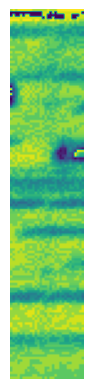

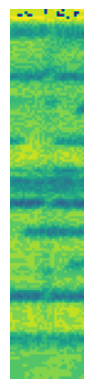

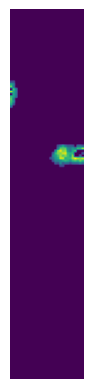

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

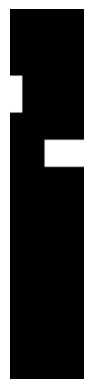

[[ 2.  34. ]
 [21.5 58. ]]


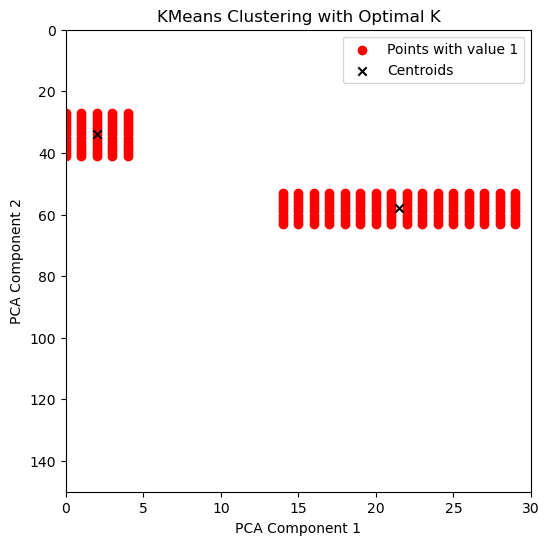

Coordinates of cluster centers:
Cluster 1: (2.0, 34.0)
Cluster 2: (21.5, 58.0)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 5.
checking image number: 2


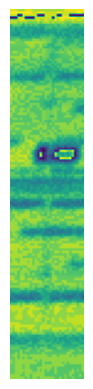

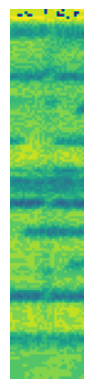

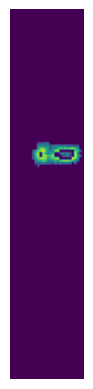

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


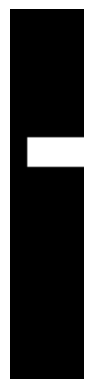

[[18.  57.5]]


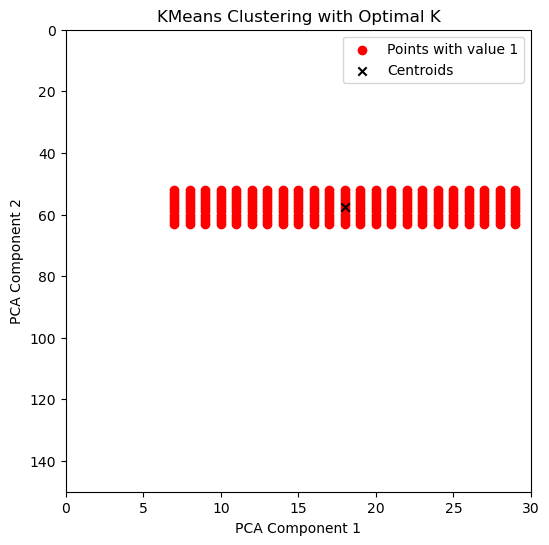

Coordinates of cluster centers:
Cluster 1: (18.0, 57.5)
seen: 1
checking image number: 3


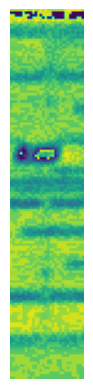

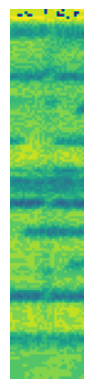

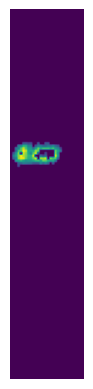

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


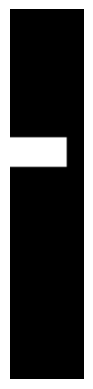

[[11.  57.5]]


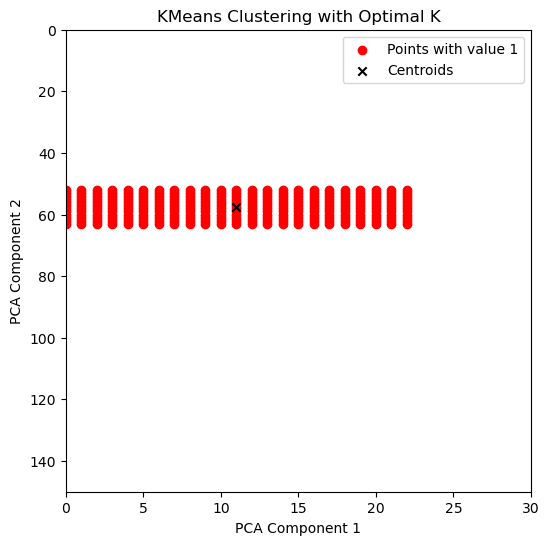

Coordinates of cluster centers:
Cluster 1: (11.0, 57.5)
seen: 1
checking image number: 4


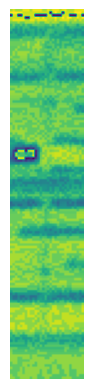

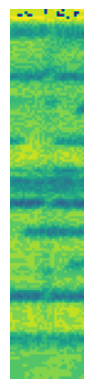

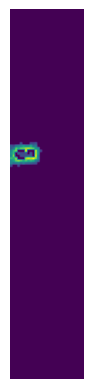

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


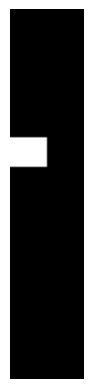

[[ 7.  57.5]]


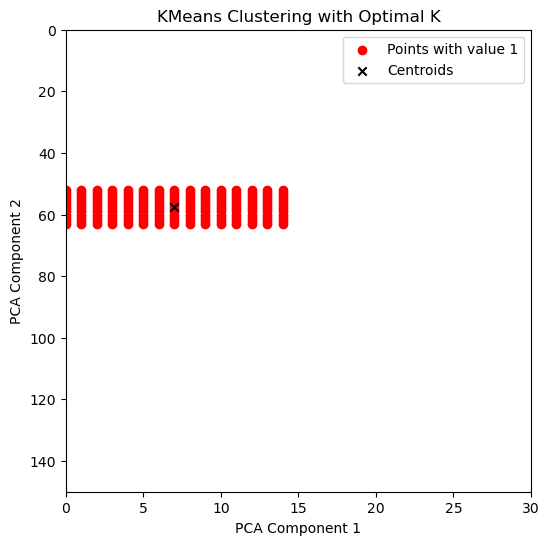

Coordinates of cluster centers:
Cluster 1: (7.0, 57.5)
seen: 1
checking image number: 5


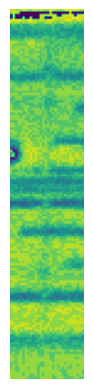

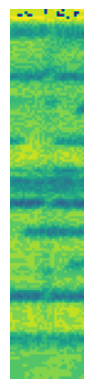

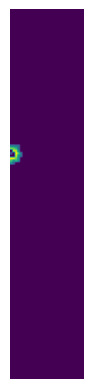

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


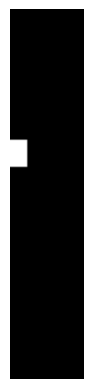

[[ 3. 58.]]


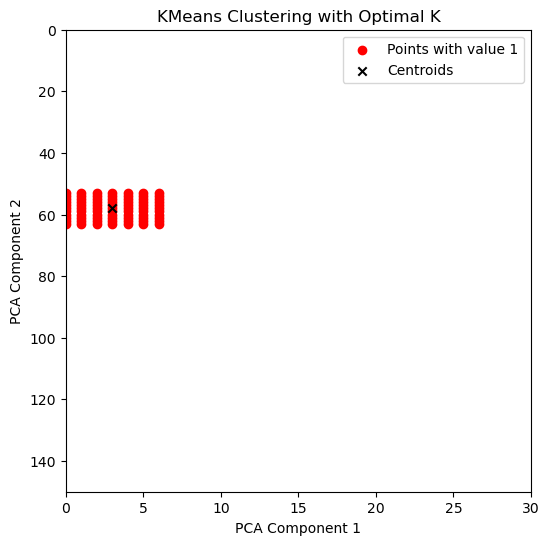

Coordinates of cluster centers:
Cluster 1: (3.0, 58.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 6.
checking image number: 6


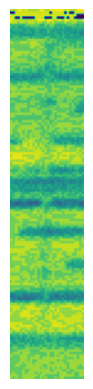

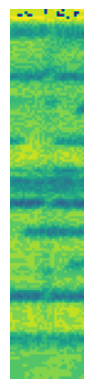

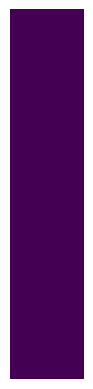

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


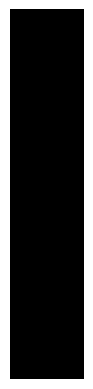

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 7


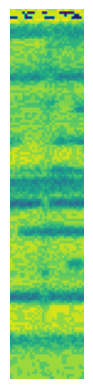

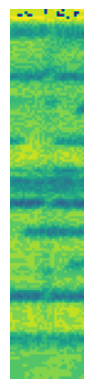

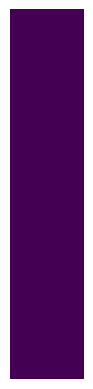

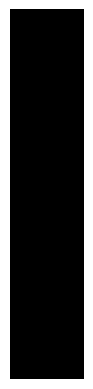

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 8


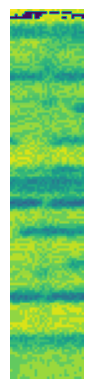

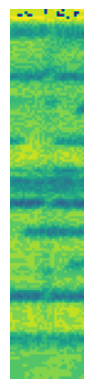

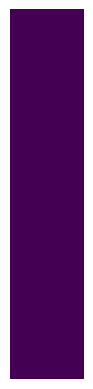

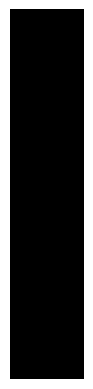

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 9


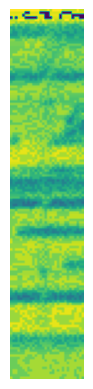

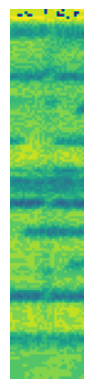

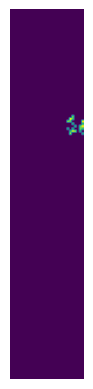

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


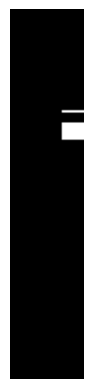

[[25. 41.]
 [25. 49.]]


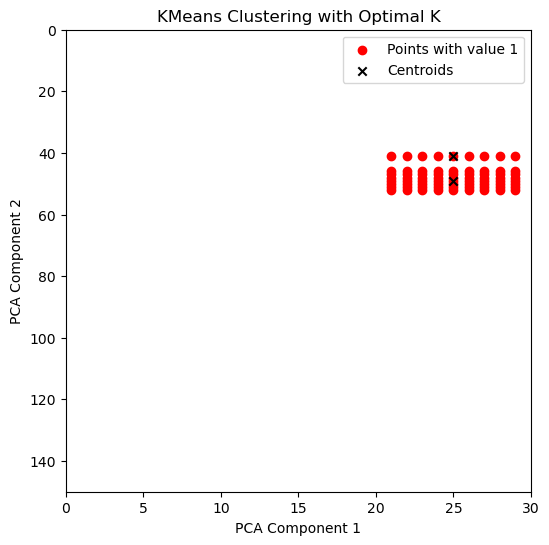

Coordinates of cluster centers:
Cluster 1: (25.0, 41.0)
Cluster 2: (25.0, 49.0)
seen: 2
checking image number: 10


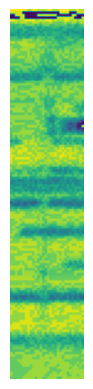

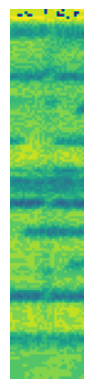

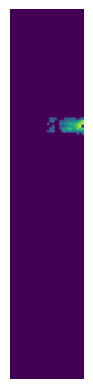

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

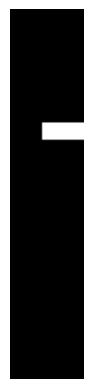

[[21. 49.]]


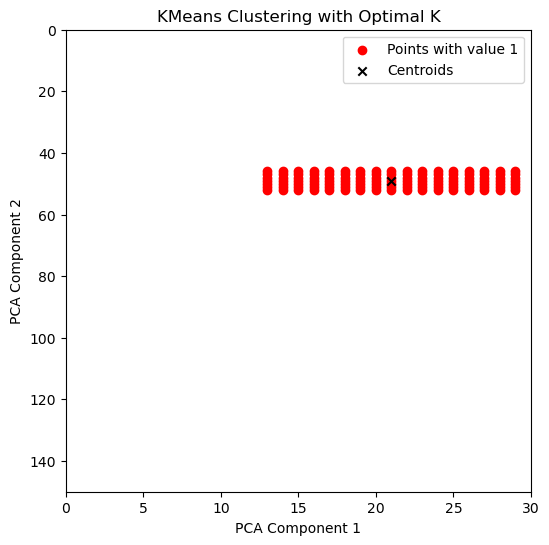

Coordinates of cluster centers:
Cluster 1: (21.0, 49.0)
seen: 1
checking image number: 11


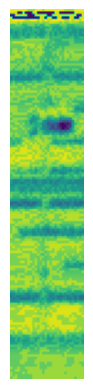

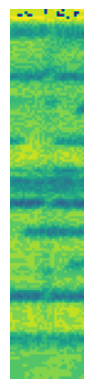

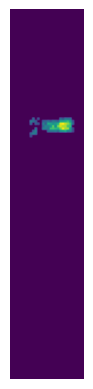

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

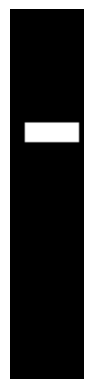

[[16.5 49.5]]


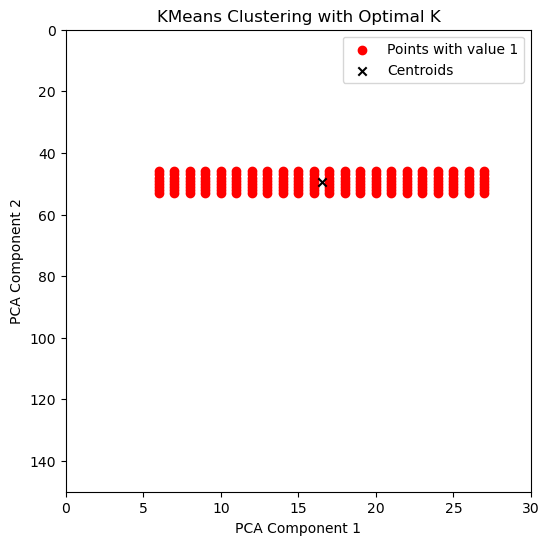

Coordinates of cluster centers:
Cluster 1: (16.5, 49.5)
seen: 1
checking image number: 12


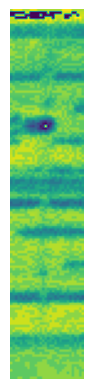

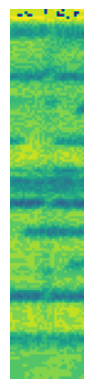

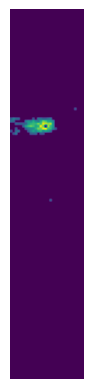

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

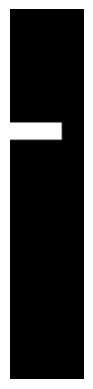

[[10. 49.]]


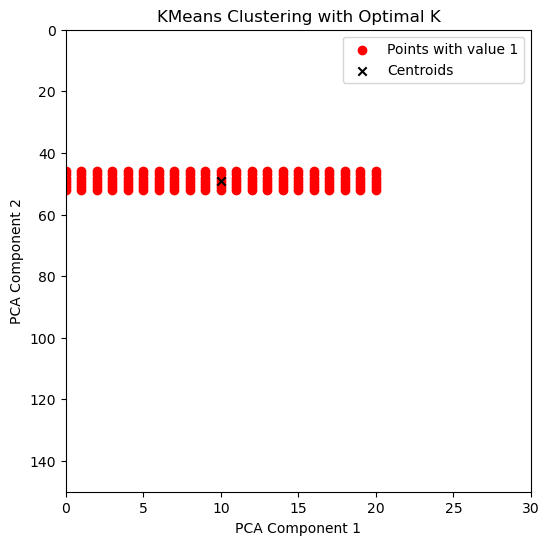

Coordinates of cluster centers:
Cluster 1: (10.0, 49.0)
seen: 1
checking image number: 13


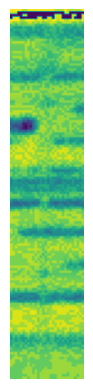

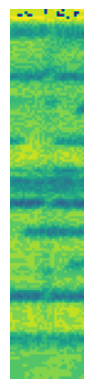

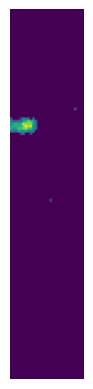

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


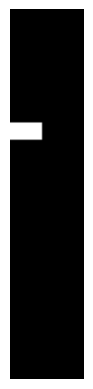

[[ 6. 49.]]


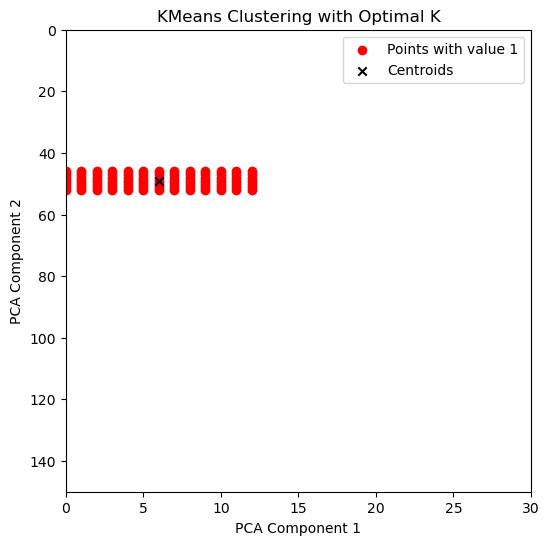

Coordinates of cluster centers:
Cluster 1: (6.0, 49.0)
seen: 1
checking image number: 14


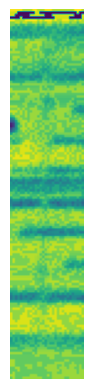

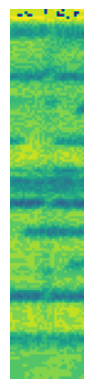

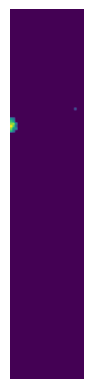

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


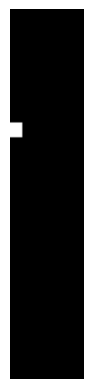

[[ 2.  48.5]]


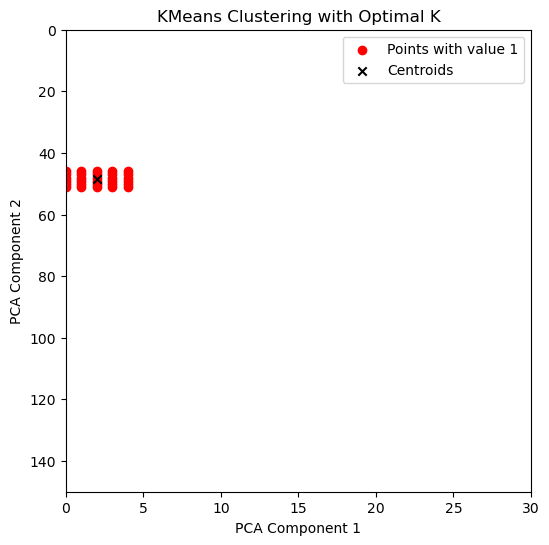

Coordinates of cluster centers:
Cluster 1: (2.0, 48.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 7.
checking image number: 15


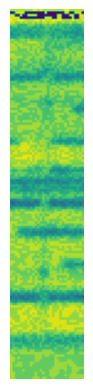

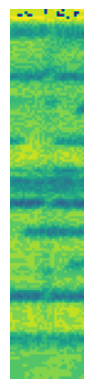

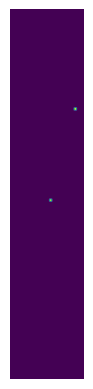

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


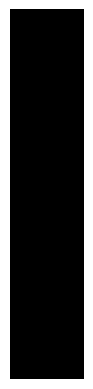

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 16


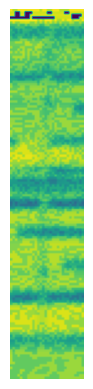

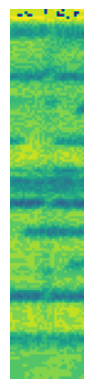

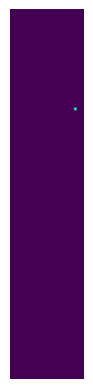

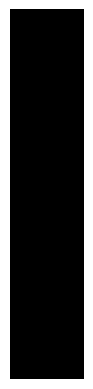

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 17


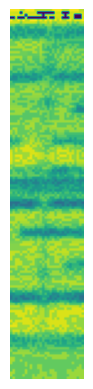

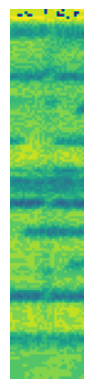

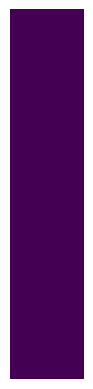

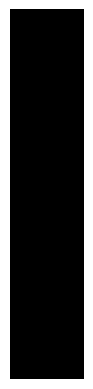

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 18


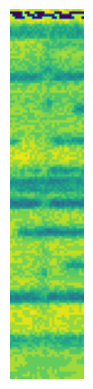

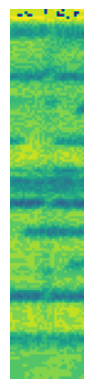

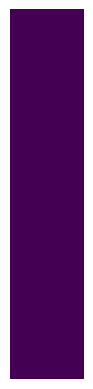

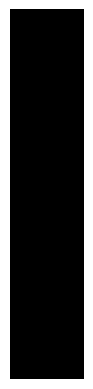

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 19


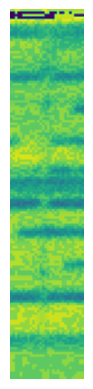

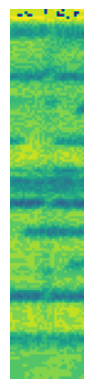

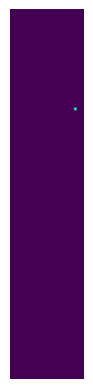

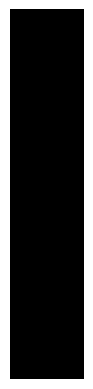

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 20


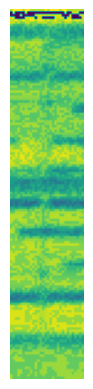

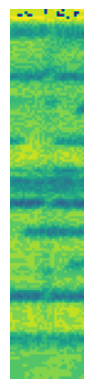

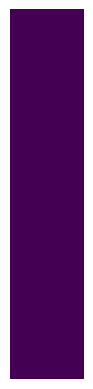

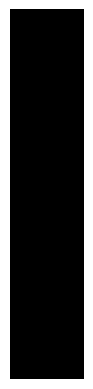

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 21


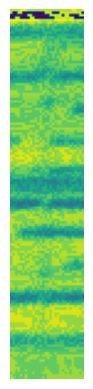

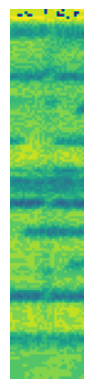

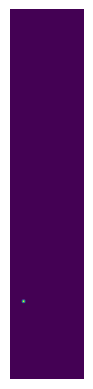

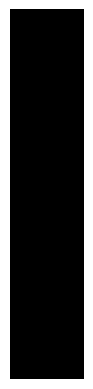

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 22


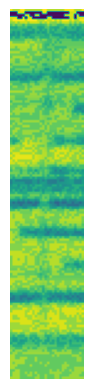

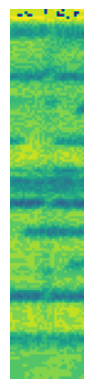

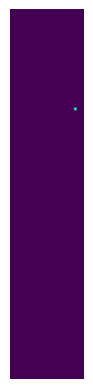

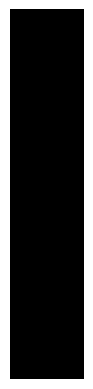

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 23


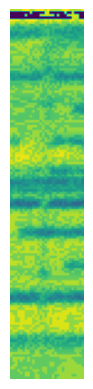

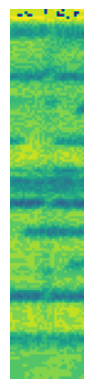

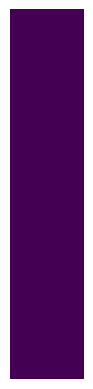

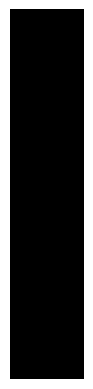

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 24


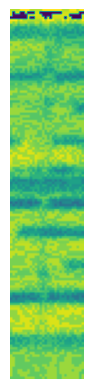

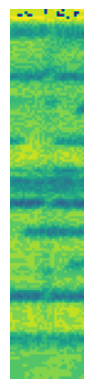

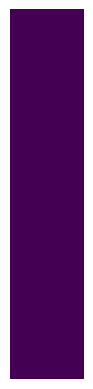

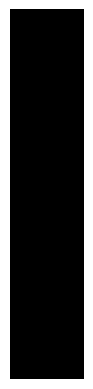

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 25


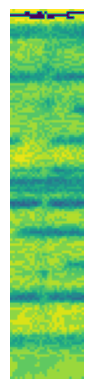

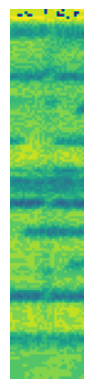

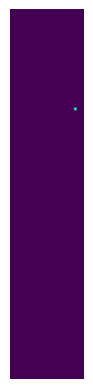

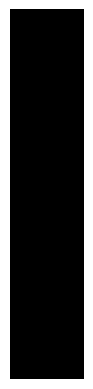

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 26


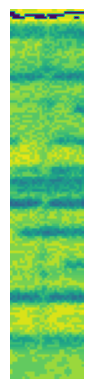

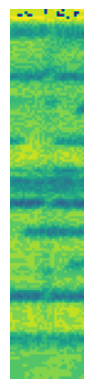

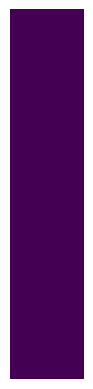

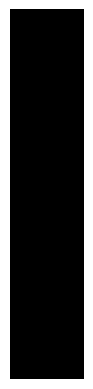

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 27


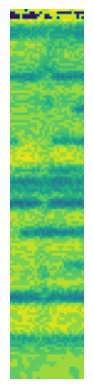

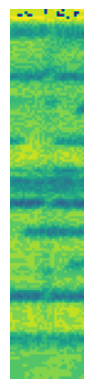

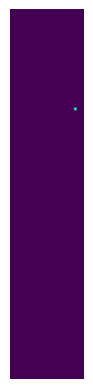

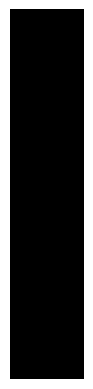

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 28


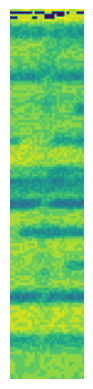

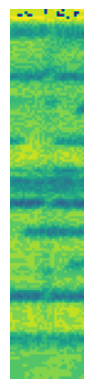

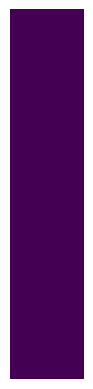

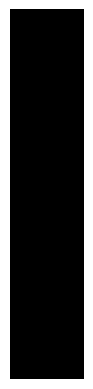

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 29


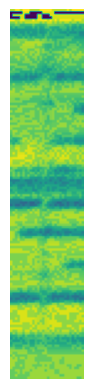

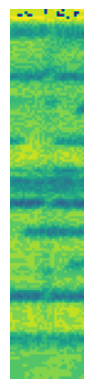

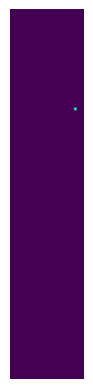

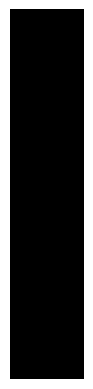

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 30


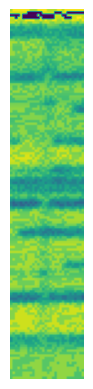

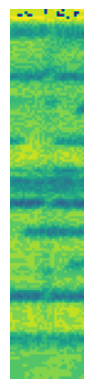

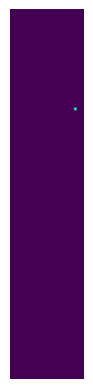

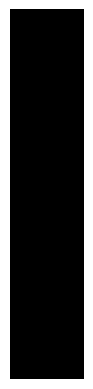

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 31


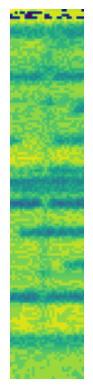

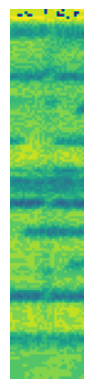

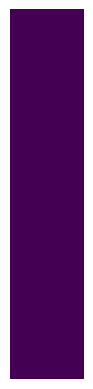

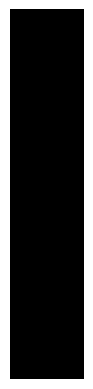

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 32


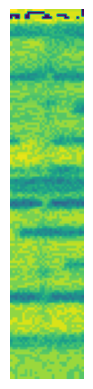

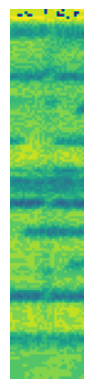

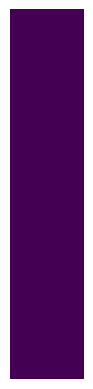

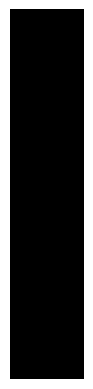

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 33


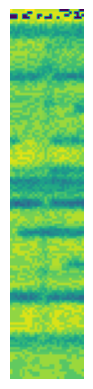

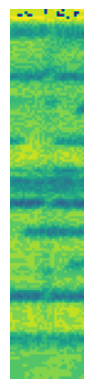

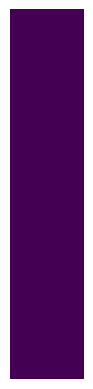

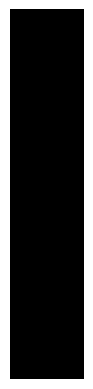

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 34


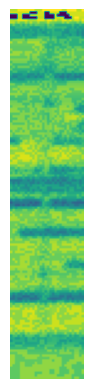

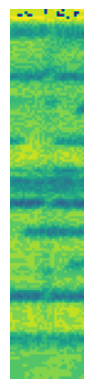

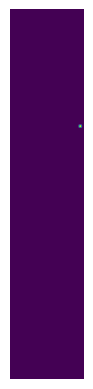

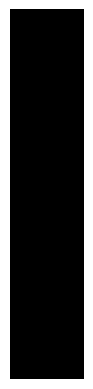

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 35


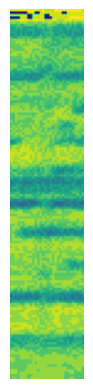

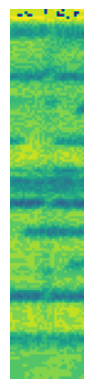

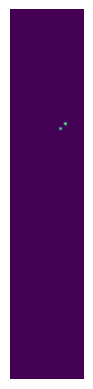

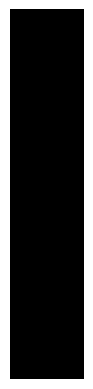

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 36


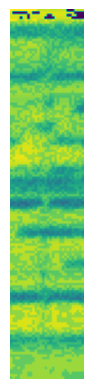

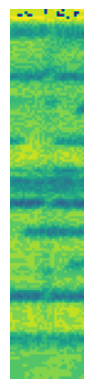

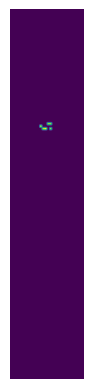

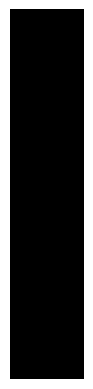

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 37


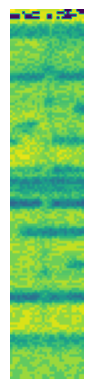

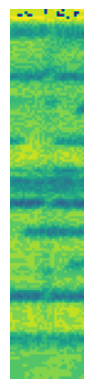

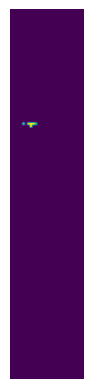

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


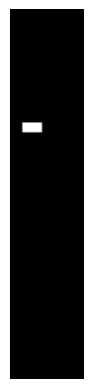

[[ 8.5 47.5]]


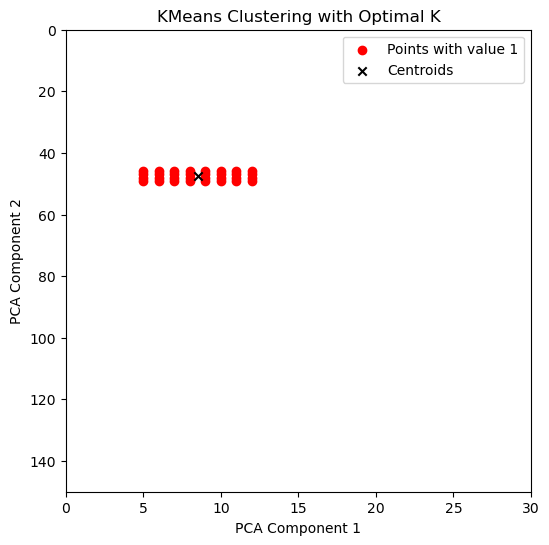

Coordinates of cluster centers:
Cluster 1: (8.5, 47.5)
seen: 1
checking image number: 38


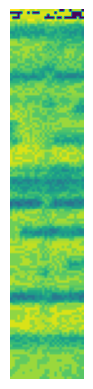

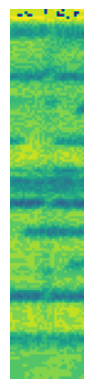

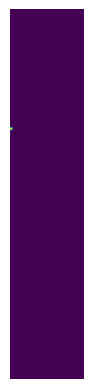

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


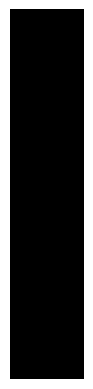

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 39


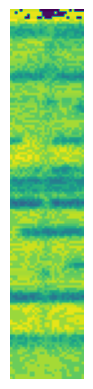

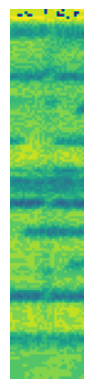

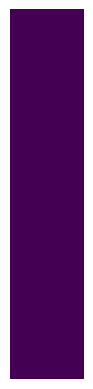

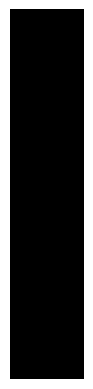

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 40


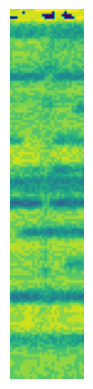

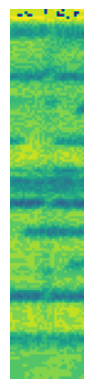

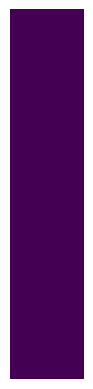

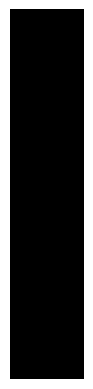

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 41


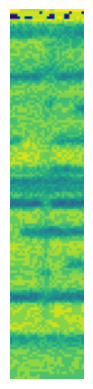

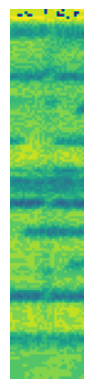

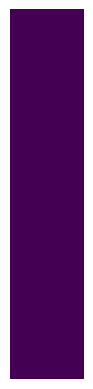

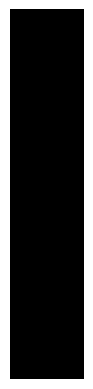

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 42


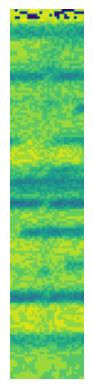

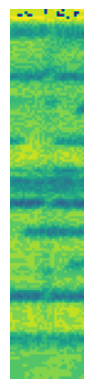

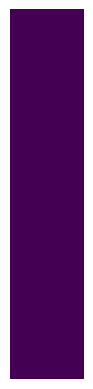

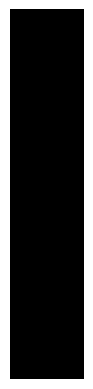

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 43


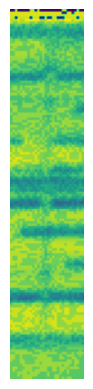

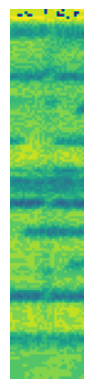

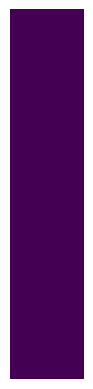

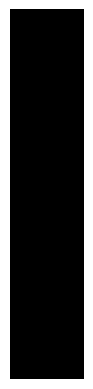

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 44


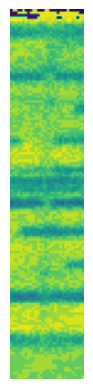

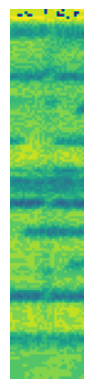

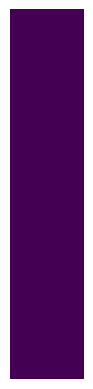

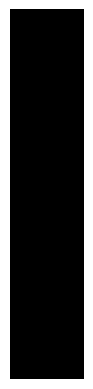

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 45


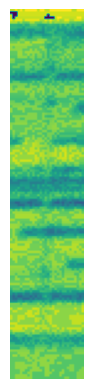

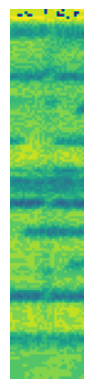

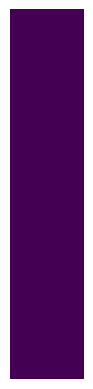

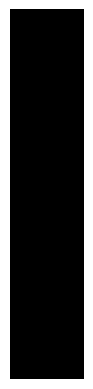

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 46


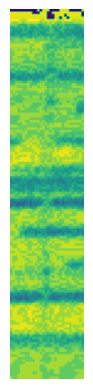

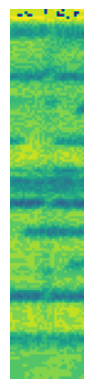

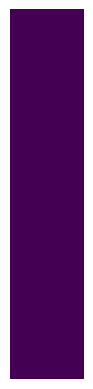

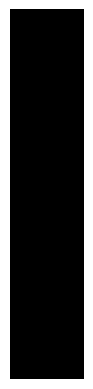

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 47


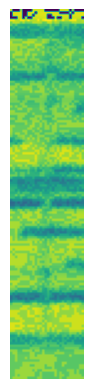

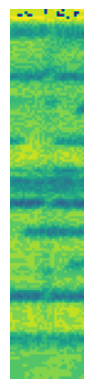

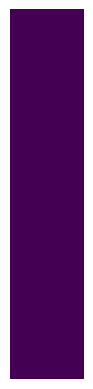

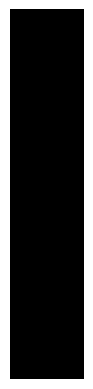

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 48


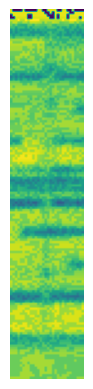

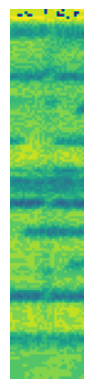

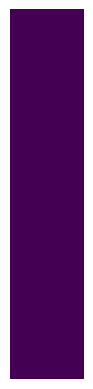

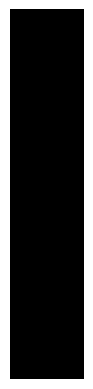

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 49


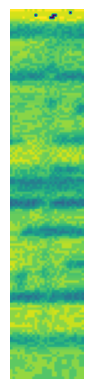

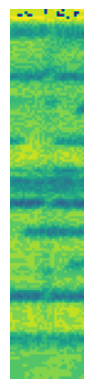

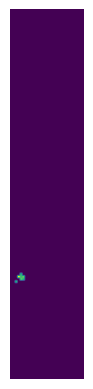

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


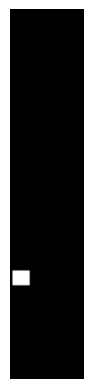

[[  4.  108.5]]


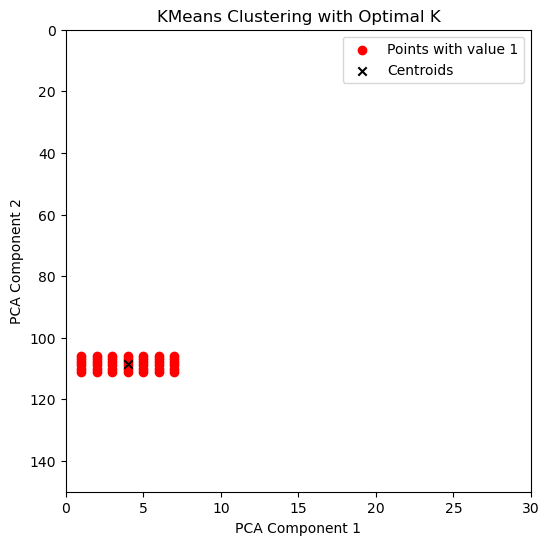

Coordinates of cluster centers:
Cluster 1: (4.0, 108.5)
seen: 1
checking image number: 50


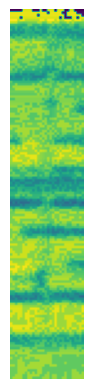

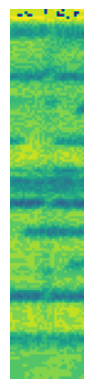

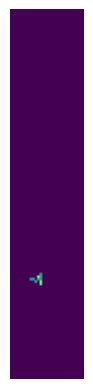

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


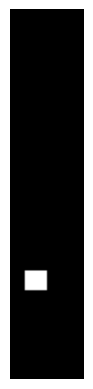

[[ 10.  109.5]]


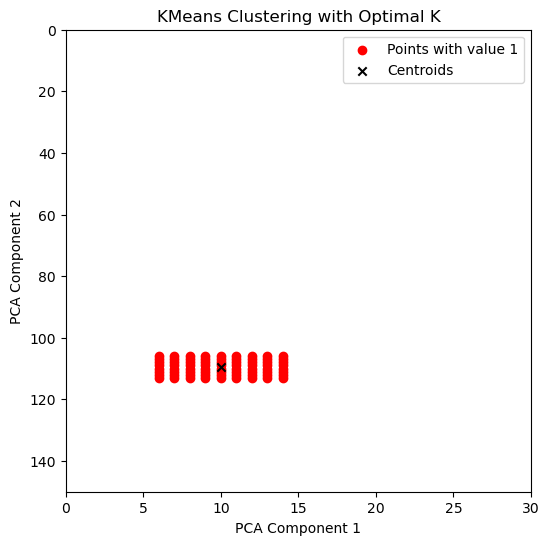

Coordinates of cluster centers:
Cluster 1: (10.0, 109.5)
seen: 1
checking image number: 51


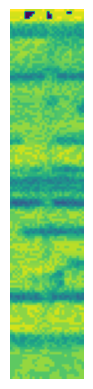

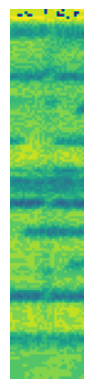

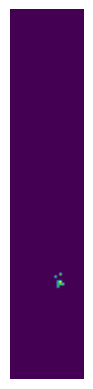

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


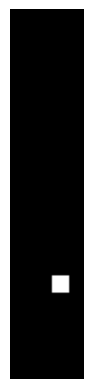

[[ 20. 111.]]


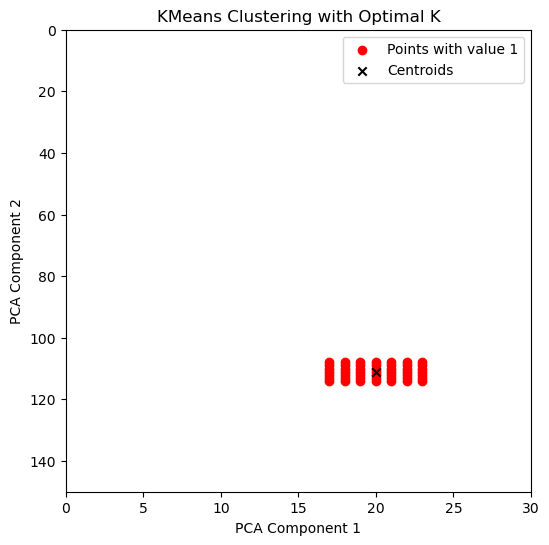

Coordinates of cluster centers:
Cluster 1: (20.0, 111.0)
seen: 1
checking image number: 52


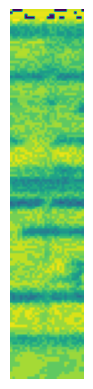

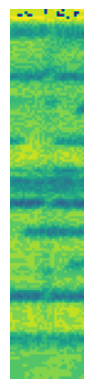

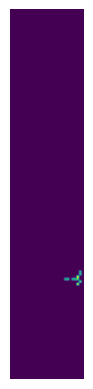

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


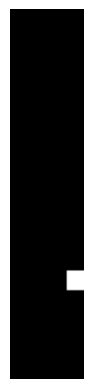

[[ 26.  109.5]]


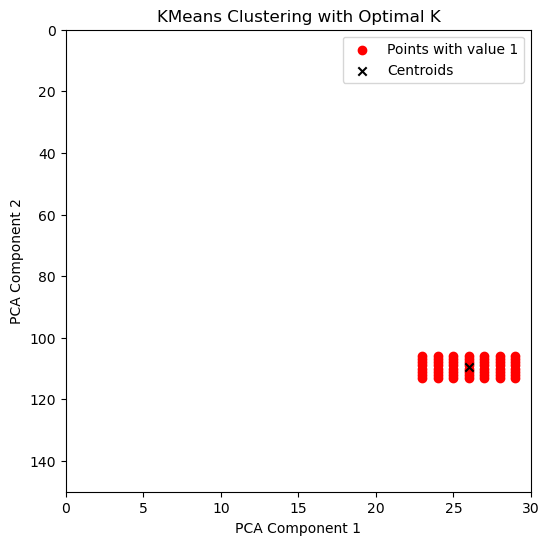

Coordinates of cluster centers:
Cluster 1: (26.0, 109.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 8.
checking image number: 53


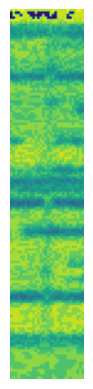

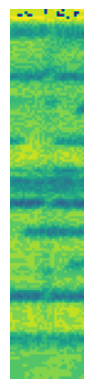

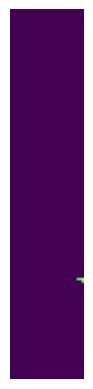

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


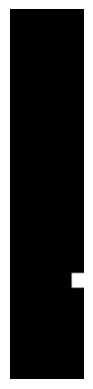

[[ 27.  109.5]]


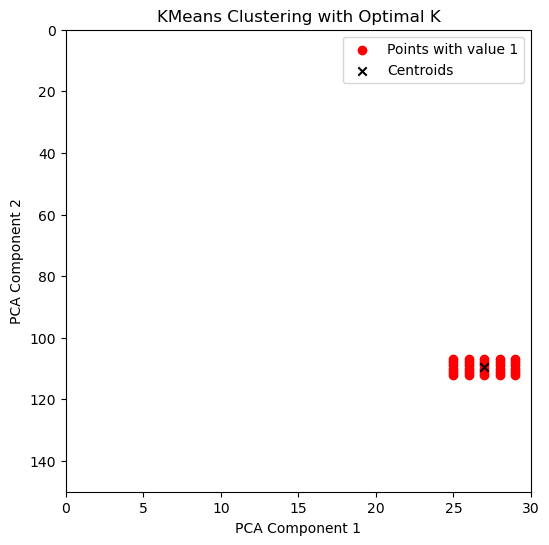

Coordinates of cluster centers:
Cluster 1: (27.0, 109.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 9.
checking image number: 54


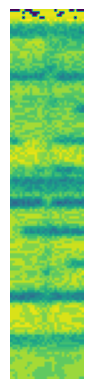

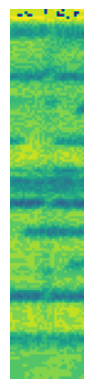

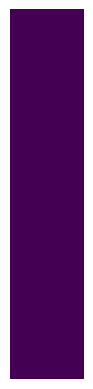

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


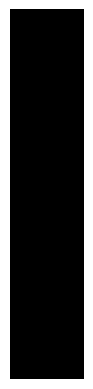

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 55


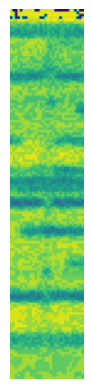

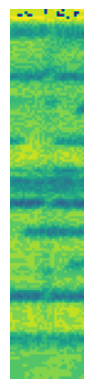

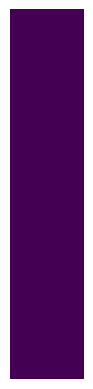

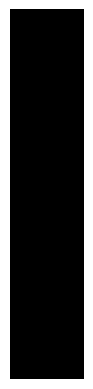

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 56


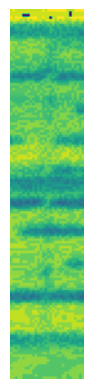

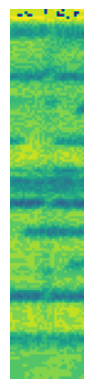

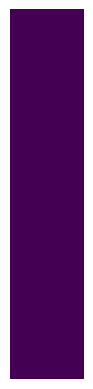

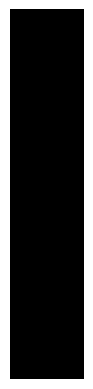

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 57


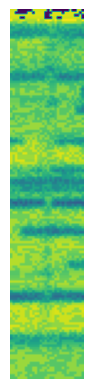

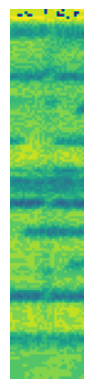

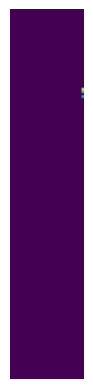

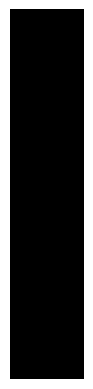

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 58


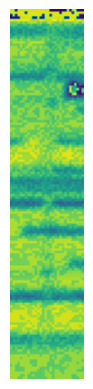

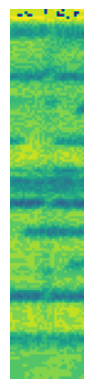

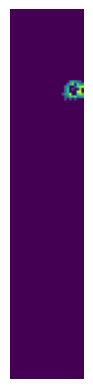

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


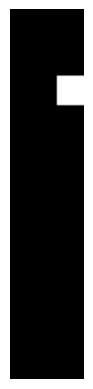

[[24.  32.5]]


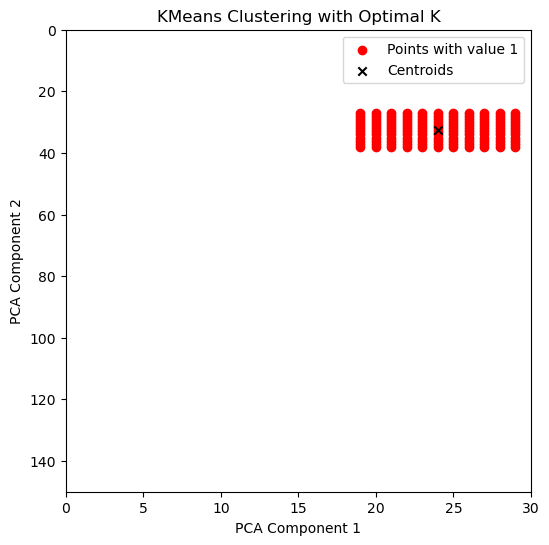

Coordinates of cluster centers:
Cluster 1: (24.0, 32.5)
seen: 1
checking image number: 59


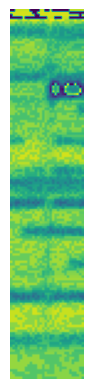

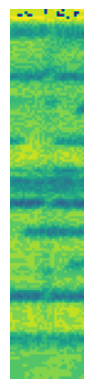

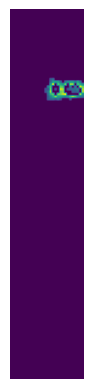

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


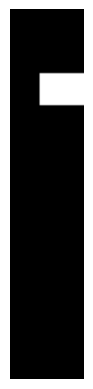

[[20.5 32. ]]


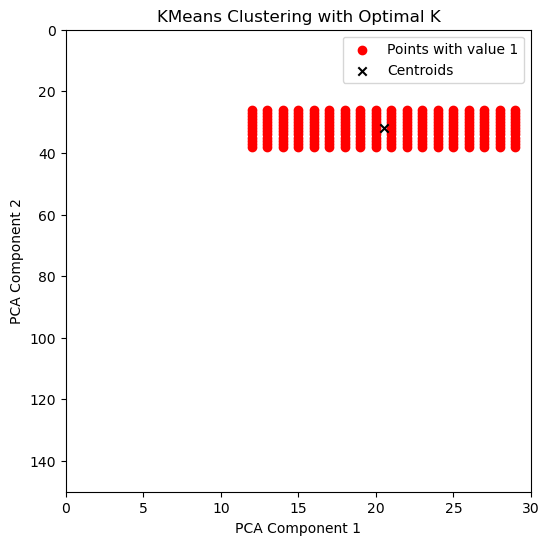

Coordinates of cluster centers:
Cluster 1: (20.5, 32.0)
seen: 1
checking image number: 60


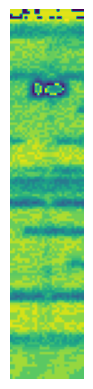

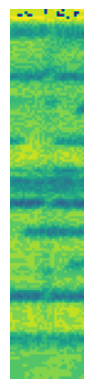

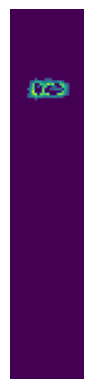

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


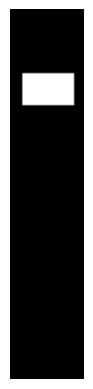

[[15. 32.]]


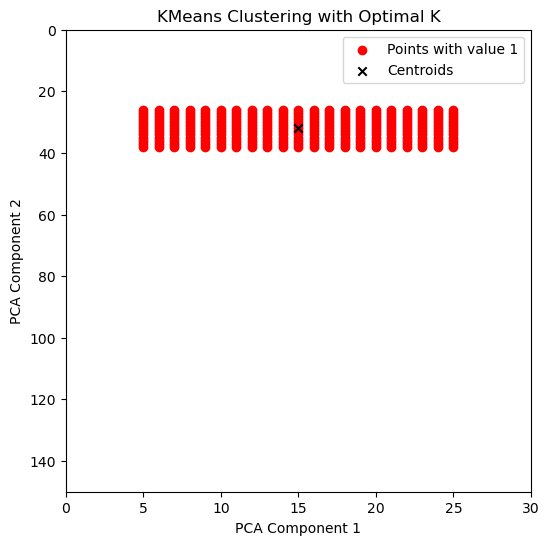

Coordinates of cluster centers:
Cluster 1: (15.0, 32.0)
seen: 1
checking image number: 61


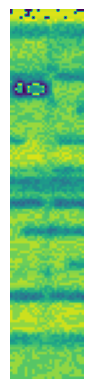

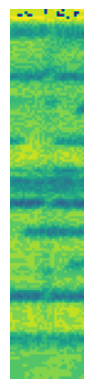

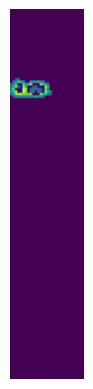

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


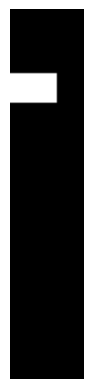

[[ 9.  31.5]]


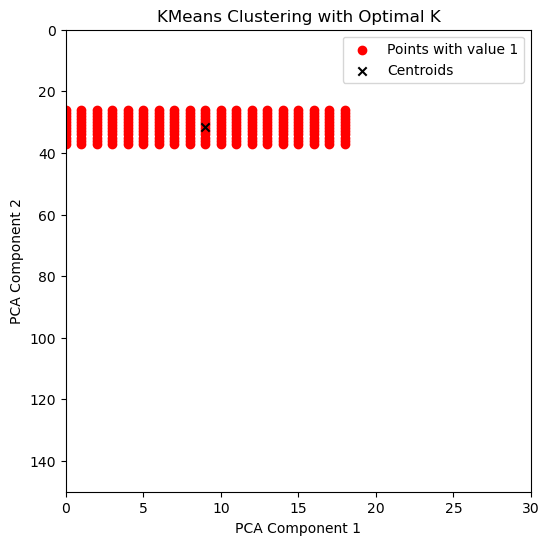

Coordinates of cluster centers:
Cluster 1: (9.0, 31.5)
seen: 1
checking image number: 62


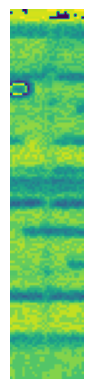

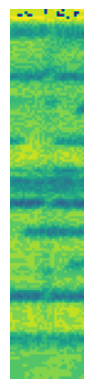

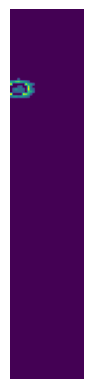

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


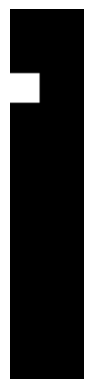

[[ 5.5 31.5]]


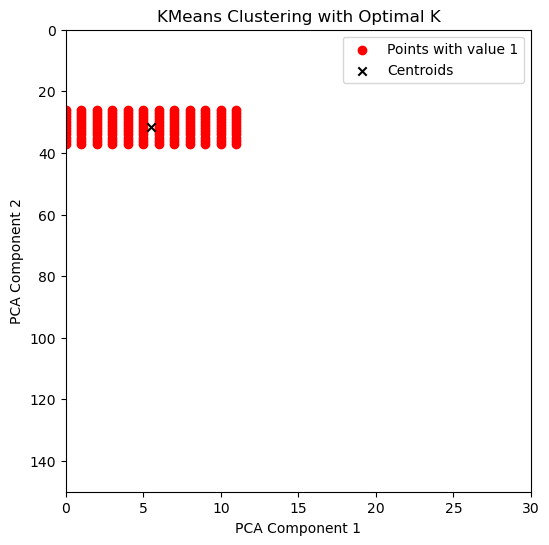

Coordinates of cluster centers:
Cluster 1: (5.5, 31.5)
seen: 1
checking image number: 63


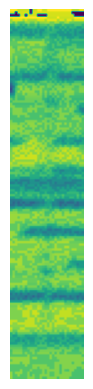

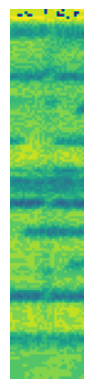

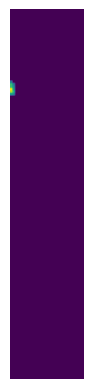

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


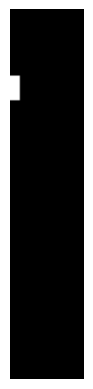

[[ 1.5 31.5]]


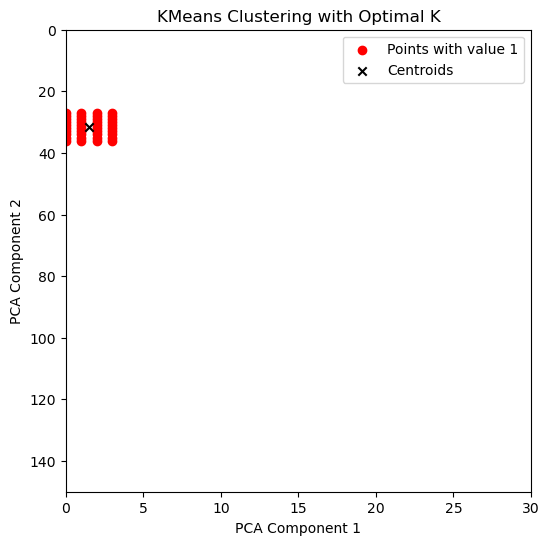

Coordinates of cluster centers:
Cluster 1: (1.5, 31.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 10.
checking image number: 64


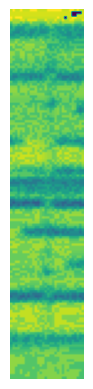

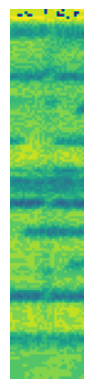

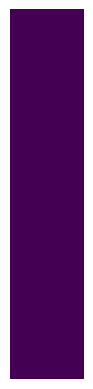

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


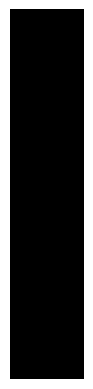

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 65


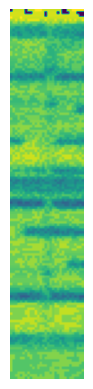

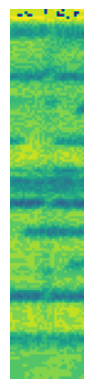

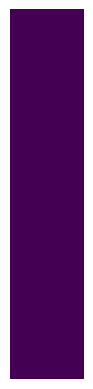

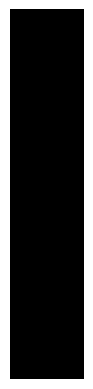

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 66


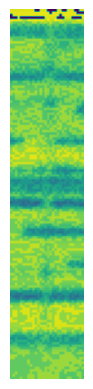

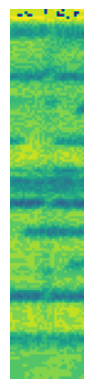

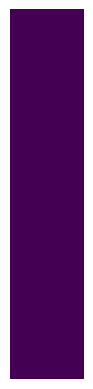

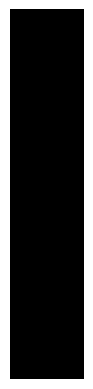

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 67


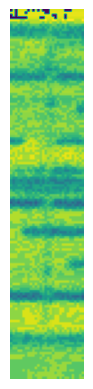

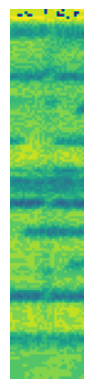

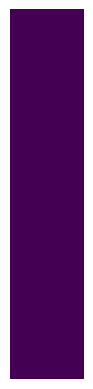

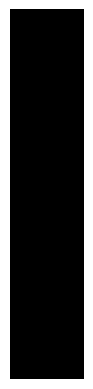

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 68


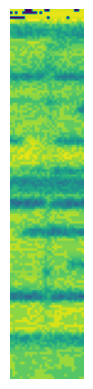

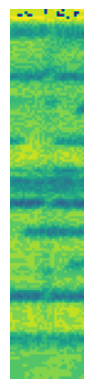

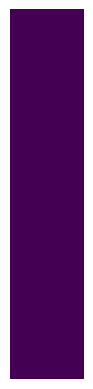

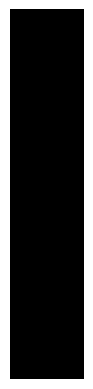

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 69


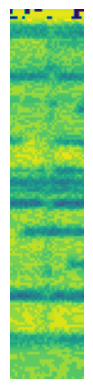

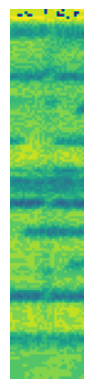

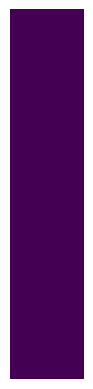

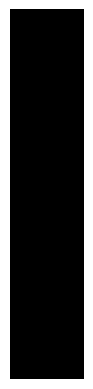

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 70


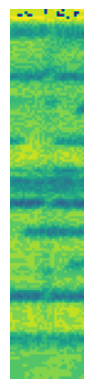

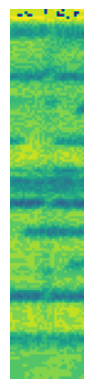

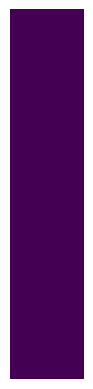

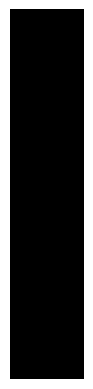

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 71


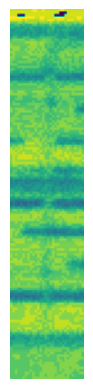

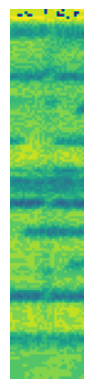

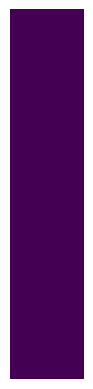

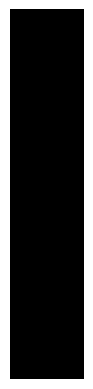

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 72


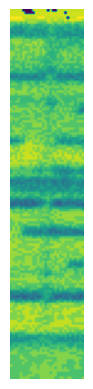

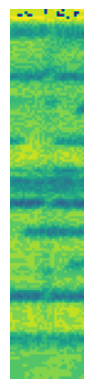

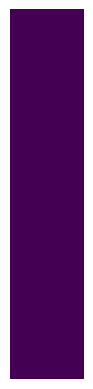

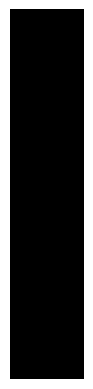

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 73


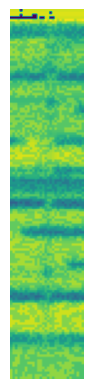

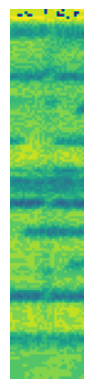

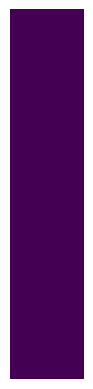

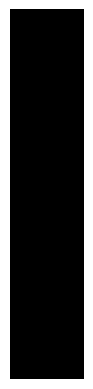

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 74


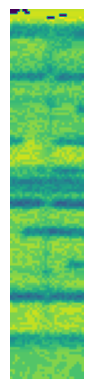

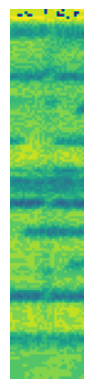

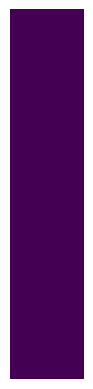

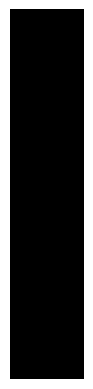

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 75


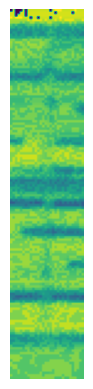

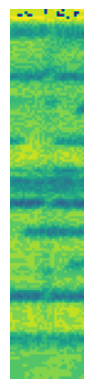

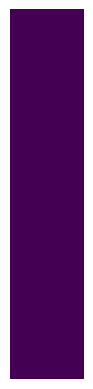

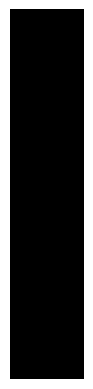

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 76


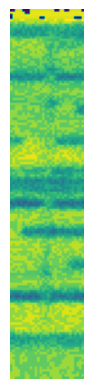

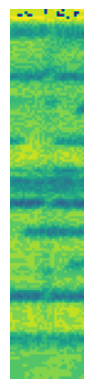

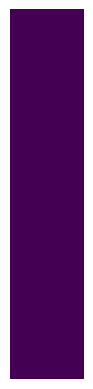

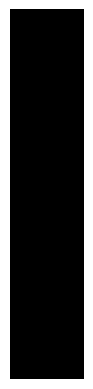

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 77


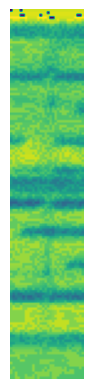

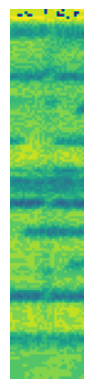

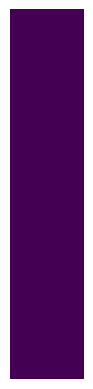

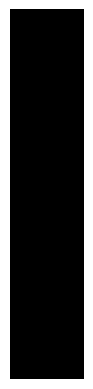

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 78


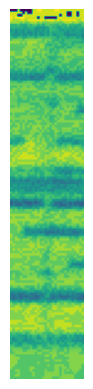

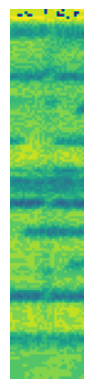

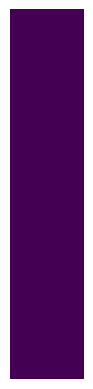

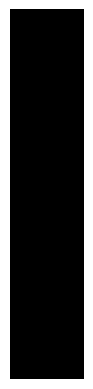

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 79


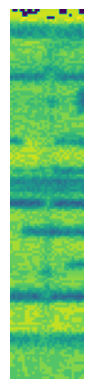

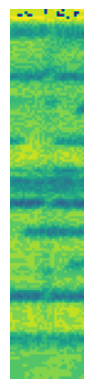

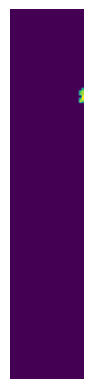

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


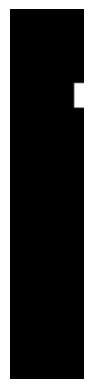

[[27.5 34.5]]


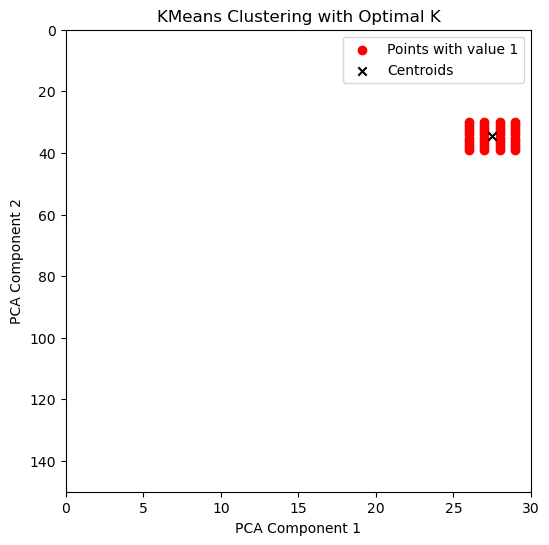

Coordinates of cluster centers:
Cluster 1: (27.5, 34.5)
seen: 1
checking image number: 80


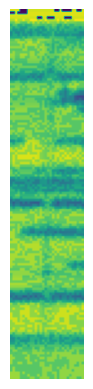

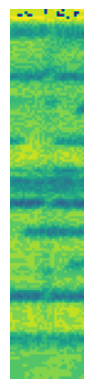

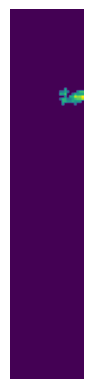

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


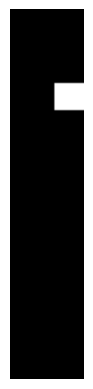

[[23.5 35. ]]


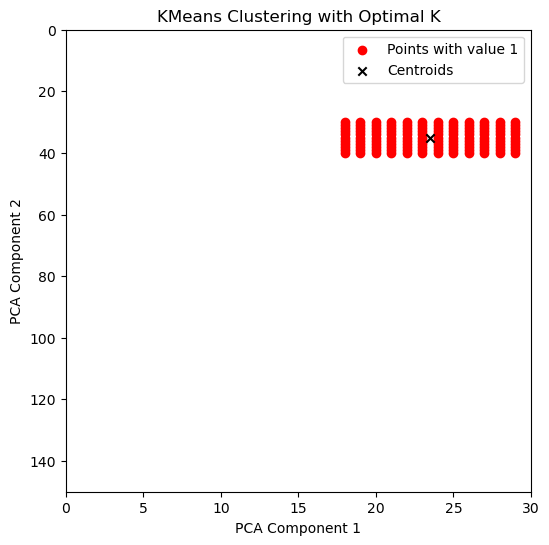

Coordinates of cluster centers:
Cluster 1: (23.5, 35.0)
seen: 1
checking image number: 81


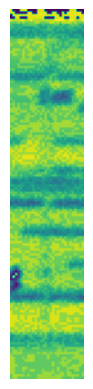

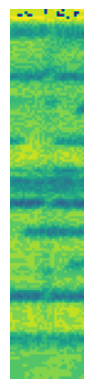

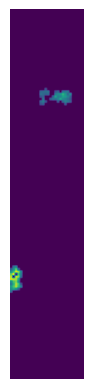

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

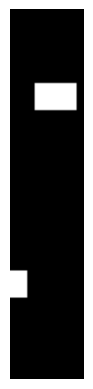

[[ 18.  35.]
 [  3. 111.]]


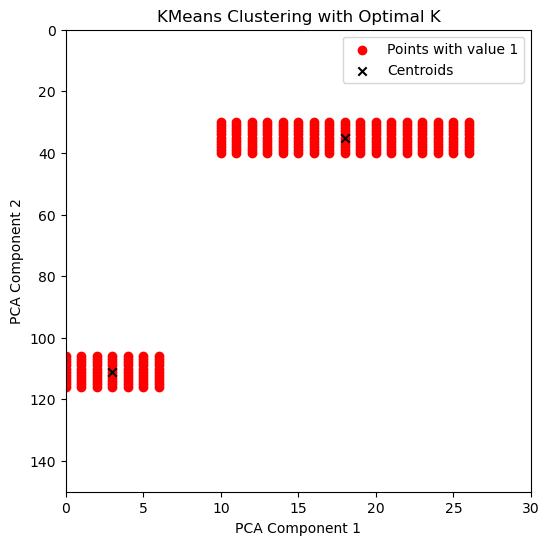

Coordinates of cluster centers:
Cluster 1: (18.0, 35.0)
Cluster 2: (3.0, 111.0)
seen: 2
checking image number: 82


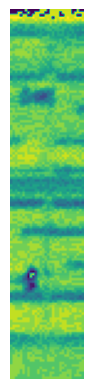

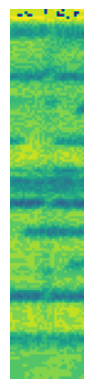

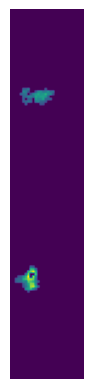

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

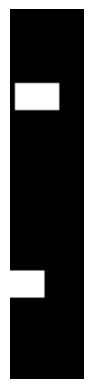

[[ 10.5  35. ]
 [  6.5 111. ]]


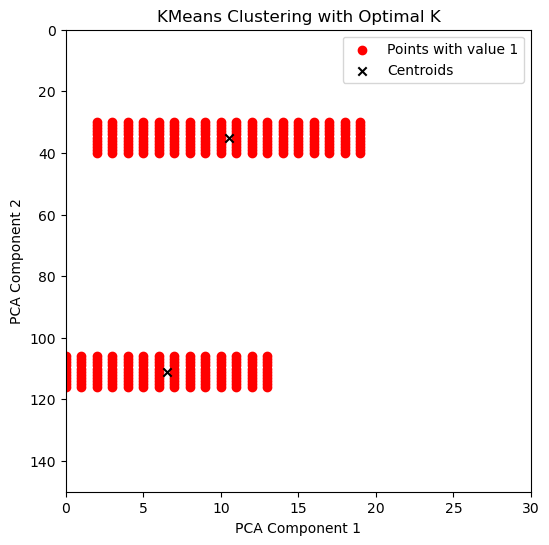

Coordinates of cluster centers:
Cluster 1: (10.5, 35.0)
Cluster 2: (6.5, 111.0)
seen: 2
checking image number: 83


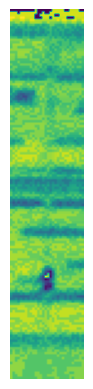

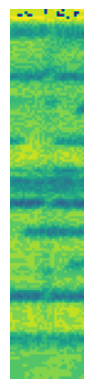

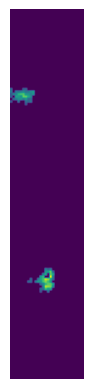

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

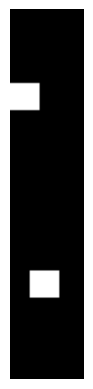

[[  5.5  35. ]
 [ 13.5 111. ]]


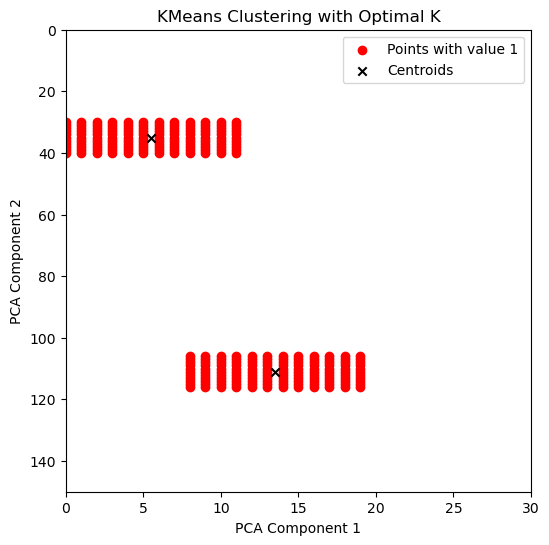

Coordinates of cluster centers:
Cluster 1: (5.5, 35.0)
Cluster 2: (13.5, 111.0)
seen: 2
checking image number: 84


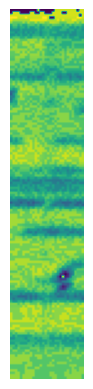

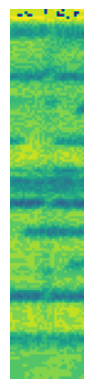

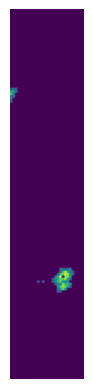

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

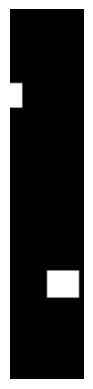

[[  2.   34.5]
 [ 21.  111. ]]


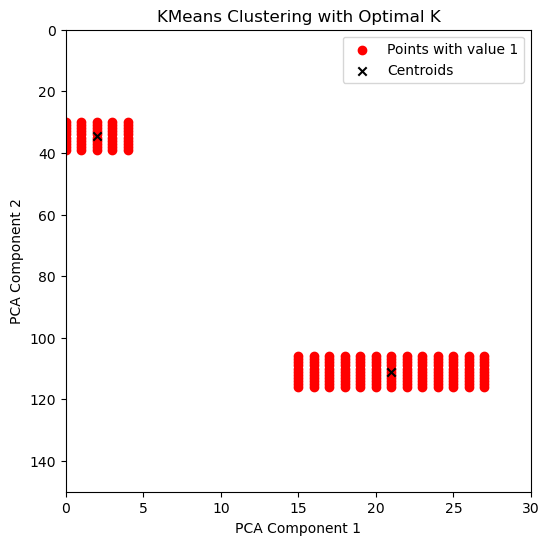

Coordinates of cluster centers:
Cluster 1: (2.0, 34.5)
Cluster 2: (21.0, 111.0)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 11.
checking image number: 85


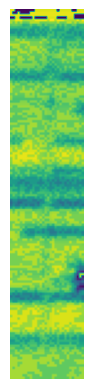

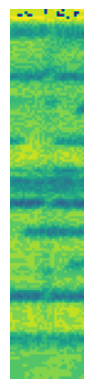

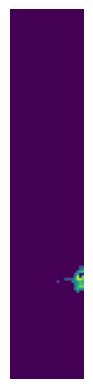

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


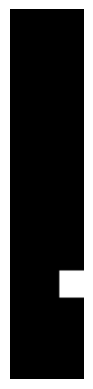

[[ 24.5 111. ]]


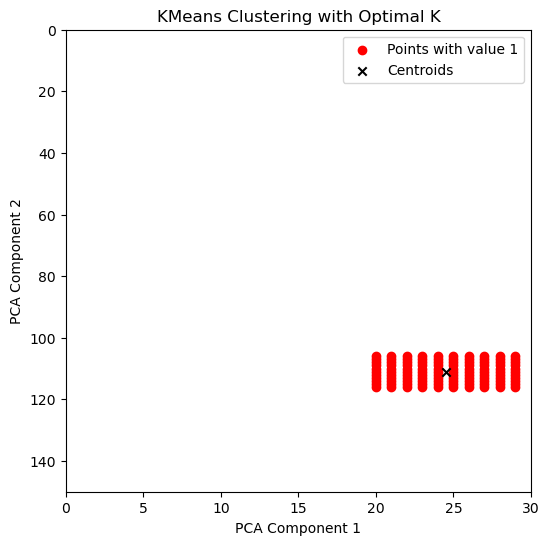

Coordinates of cluster centers:
Cluster 1: (24.5, 111.0)
seen: 1
checking image number: 86


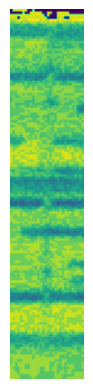

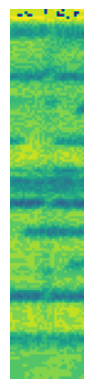

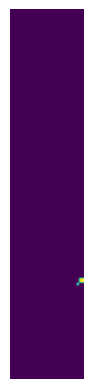

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


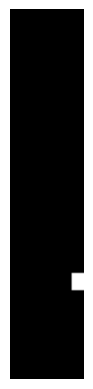

[[ 27. 110.]]


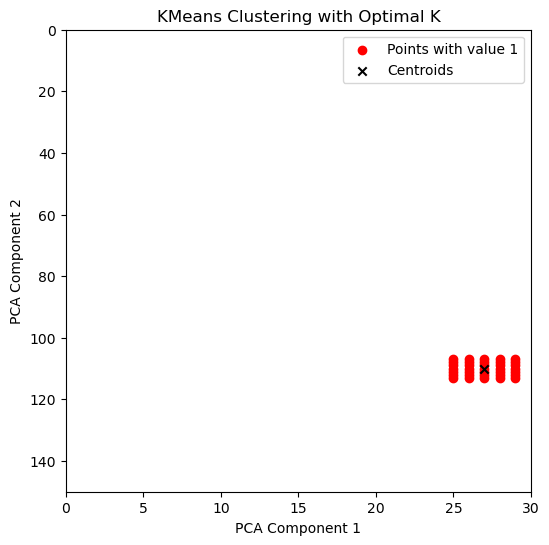

Coordinates of cluster centers:
Cluster 1: (27.0, 110.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 12.
checking image number: 87


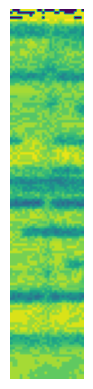

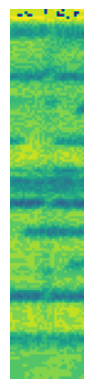

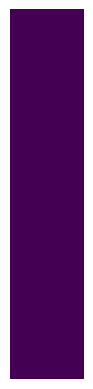

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


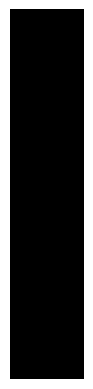

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 88


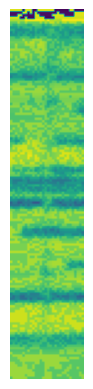

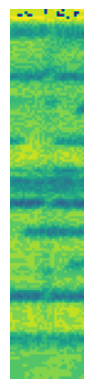

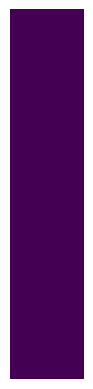

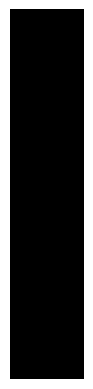

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 89


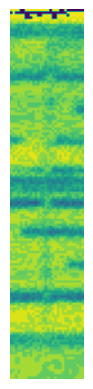

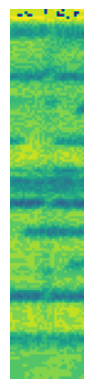

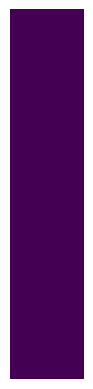

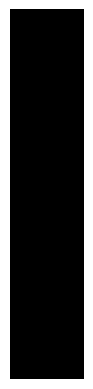

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 90


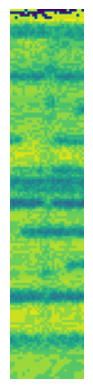

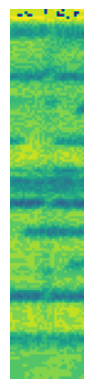

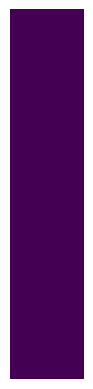

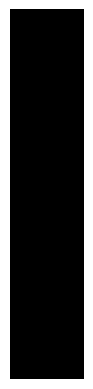

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 91


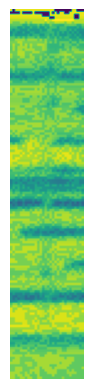

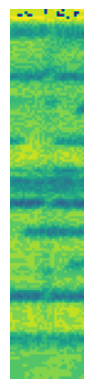

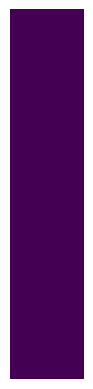

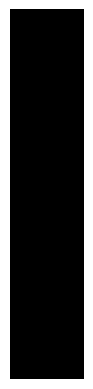

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 92


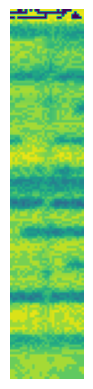

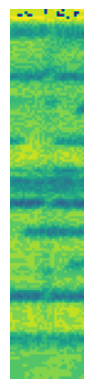

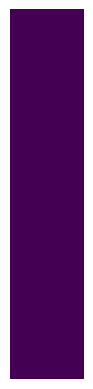

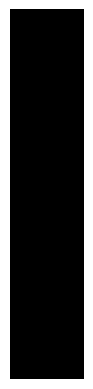

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 93


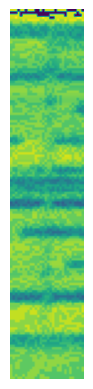

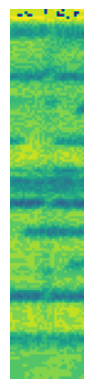

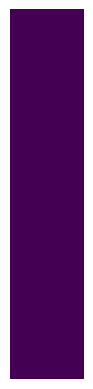

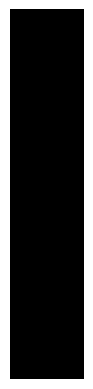

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 94


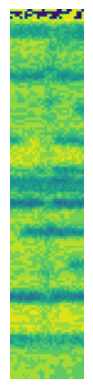

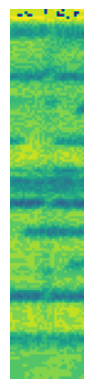

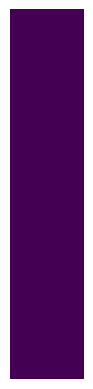

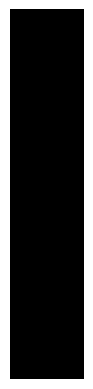

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 95


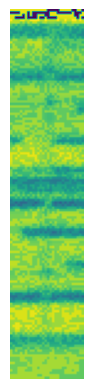

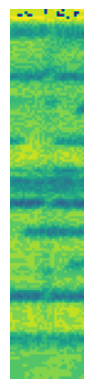

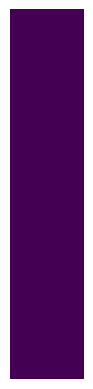

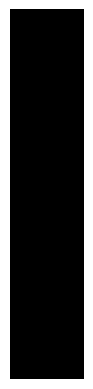

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 96


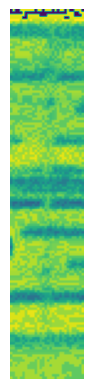

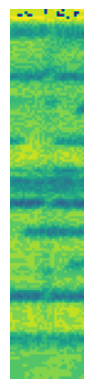

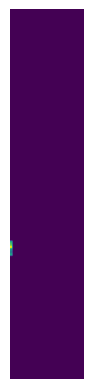

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


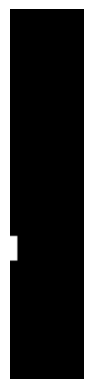

[[ 1.  96.5]]


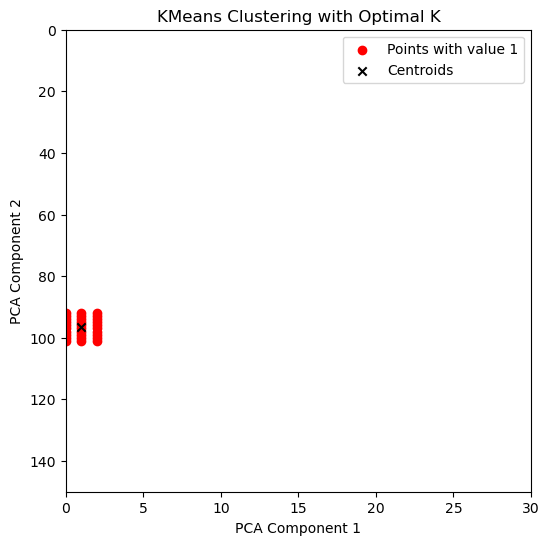

Coordinates of cluster centers:
Cluster 1: (1.0, 96.5)
seen: 1
checking image number: 97


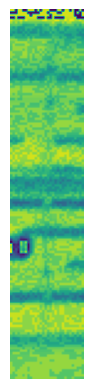

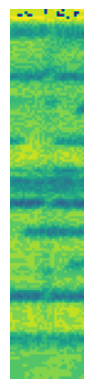

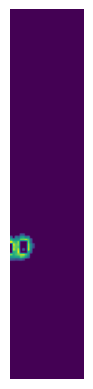

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


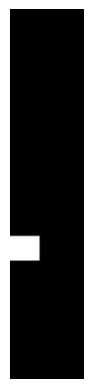

[[ 5.5 96.5]]


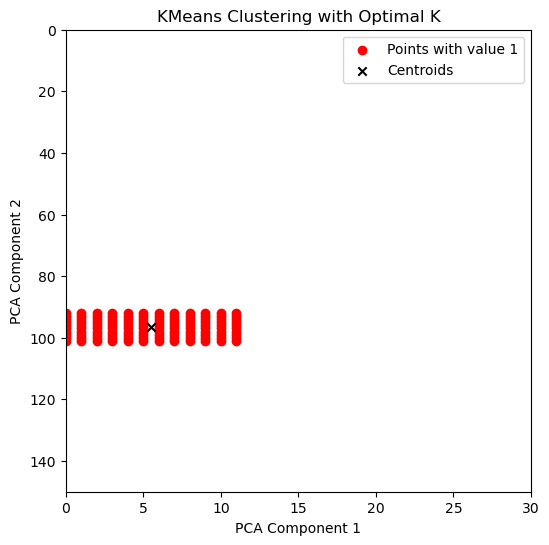

Coordinates of cluster centers:
Cluster 1: (5.5, 96.5)
seen: 1
checking image number: 98


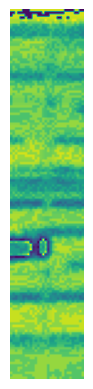

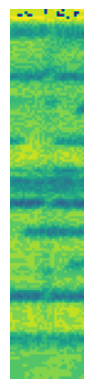

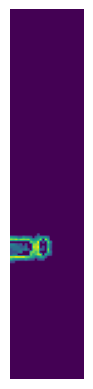

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


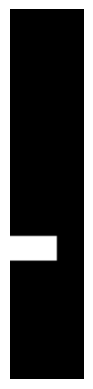

[[ 9.  96.5]]


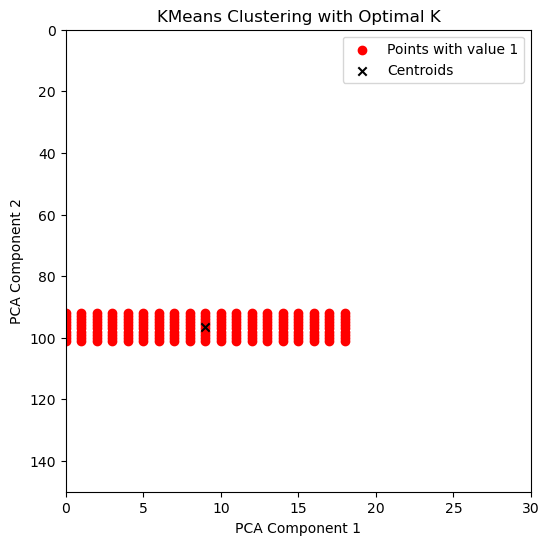

Coordinates of cluster centers:
Cluster 1: (9.0, 96.5)
seen: 1
checking image number: 99


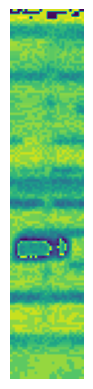

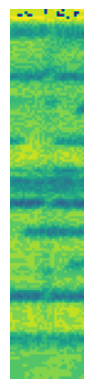

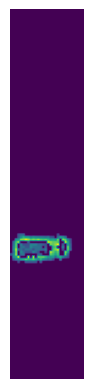

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


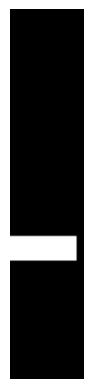

[[13.  96.5]]


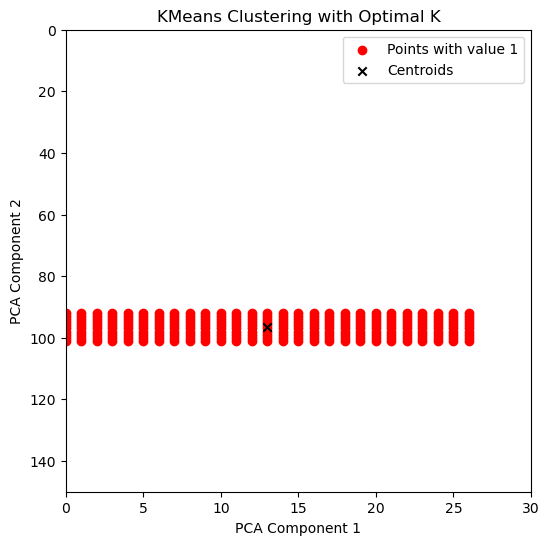

Coordinates of cluster centers:
Cluster 1: (13.0, 96.5)
seen: 1
checking image number: 100


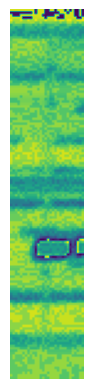

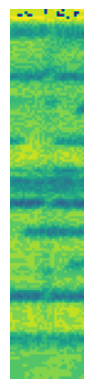

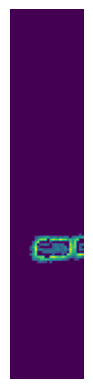

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


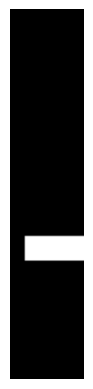

[[17.5 96.5]]


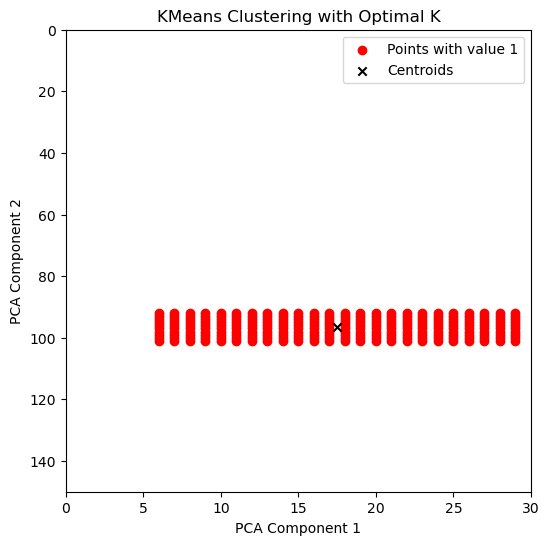

Coordinates of cluster centers:
Cluster 1: (17.5, 96.5)
seen: 1
checking image number: 101


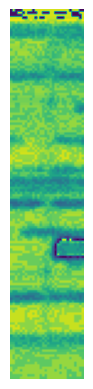

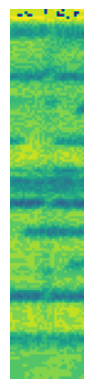

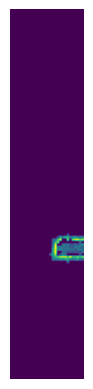

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


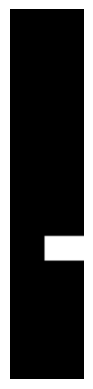

[[21.5 96.5]]


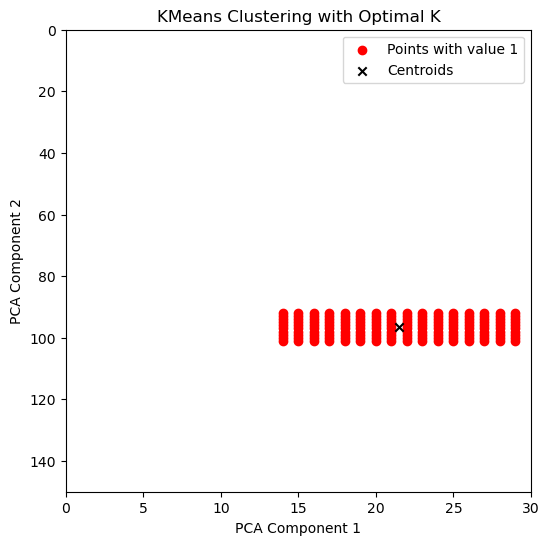

Coordinates of cluster centers:
Cluster 1: (21.5, 96.5)
seen: 1
checking image number: 102


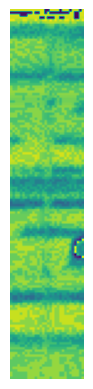

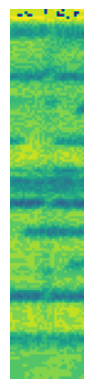

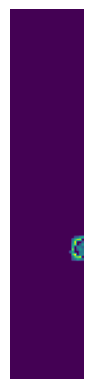

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


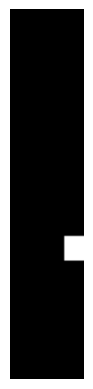

[[25.5 96.5]]


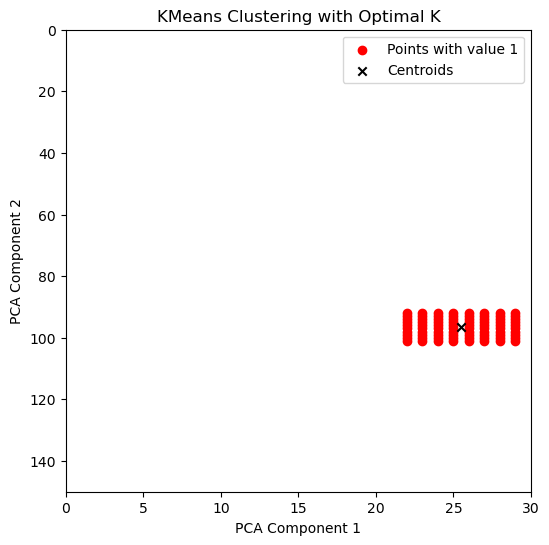

Coordinates of cluster centers:
Cluster 1: (25.5, 96.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 13.
checking image number: 103


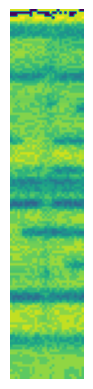

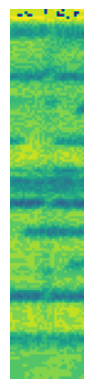

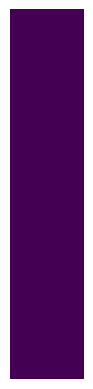

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


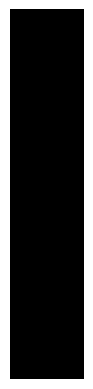

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 104


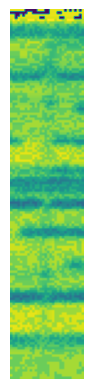

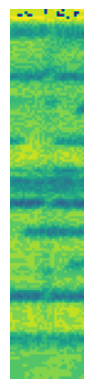

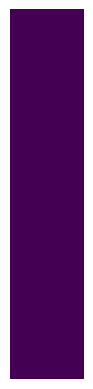

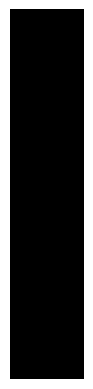

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 105


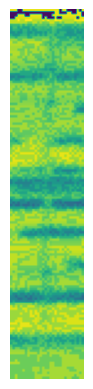

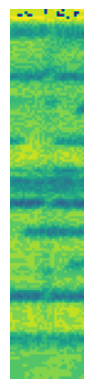

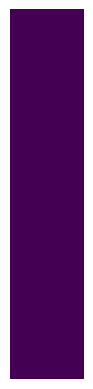

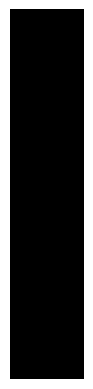

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 106


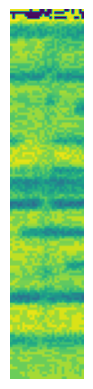

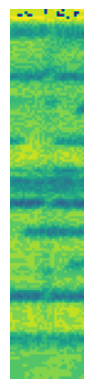

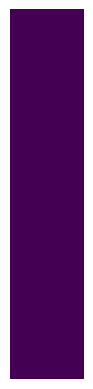

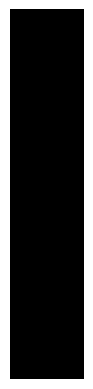

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 107


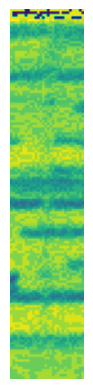

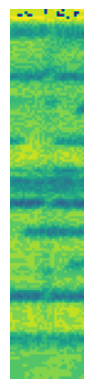

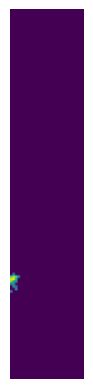

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


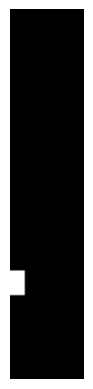

[[  2.5 110.5]]


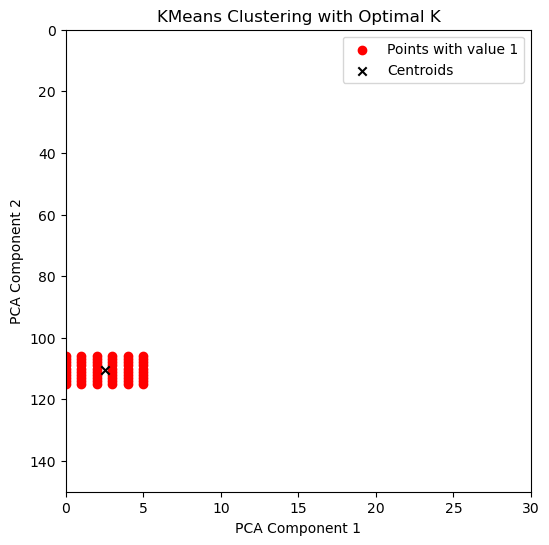

Coordinates of cluster centers:
Cluster 1: (2.5, 110.5)
seen: 1
checking image number: 108


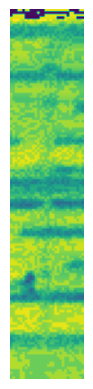

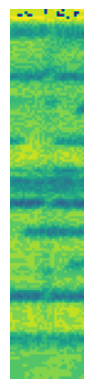

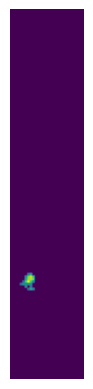

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


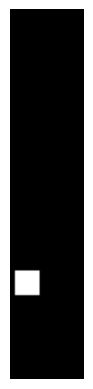

[[  6.5 110.5]]


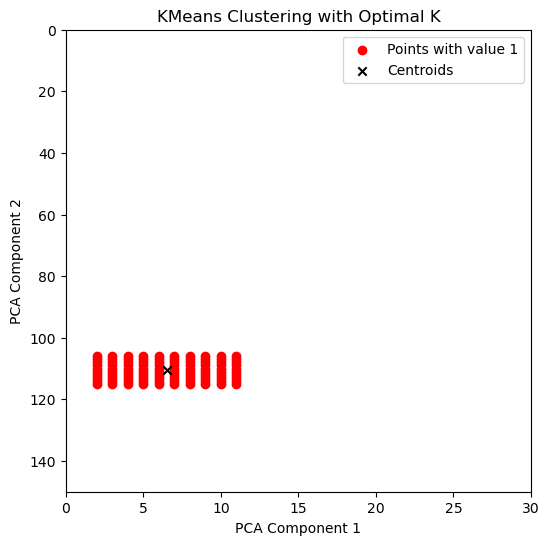

Coordinates of cluster centers:
Cluster 1: (6.5, 110.5)
seen: 1
checking image number: 109


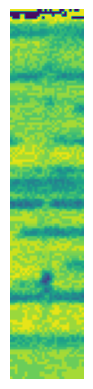

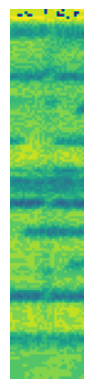

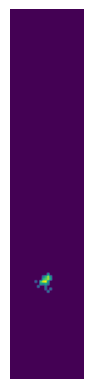

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


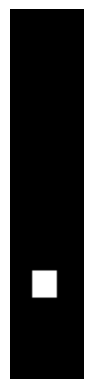

[[ 13.5 111. ]]


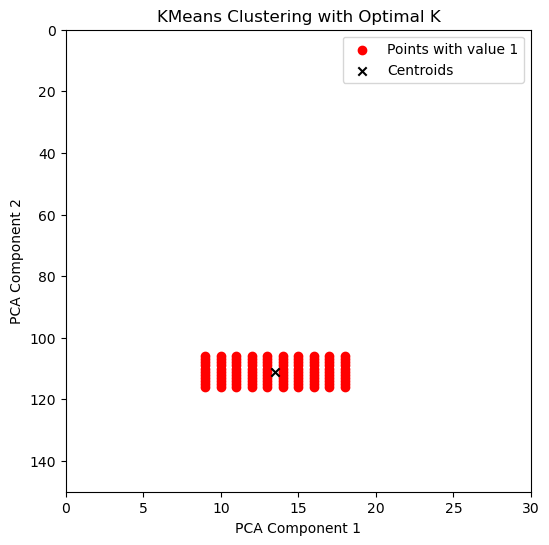

Coordinates of cluster centers:
Cluster 1: (13.5, 111.0)
seen: 1
checking image number: 110


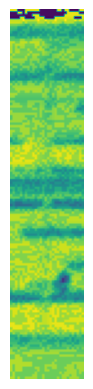

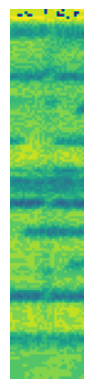

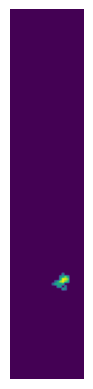

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


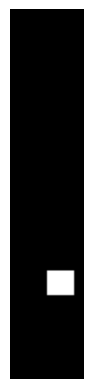

[[ 20.  110.5]]


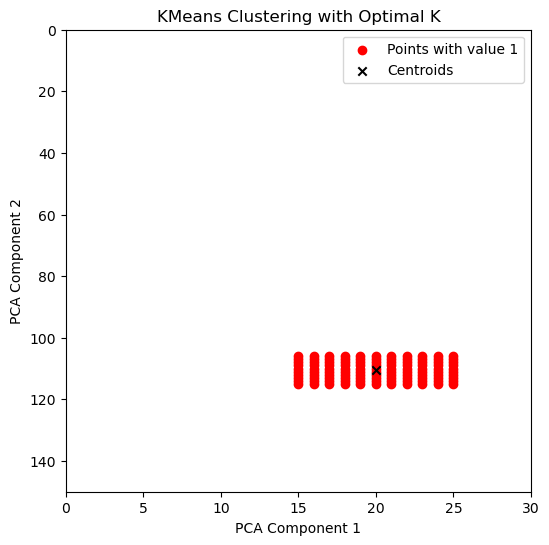

Coordinates of cluster centers:
Cluster 1: (20.0, 110.5)
seen: 1
checking image number: 111


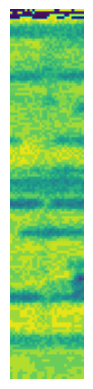

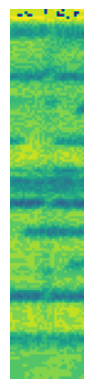

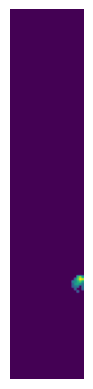

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


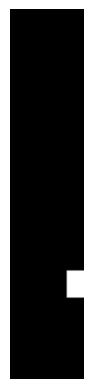

[[ 26. 111.]]


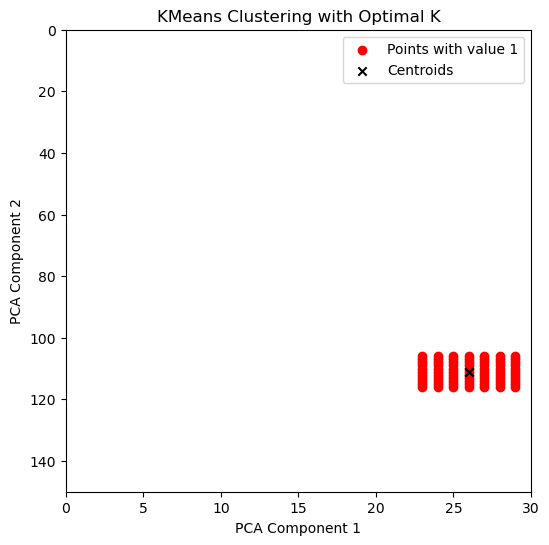

Coordinates of cluster centers:
Cluster 1: (26.0, 111.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 14.
checking image number: 112


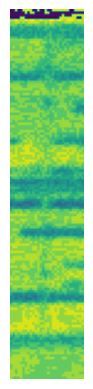

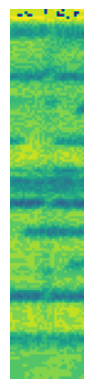

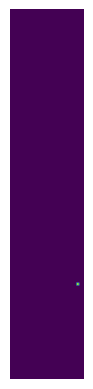

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


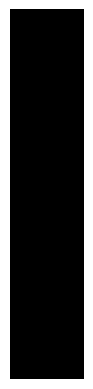

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 113


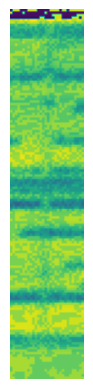

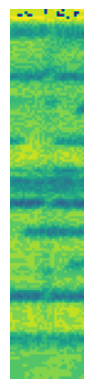

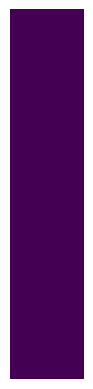

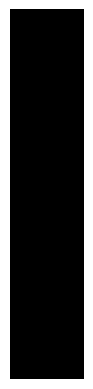

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 114


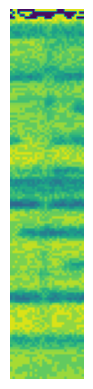

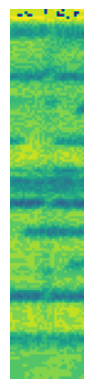

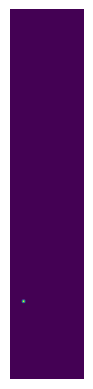

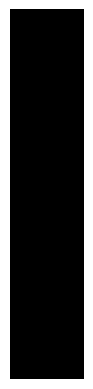

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 115


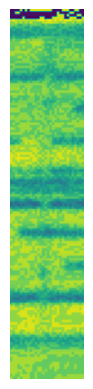

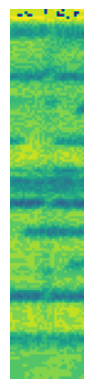

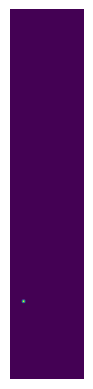

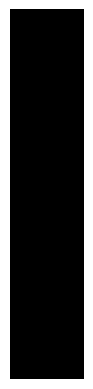

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 116


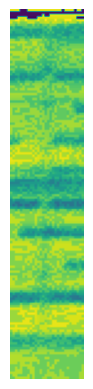

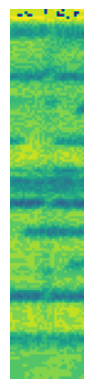

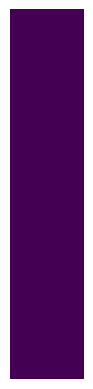

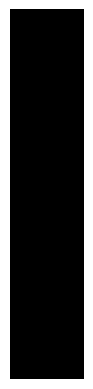

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 117


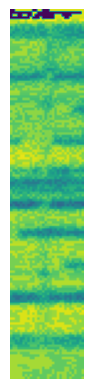

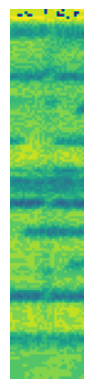

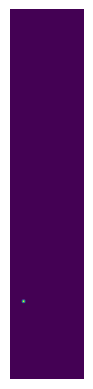

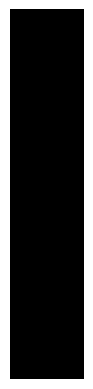

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 118


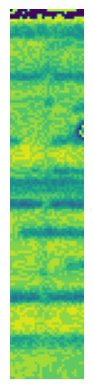

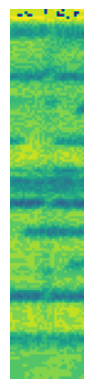

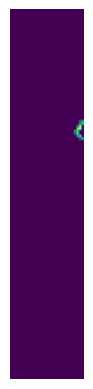

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


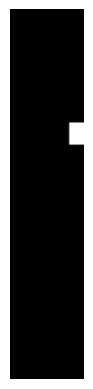

[[26.5 50. ]]


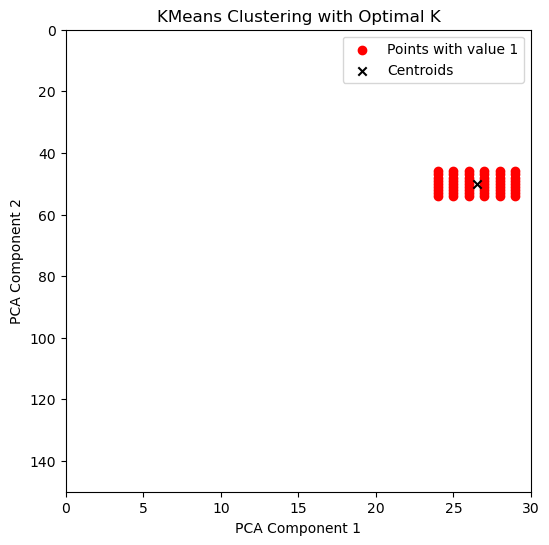

Coordinates of cluster centers:
Cluster 1: (26.5, 50.0)
seen: 1
checking image number: 119


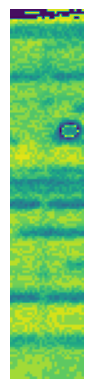

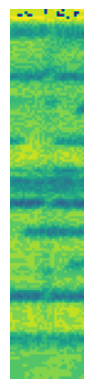

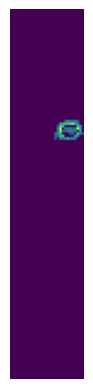

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


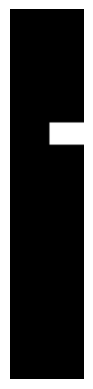

[[22.5 50. ]]


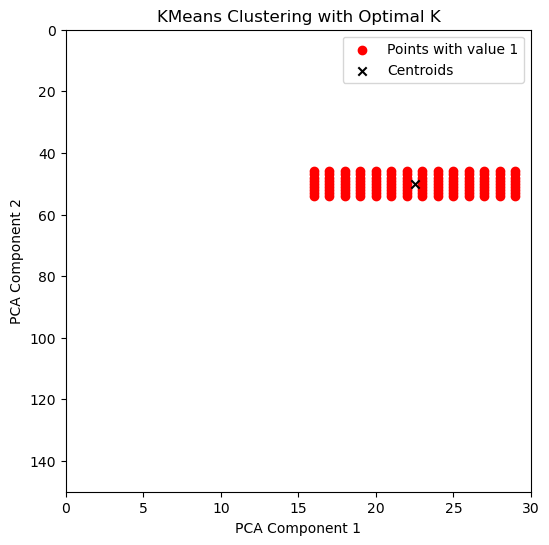

Coordinates of cluster centers:
Cluster 1: (22.5, 50.0)
seen: 1
checking image number: 120


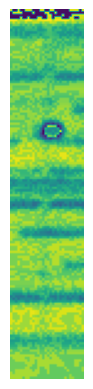

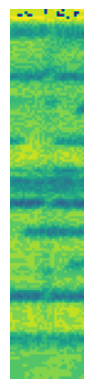

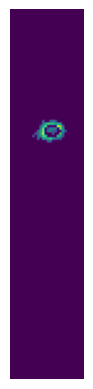

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


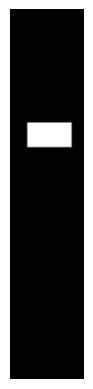

[[15.5 50.5]]


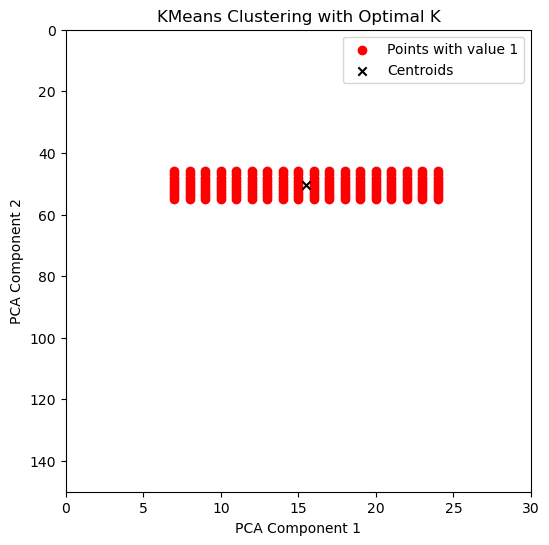

Coordinates of cluster centers:
Cluster 1: (15.5, 50.5)
seen: 1
checking image number: 121


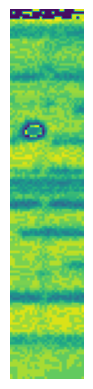

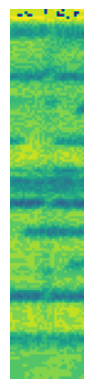

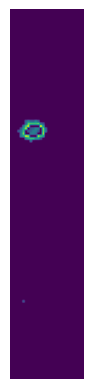

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


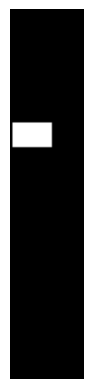

[[ 8.5 50.5]]


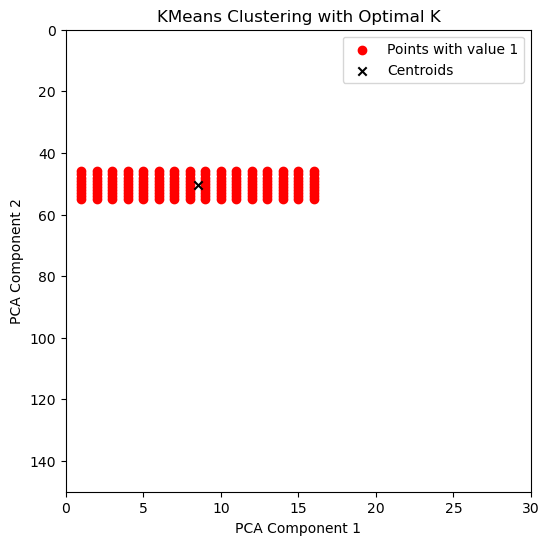

Coordinates of cluster centers:
Cluster 1: (8.5, 50.5)
seen: 1
checking image number: 122


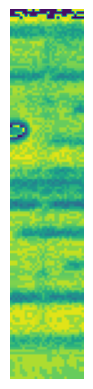

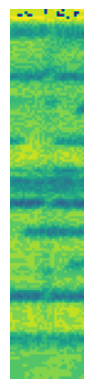

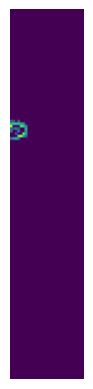

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


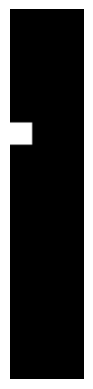

[[ 4. 50.]]


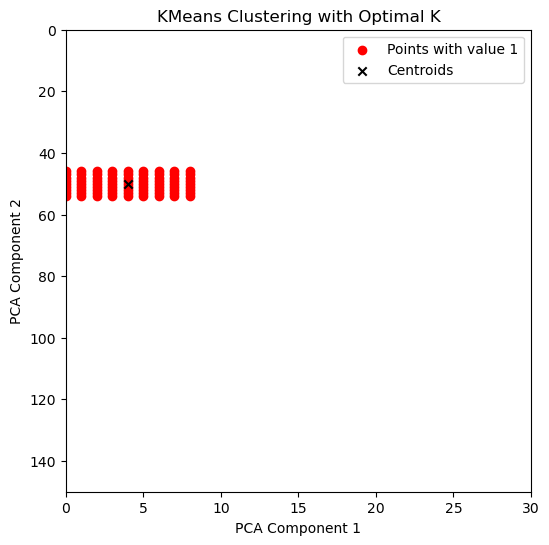

Coordinates of cluster centers:
Cluster 1: (4.0, 50.0)
seen: 1
checking image number: 123


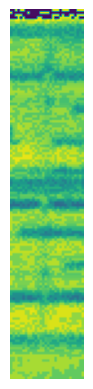

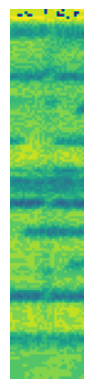

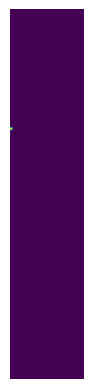

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


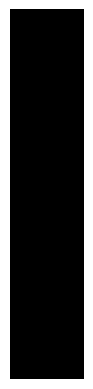

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 124


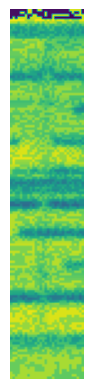

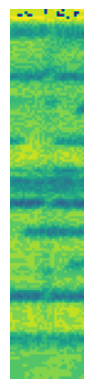

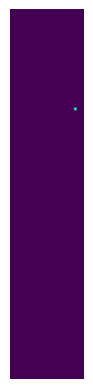

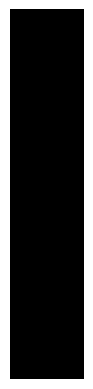

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 125


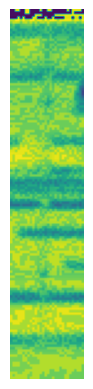

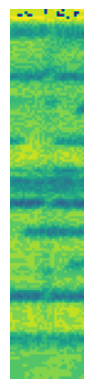

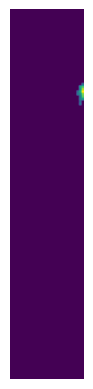

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


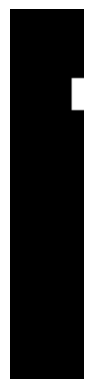

[[27. 34.]]


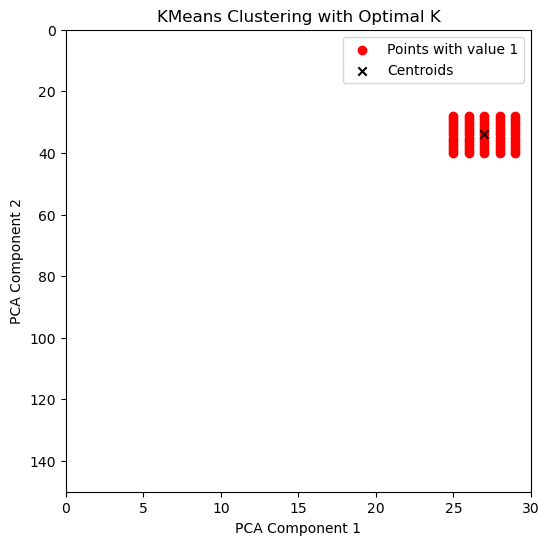

Coordinates of cluster centers:
Cluster 1: (27.0, 34.0)
seen: 1
checking image number: 126


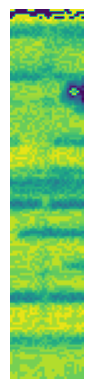

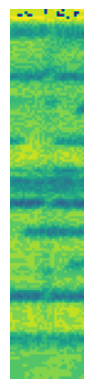

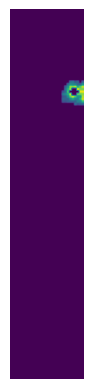

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


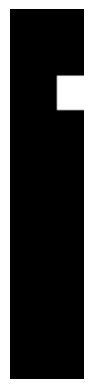

[[24.  33.5]]


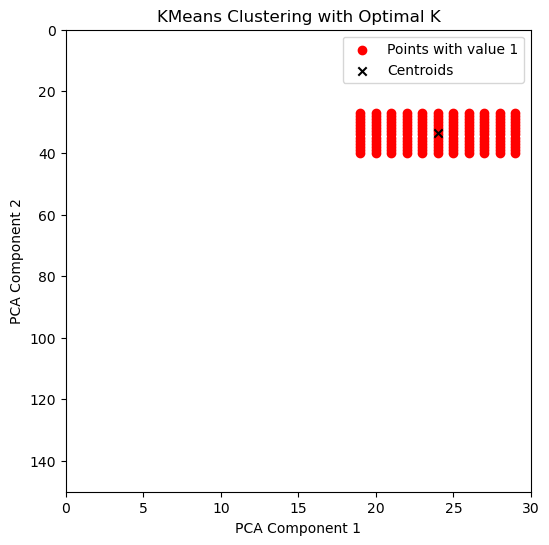

Coordinates of cluster centers:
Cluster 1: (24.0, 33.5)
seen: 1
checking image number: 127


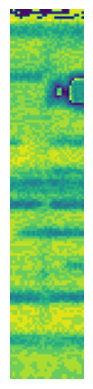

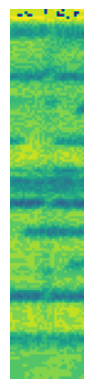

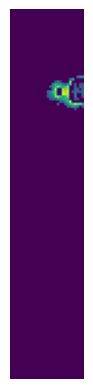

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

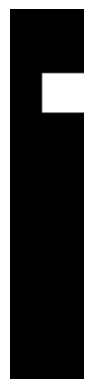

[[21.  33.5]]


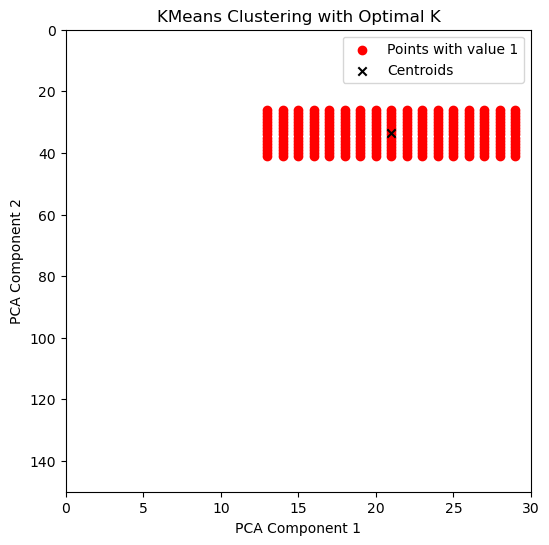

Coordinates of cluster centers:
Cluster 1: (21.0, 33.5)
seen: 1
checking image number: 128


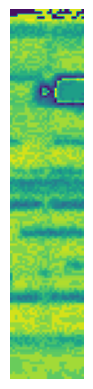

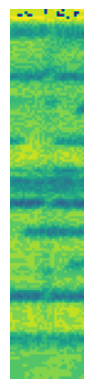

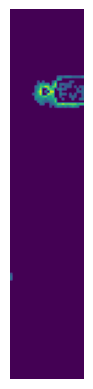

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


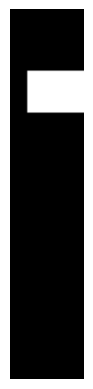

[[18. 33.]]


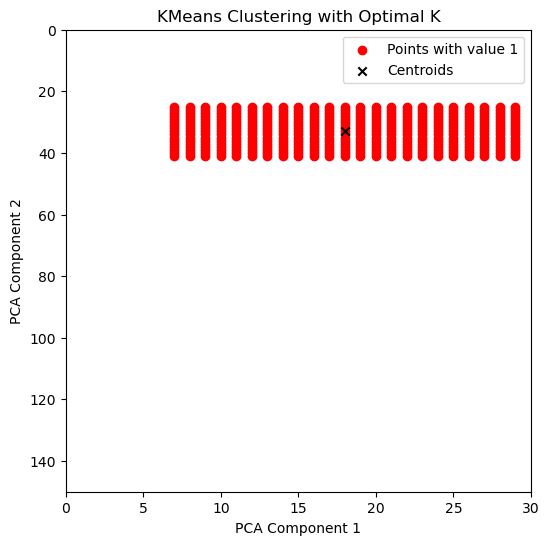

Coordinates of cluster centers:
Cluster 1: (18.0, 33.0)
seen: 1
checking image number: 129


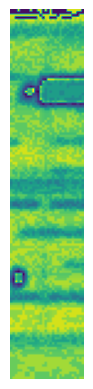

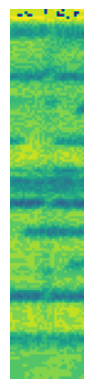

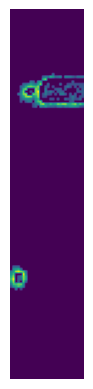

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

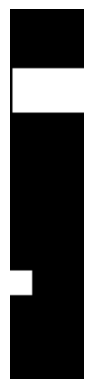

[[ 15.   32.5]
 [  4.  110.5]]


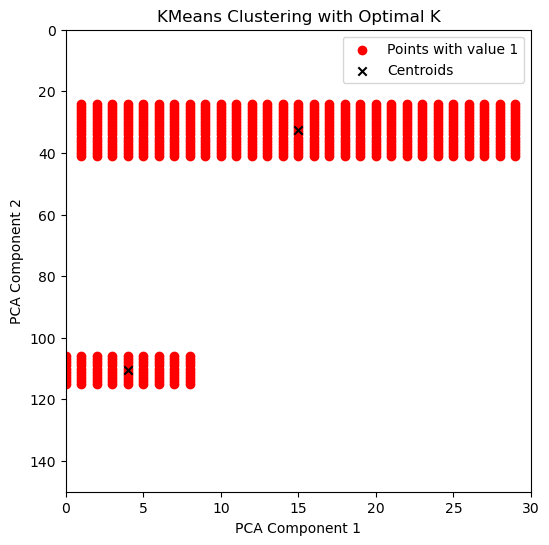

Coordinates of cluster centers:
Cluster 1: (15.0, 32.5)
Cluster 2: (4.0, 110.5)
seen: 2
checking image number: 130


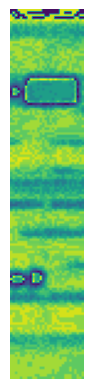

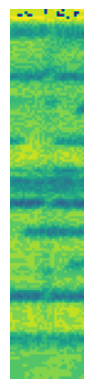

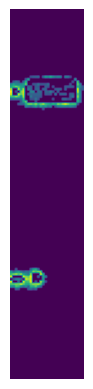

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

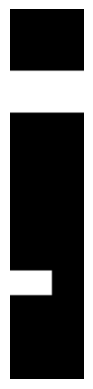

[[ 14.5  33. ]
 [  8.  110.5]]


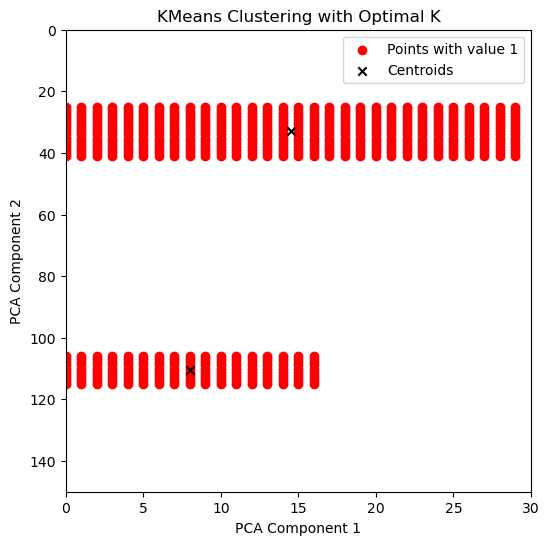

Coordinates of cluster centers:
Cluster 1: (14.5, 33.0)
Cluster 2: (8.0, 110.5)
seen: 2
checking image number: 131


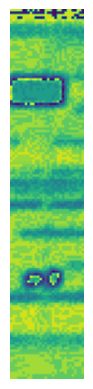

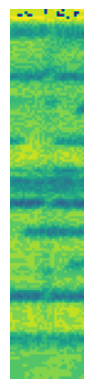

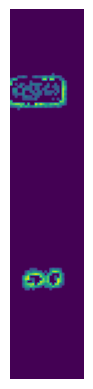

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

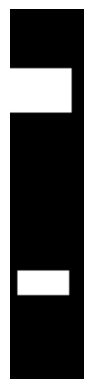

[[ 12.   32.5]
 [ 13.  110.5]]


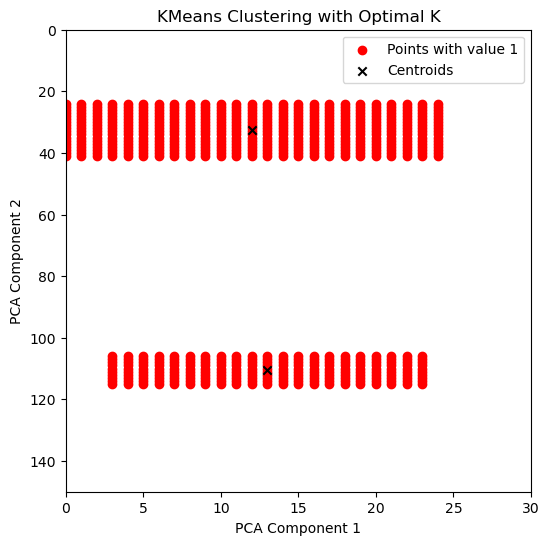

Coordinates of cluster centers:
Cluster 1: (12.0, 32.5)
Cluster 2: (13.0, 110.5)
seen: 2
checking image number: 132


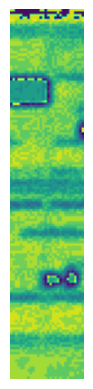

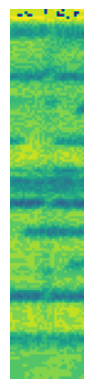

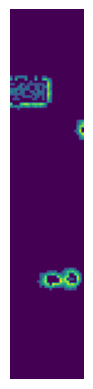

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

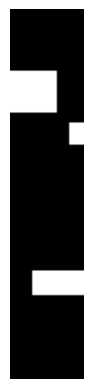

[[  9.   33. ]
 [ 26.5  50. ]
 [ 19.  110.5]]


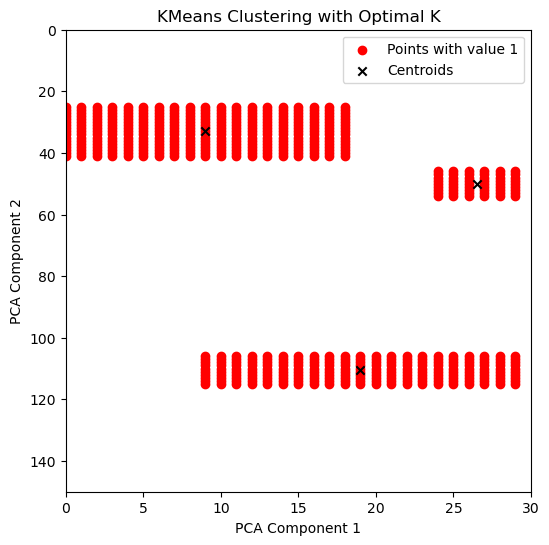

Coordinates of cluster centers:
Cluster 1: (9.0, 33.0)
Cluster 2: (26.5, 50.0)
Cluster 3: (19.0, 110.5)
seen: 3
checking image number: 133


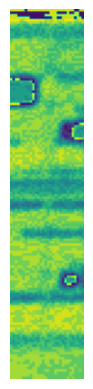

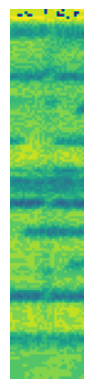

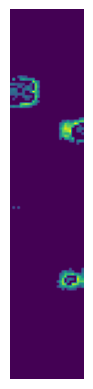

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

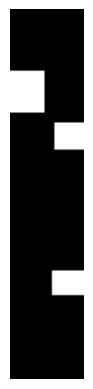

[[  6.5  33. ]
 [ 23.5  51. ]
 [ 23.  110.5]]


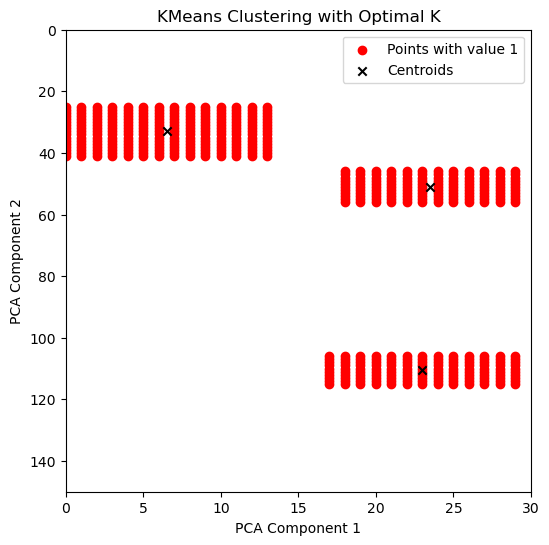

Coordinates of cluster centers:
Cluster 1: (6.5, 33.0)
Cluster 2: (23.5, 51.0)
Cluster 3: (23.0, 110.5)
seen: 3
checking image number: 134


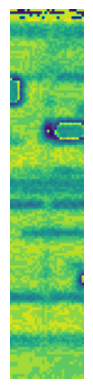

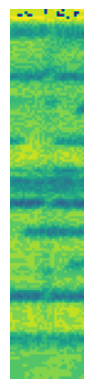

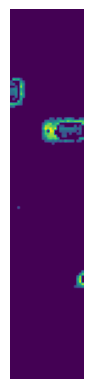

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

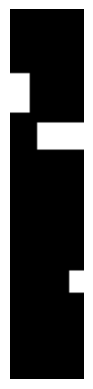

[[  3.5  33.5]
 [ 20.   51. ]
 [ 26.5 110. ]]


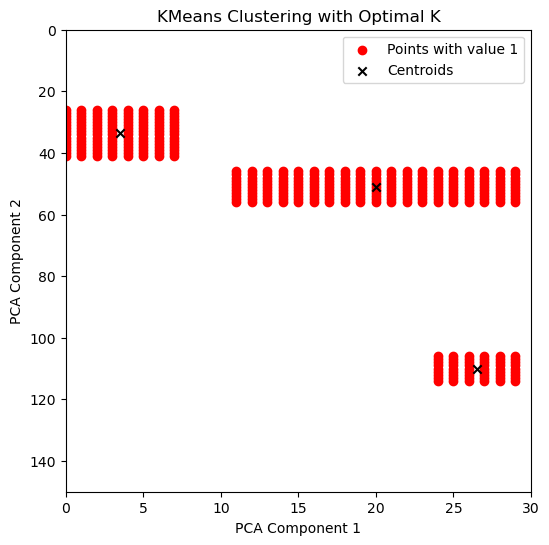

Coordinates of cluster centers:
Cluster 1: (3.5, 33.5)
Cluster 2: (20.0, 51.0)
Cluster 3: (26.5, 110.0)
seen: 3
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 2.
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 15.
checking image number: 135


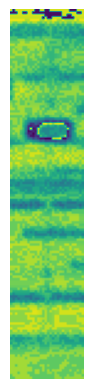

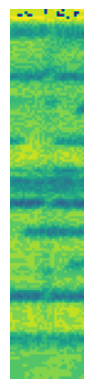

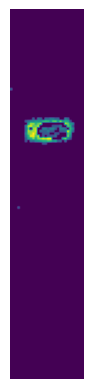

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


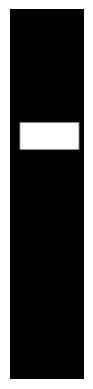

[[15.5 51. ]]


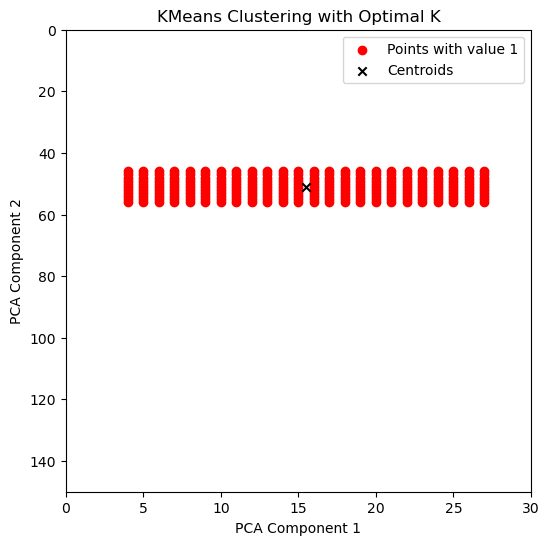

Coordinates of cluster centers:
Cluster 1: (15.5, 51.0)
seen: 1
checking image number: 136


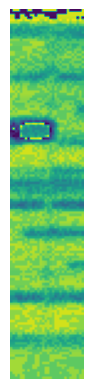

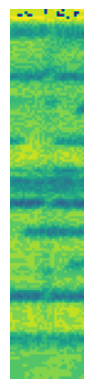

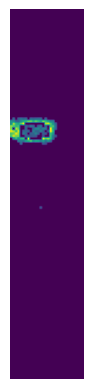

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


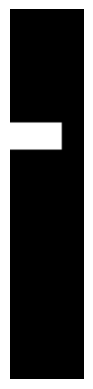

[[10. 51.]]


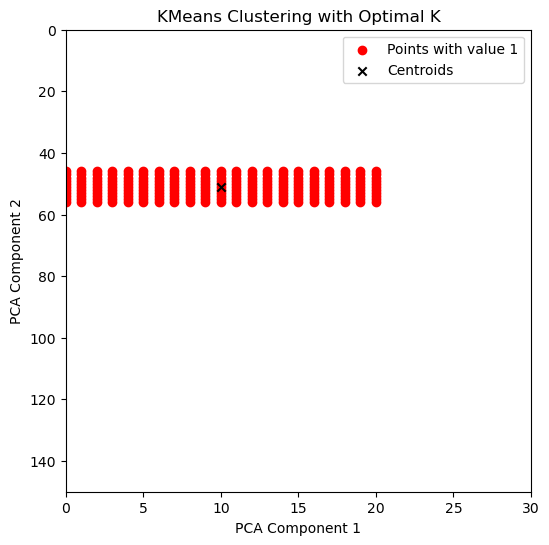

Coordinates of cluster centers:
Cluster 1: (10.0, 51.0)
seen: 1
checking image number: 137


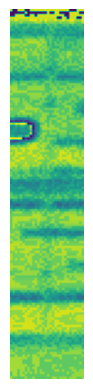

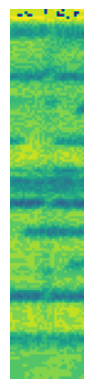

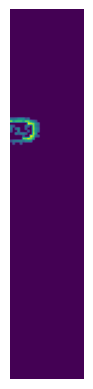

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


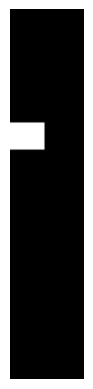

[[ 6.5 51. ]]


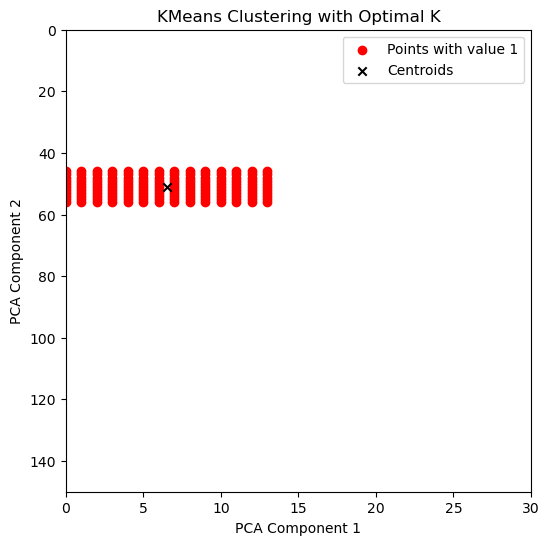

Coordinates of cluster centers:
Cluster 1: (6.5, 51.0)
seen: 1
checking image number: 138


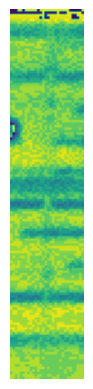

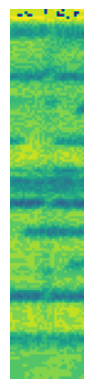

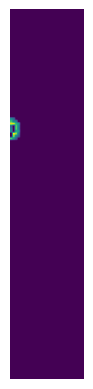

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


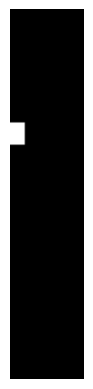

[[ 2.5 50. ]]


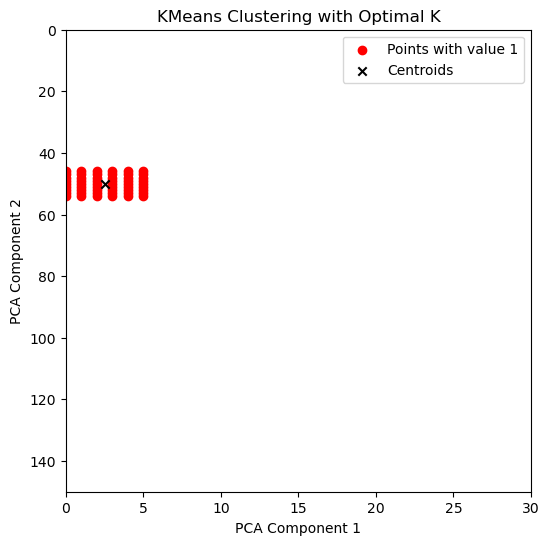

Coordinates of cluster centers:
Cluster 1: (2.5, 50.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 3.
checking image number: 139


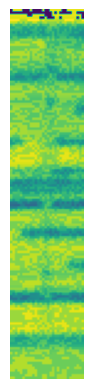

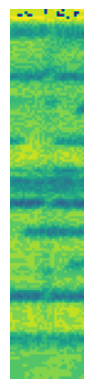

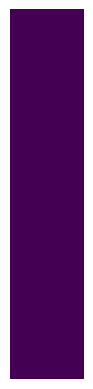

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


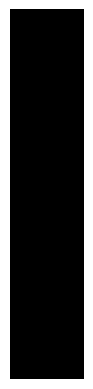

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 140


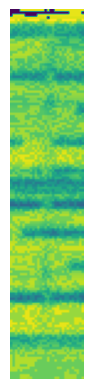

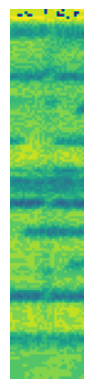

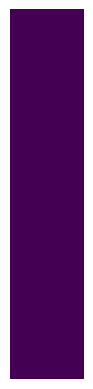

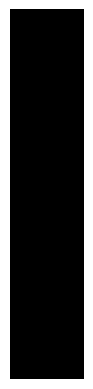

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 141


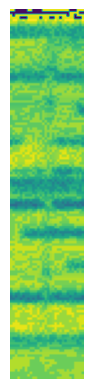

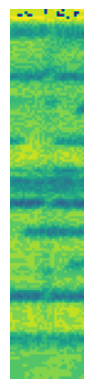

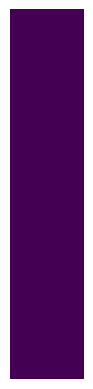

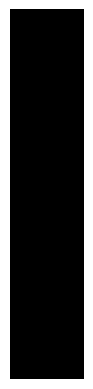

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 142


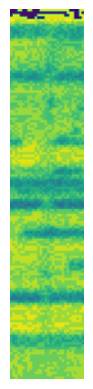

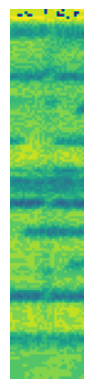

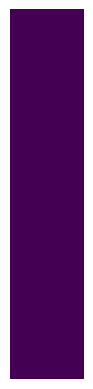

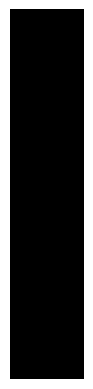

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 143


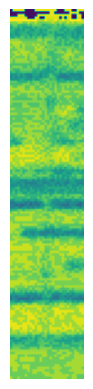

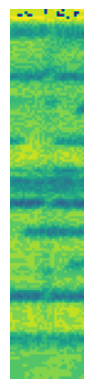

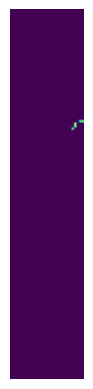

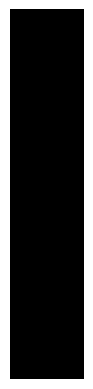

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 144


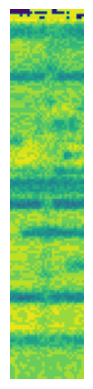

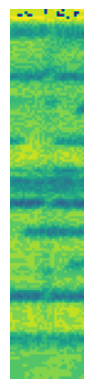

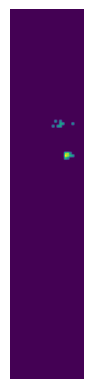

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows wi

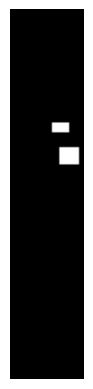

[[20.  47.5]
 [23.5 59. ]]


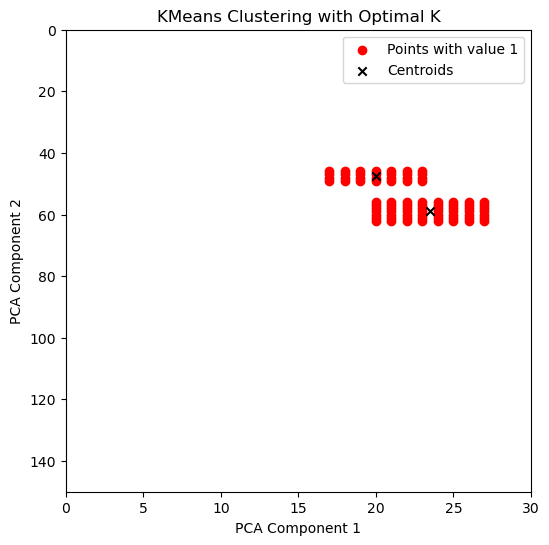

Coordinates of cluster centers:
Cluster 1: (20.0, 47.5)
Cluster 2: (23.5, 59.0)
seen: 2
checking image number: 145


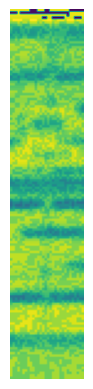

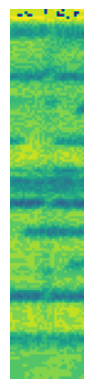

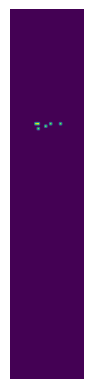

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


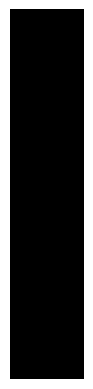

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 146


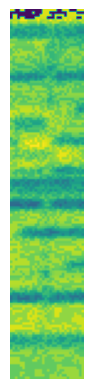

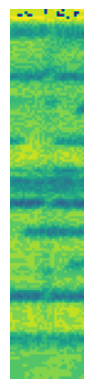

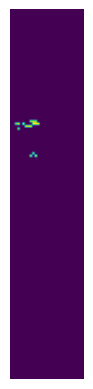

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


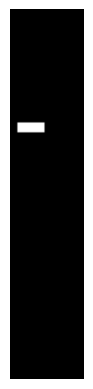

[[ 8.  47.5]]


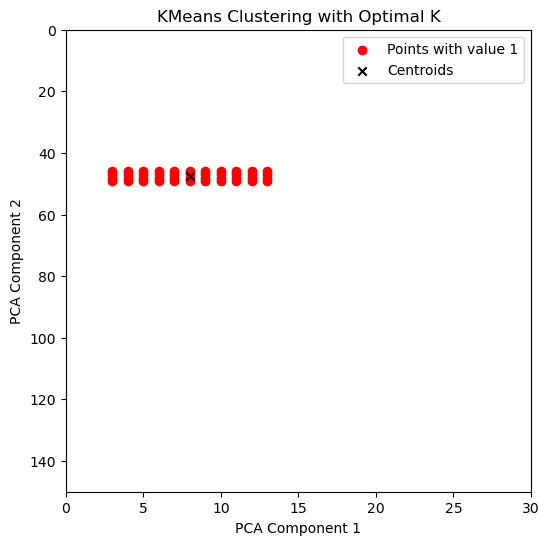

Coordinates of cluster centers:
Cluster 1: (8.0, 47.5)
seen: 1
checking image number: 147


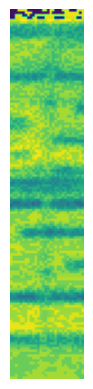

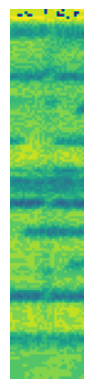

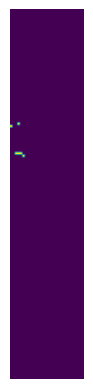

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


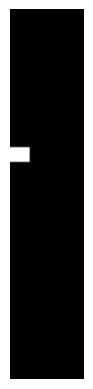

[[ 3.5 58.5]]


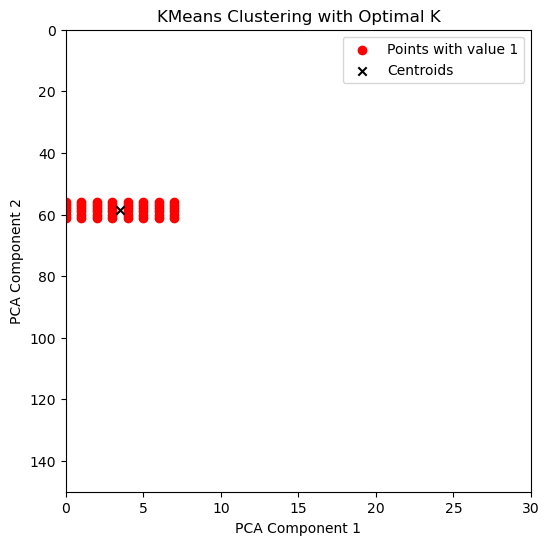

Coordinates of cluster centers:
Cluster 1: (3.5, 58.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 16.
checking image number: 148


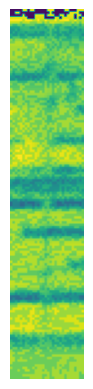

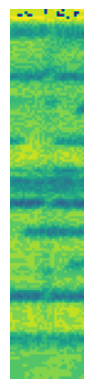

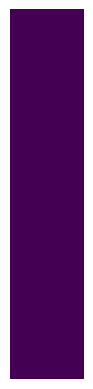

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


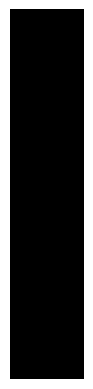

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 149


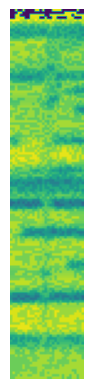

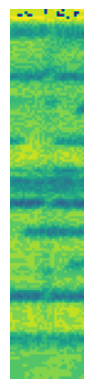

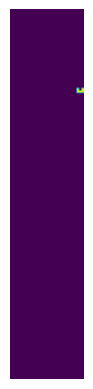

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


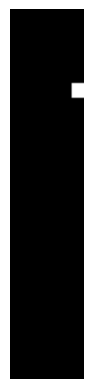

[[27.  32.5]]


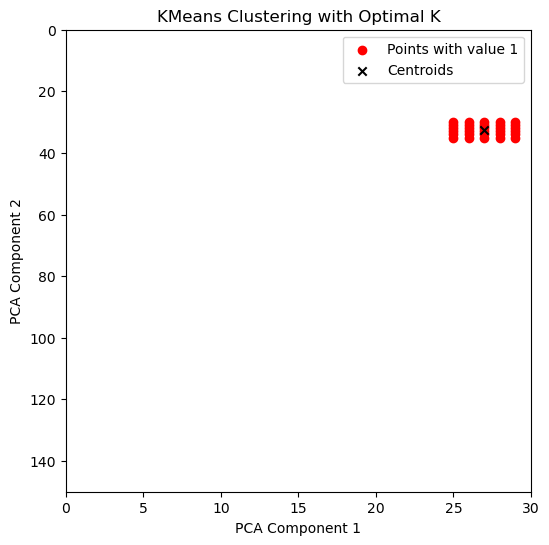

Coordinates of cluster centers:
Cluster 1: (27.0, 32.5)
seen: 1
checking image number: 150


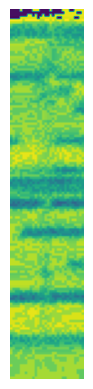

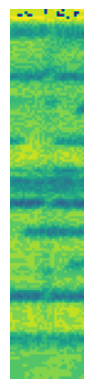

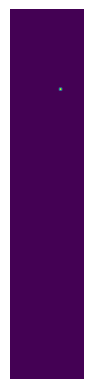

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


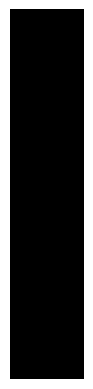

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 151


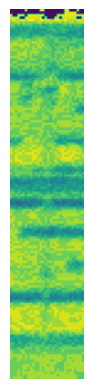

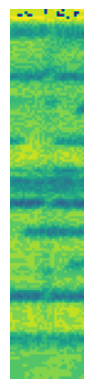

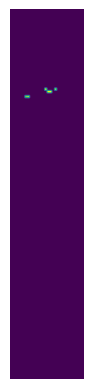

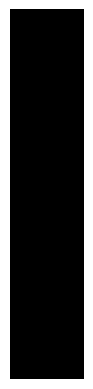

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 152


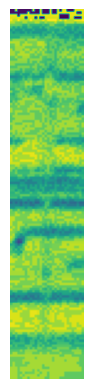

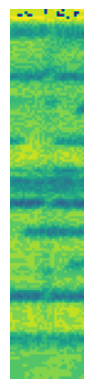

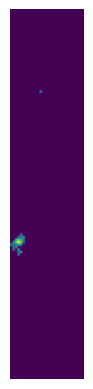

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


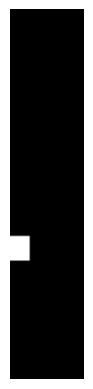

[[ 3.5 96.5]]


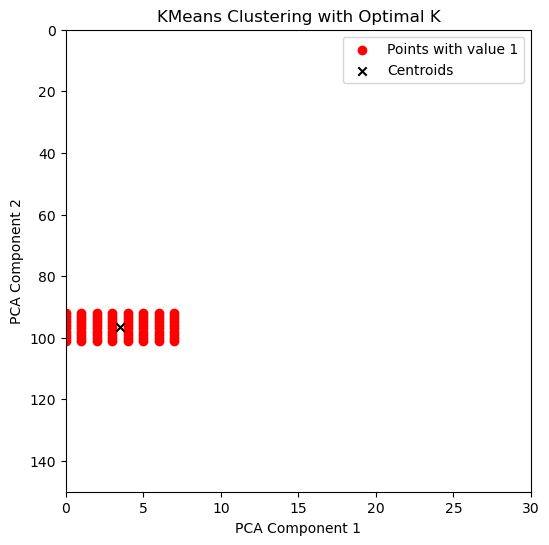

Coordinates of cluster centers:
Cluster 1: (3.5, 96.5)
seen: 1
checking image number: 153


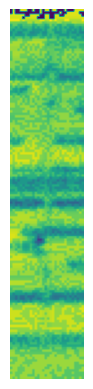

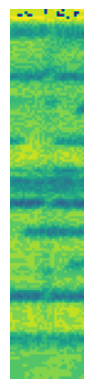

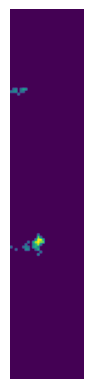

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

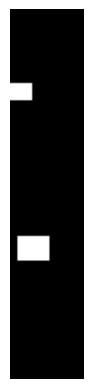

[[ 4.  33. ]
 [ 9.  96.5]]


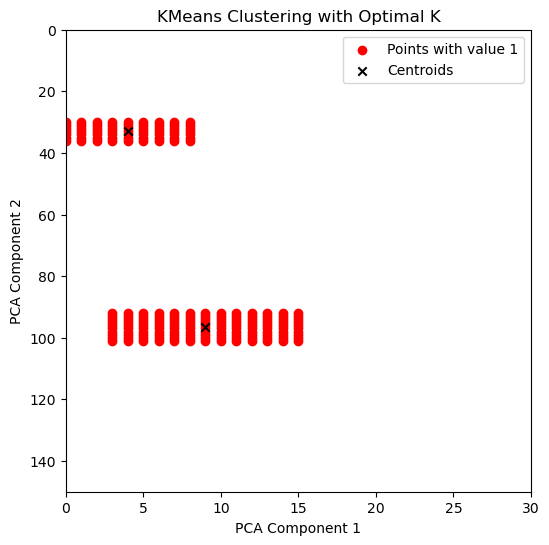

Coordinates of cluster centers:
Cluster 1: (4.0, 33.0)
Cluster 2: (9.0, 96.5)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 17.
checking image number: 154


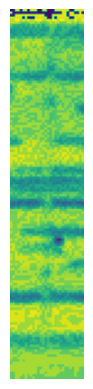

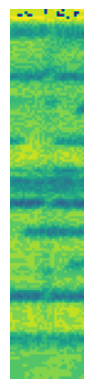

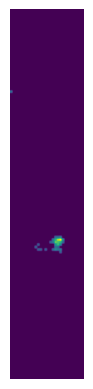

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

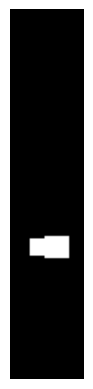

[[15.95454545 96.        ]]


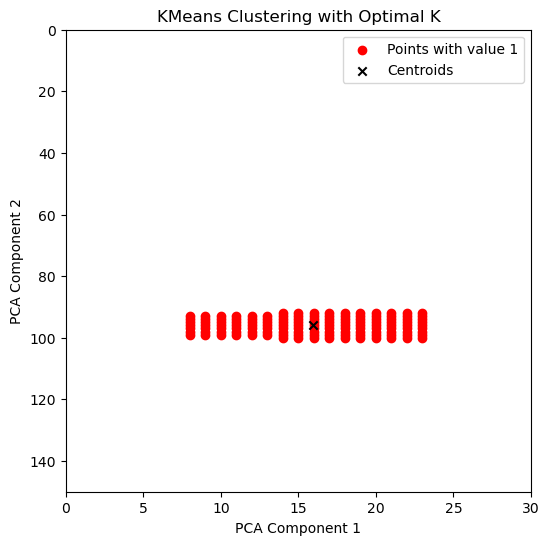

Coordinates of cluster centers:
Cluster 1: (15.954545454545455, 96.0)
seen: 1
checking image number: 155


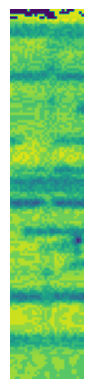

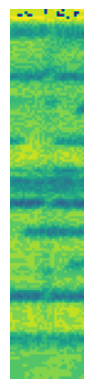

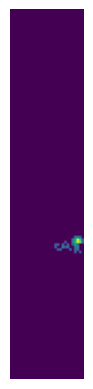

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

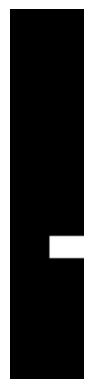

[[22.5 96. ]]


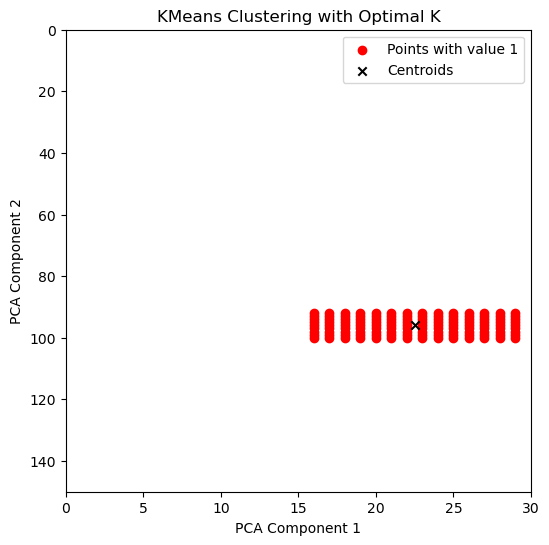

Coordinates of cluster centers:
Cluster 1: (22.5, 96.0)
seen: 1
checking image number: 156


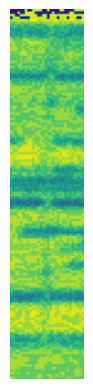

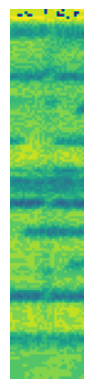

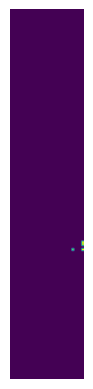

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


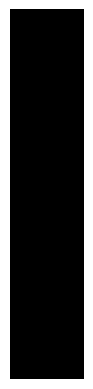

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 157


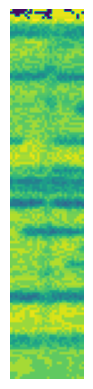

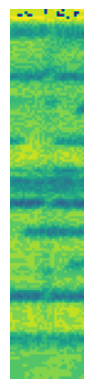

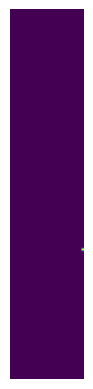

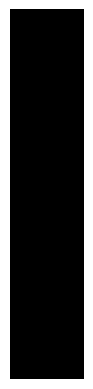

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 158


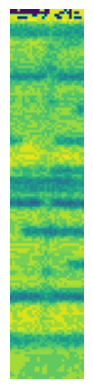

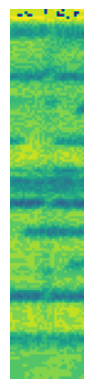

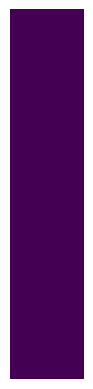

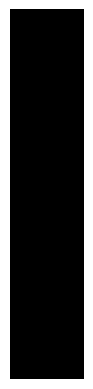

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 159


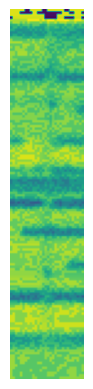

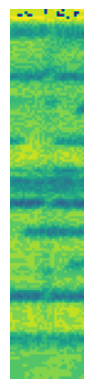

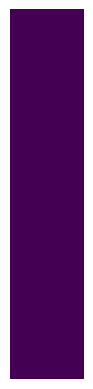

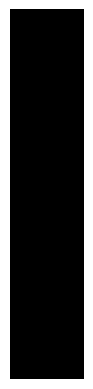

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 160


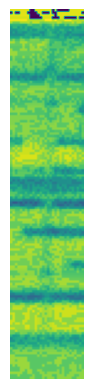

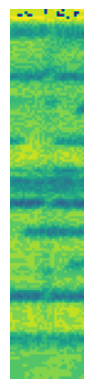

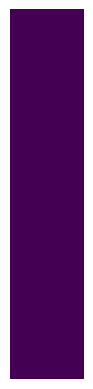

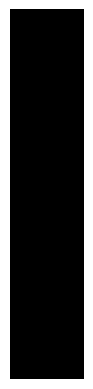

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 161


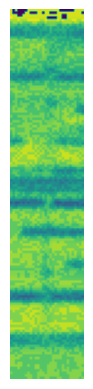

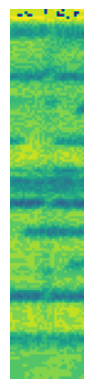

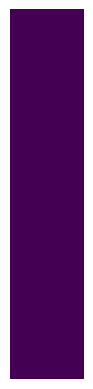

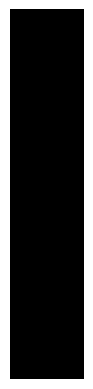

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 162


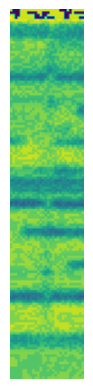

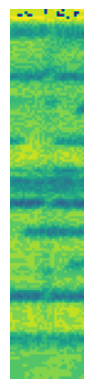

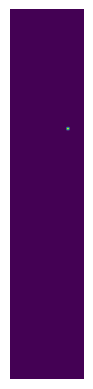

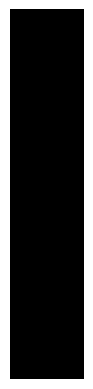

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 163


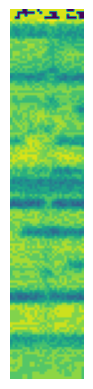

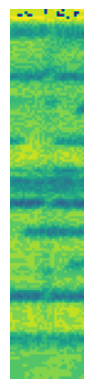

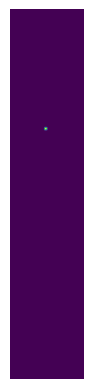

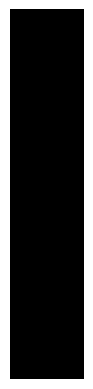

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 164


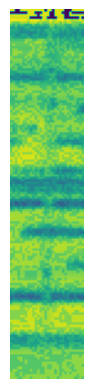

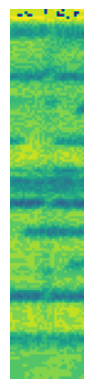

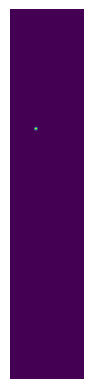

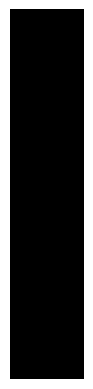

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 165


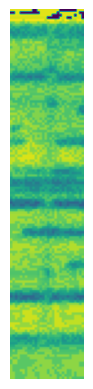

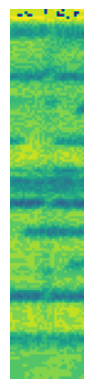

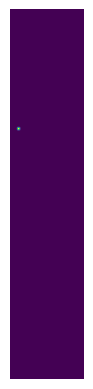

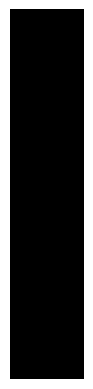

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 166


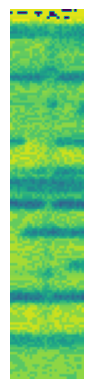

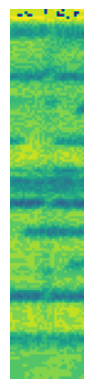

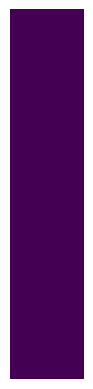

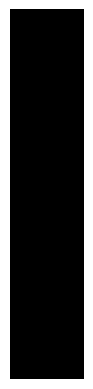

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 167


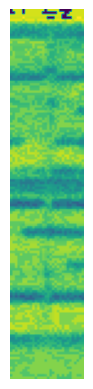

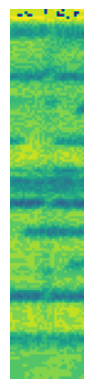

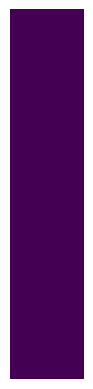

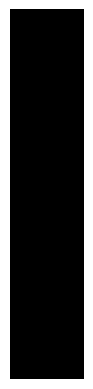

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 168


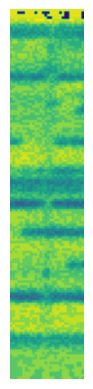

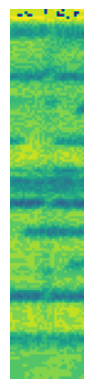

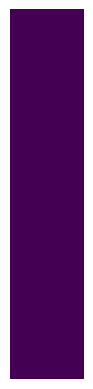

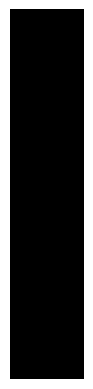

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 169


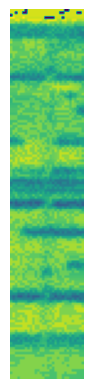

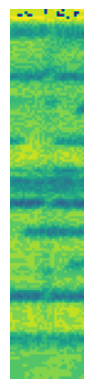

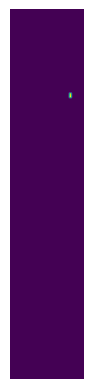

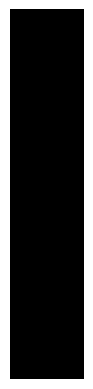

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 170


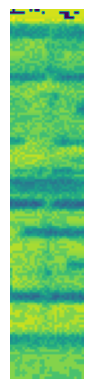

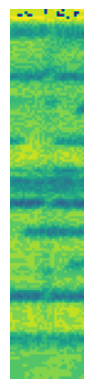

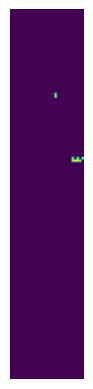

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


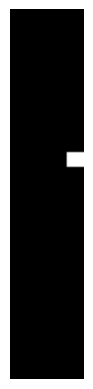

[[26.  60.5]]


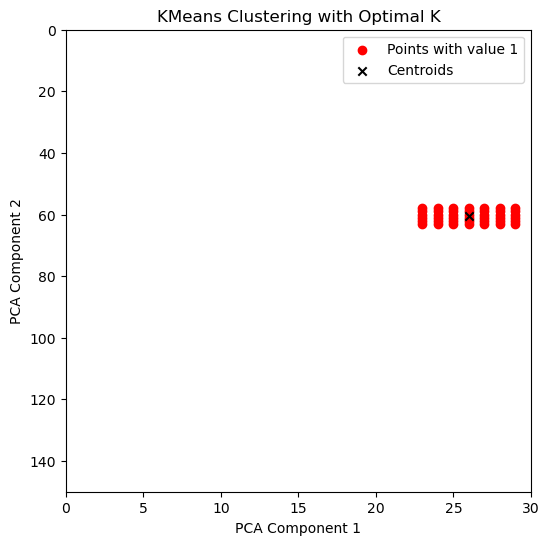

Coordinates of cluster centers:
Cluster 1: (26.0, 60.5)
seen: 1
checking image number: 171


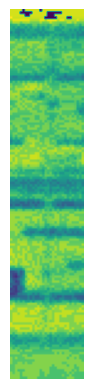

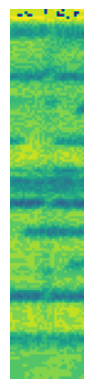

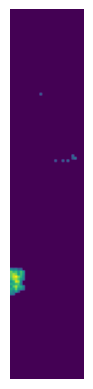

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


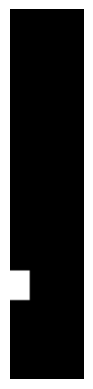

[[  3.5 111.5]]


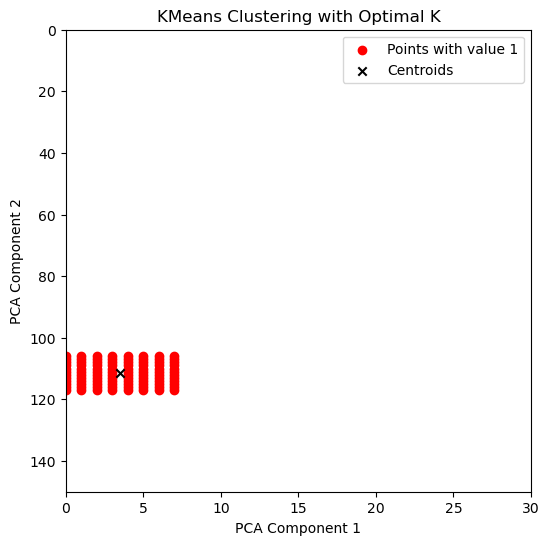

Coordinates of cluster centers:
Cluster 1: (3.5, 111.5)
seen: 1
checking image number: 172


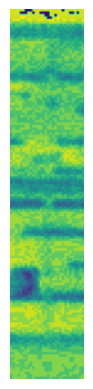

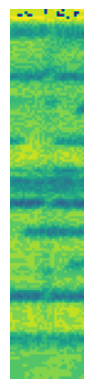

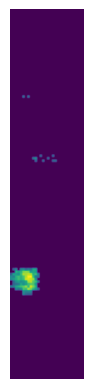

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


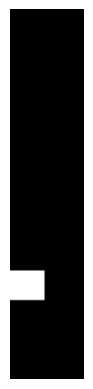

[[  6.5 111.5]]


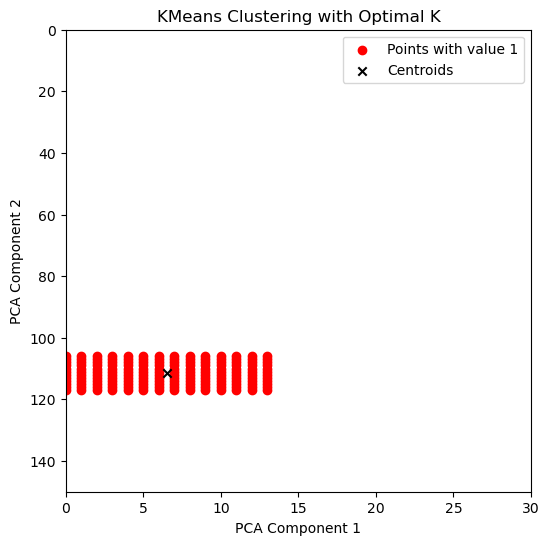

Coordinates of cluster centers:
Cluster 1: (6.5, 111.5)
seen: 1
checking image number: 173


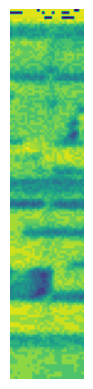

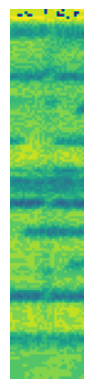

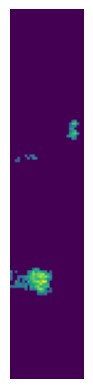

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

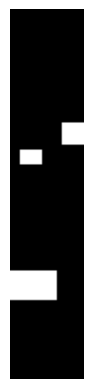

[[ 25.   50. ]
 [  8.   59.5]
 [  9.  111.5]]


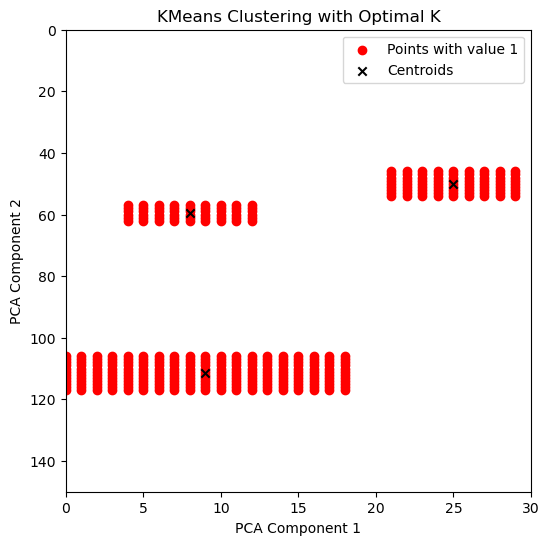

Coordinates of cluster centers:
Cluster 1: (25.0, 50.0)
Cluster 2: (8.0, 59.5)
Cluster 3: (9.0, 111.5)
seen: 3
checking image number: 174


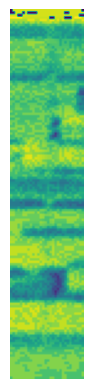

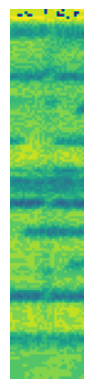

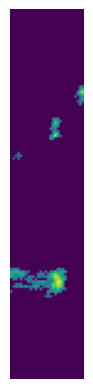

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

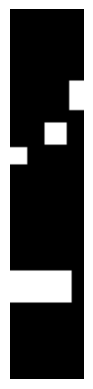

[[ 26.5  34.5]
 [ 18.   50. ]
 [  3.   59. ]
 [ 12.  112. ]]


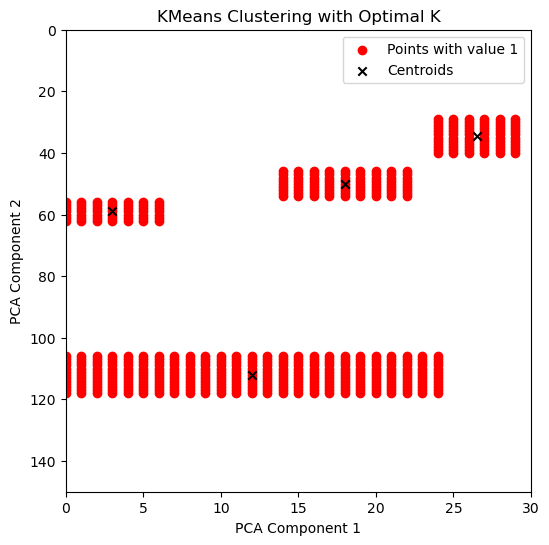

Coordinates of cluster centers:
Cluster 1: (26.5, 34.5)
Cluster 2: (18.0, 50.0)
Cluster 3: (3.0, 59.0)
Cluster 4: (12.0, 112.0)
seen: 4
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 18.
checking image number: 175


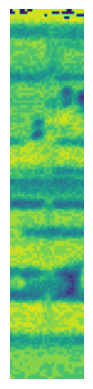

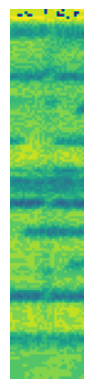

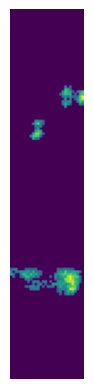

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

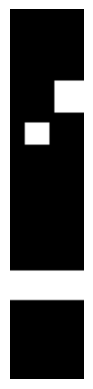

[[ 23.5  35. ]
 [ 10.5  50. ]
 [ 14.5 111.5]]


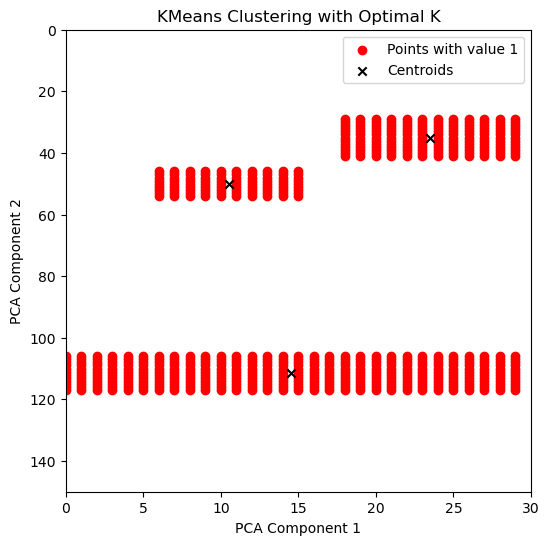

Coordinates of cluster centers:
Cluster 1: (23.5, 35.0)
Cluster 2: (10.5, 50.0)
Cluster 3: (14.5, 111.5)
seen: 3
checking image number: 176


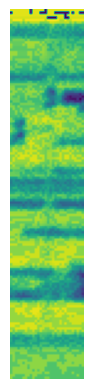

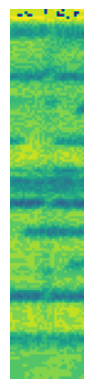

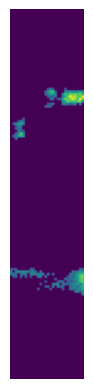

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

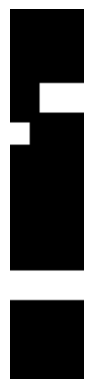

[[ 20.5  35.5]
 [  3.5  50. ]
 [ 14.5 111.5]]


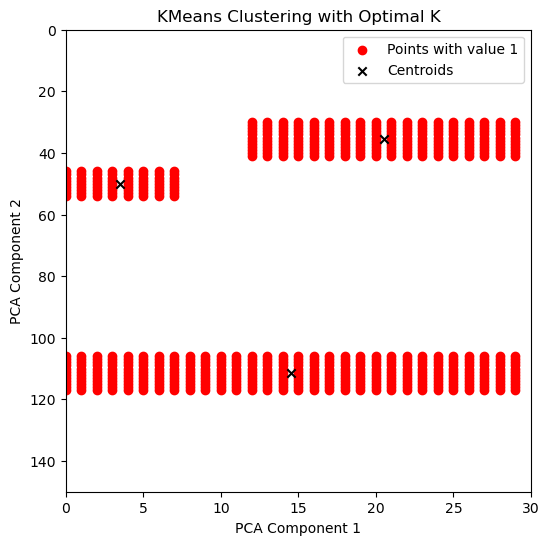

Coordinates of cluster centers:
Cluster 1: (20.5, 35.5)
Cluster 2: (3.5, 50.0)
Cluster 3: (14.5, 111.5)
seen: 3
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 19.
checking image number: 177


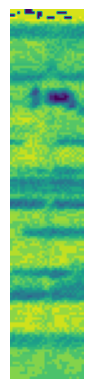

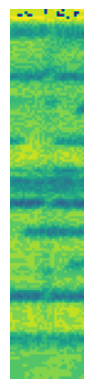

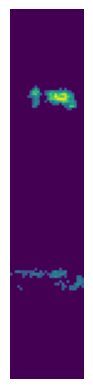

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

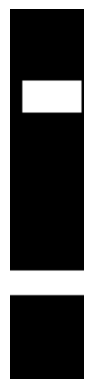

[[ 16.5  35. ]
 [ 14.5 110.5]]


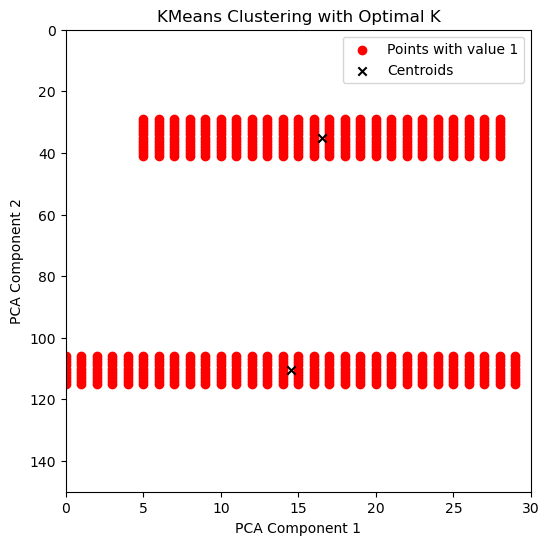

Coordinates of cluster centers:
Cluster 1: (16.5, 35.0)
Cluster 2: (14.5, 110.5)
seen: 2
checking image number: 178


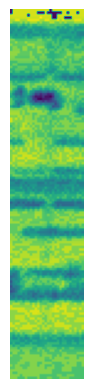

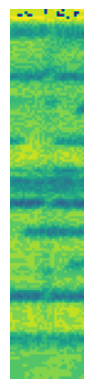

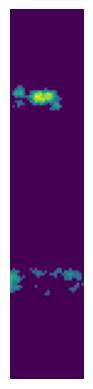

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

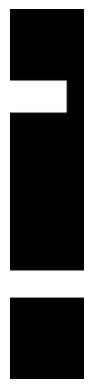

[[ 11.   35. ]
 [ 14.5 111. ]]


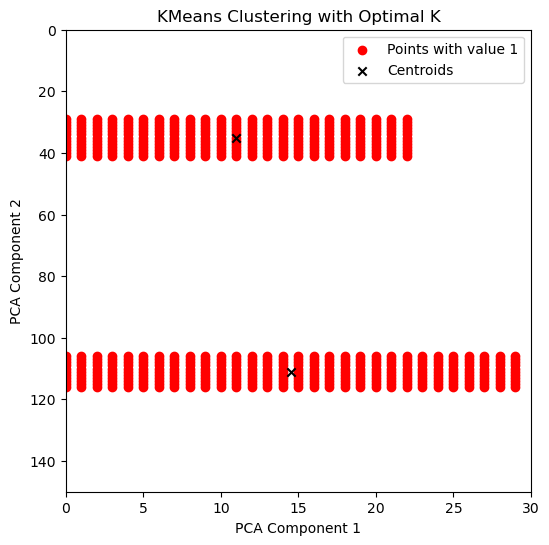

Coordinates of cluster centers:
Cluster 1: (11.0, 35.0)
Cluster 2: (14.5, 111.0)
seen: 2
checking image number: 179


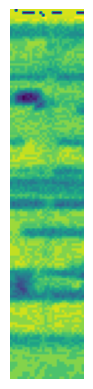

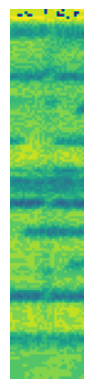

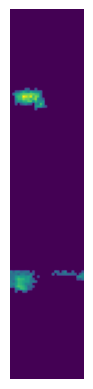

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

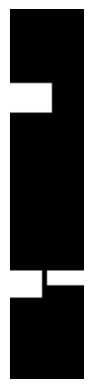

[[  8.   35.5]
 [  6.  111. ]
 [ 22.  108.5]]


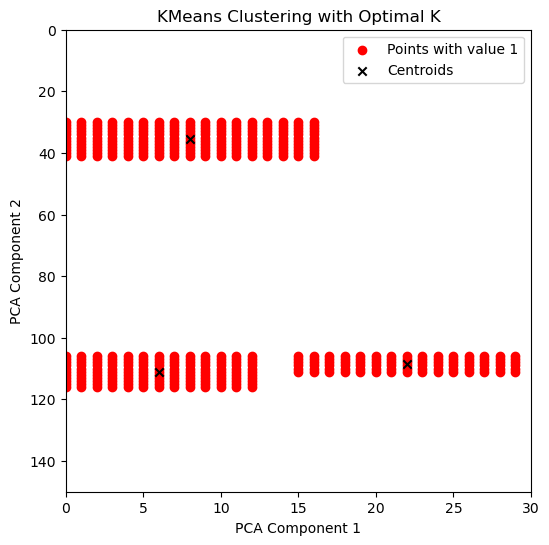

Coordinates of cluster centers:
Cluster 1: (8.0, 35.5)
Cluster 2: (6.0, 111.0)
Cluster 3: (22.0, 108.5)
seen: 3
checking image number: 180


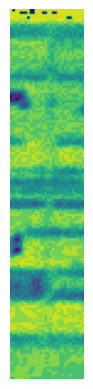

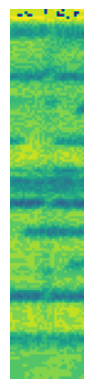

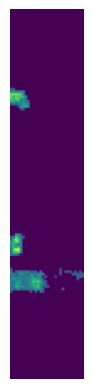

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

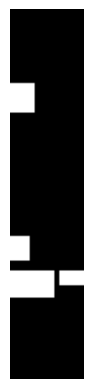

[[  4.5  35.5]
 [  3.5  96.5]
 [  8.5 111. ]
 [ 24.5 108.5]]


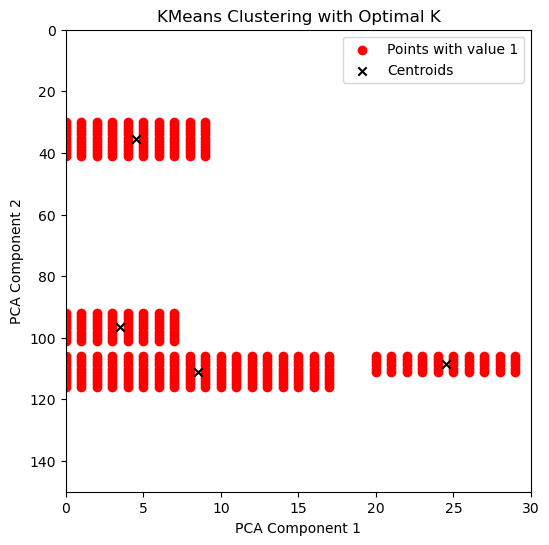

Coordinates of cluster centers:
Cluster 1: (4.5, 35.5)
Cluster 2: (3.5, 96.5)
Cluster 3: (8.5, 111.0)
Cluster 4: (24.5, 108.5)
seen: 4
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 20.
checking image number: 181


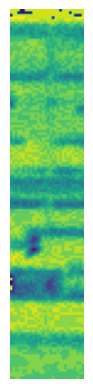

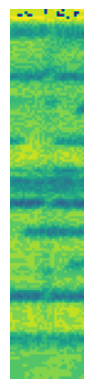

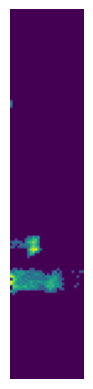

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

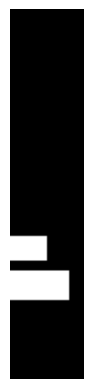

[[  7.   96.5]
 [ 11.5 111.5]]


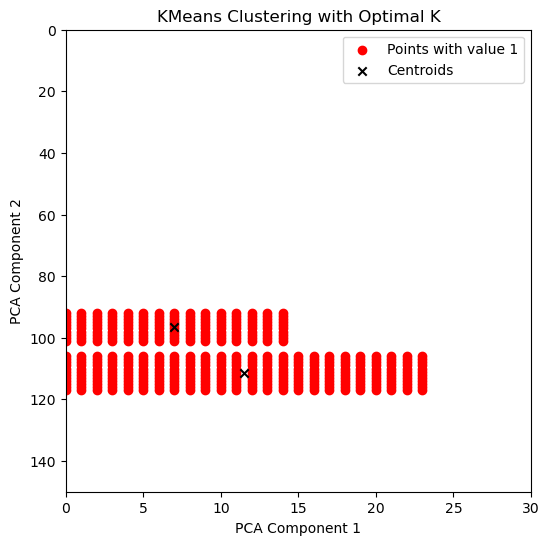

Coordinates of cluster centers:
Cluster 1: (7.0, 96.5)
Cluster 2: (11.5, 111.5)
seen: 2
checking image number: 182


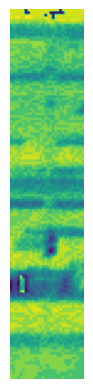

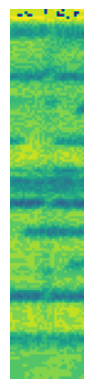

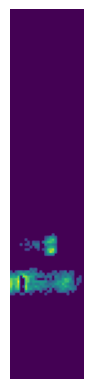

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

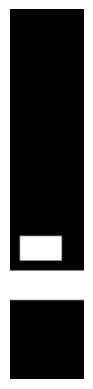

[[ 12.   96.5]
 [ 14.5 111.5]]


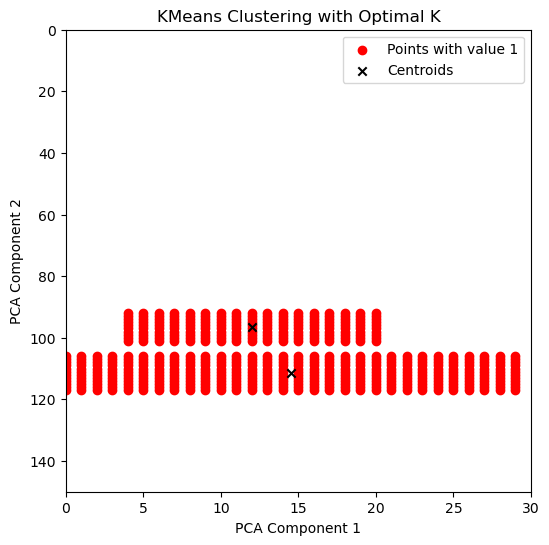

Coordinates of cluster centers:
Cluster 1: (12.0, 96.5)
Cluster 2: (14.5, 111.5)
seen: 2
checking image number: 183


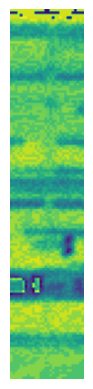

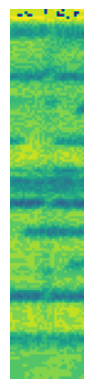

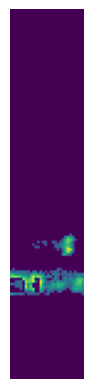

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

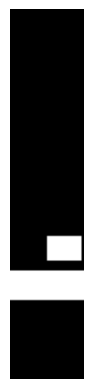

[[ 21.5  96.5]
 [ 14.5 111.5]]


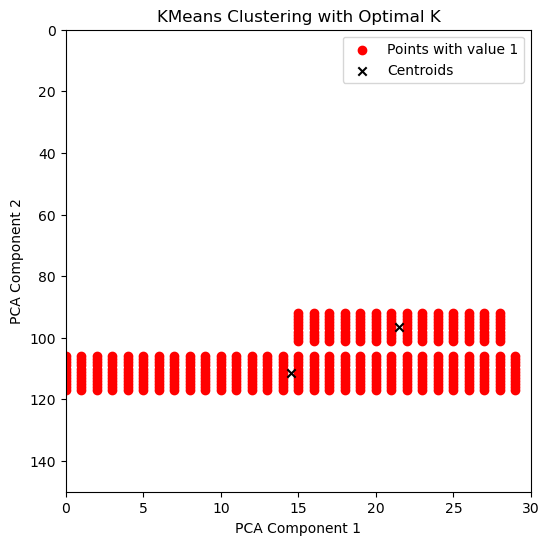

Coordinates of cluster centers:
Cluster 1: (21.5, 96.5)
Cluster 2: (14.5, 111.5)
seen: 2
checking image number: 184


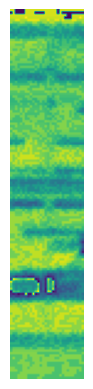

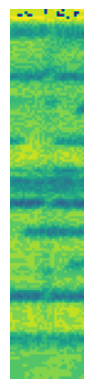

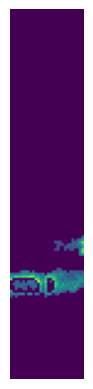

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

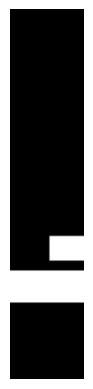

[[ 22.5  96.5]
 [ 14.5 112. ]]


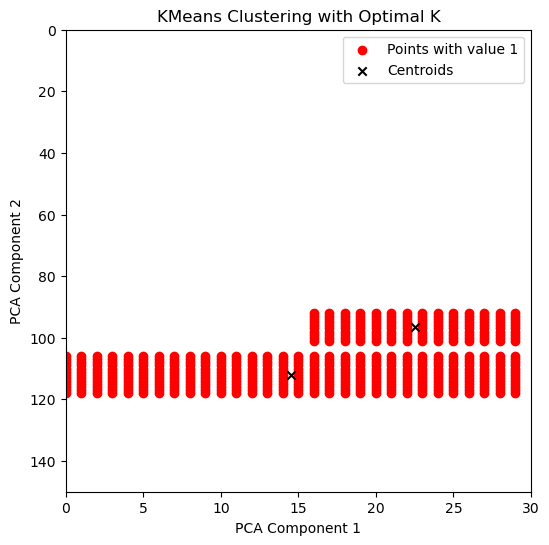

Coordinates of cluster centers:
Cluster 1: (22.5, 96.5)
Cluster 2: (14.5, 112.0)
seen: 2
checking image number: 185


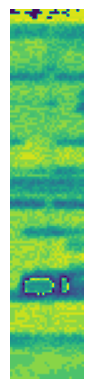

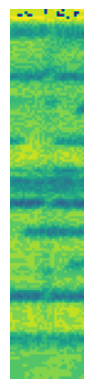

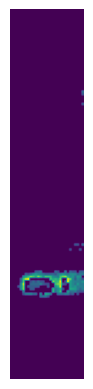

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


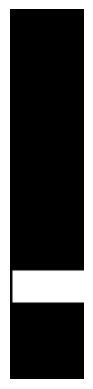

[[ 15. 112.]]


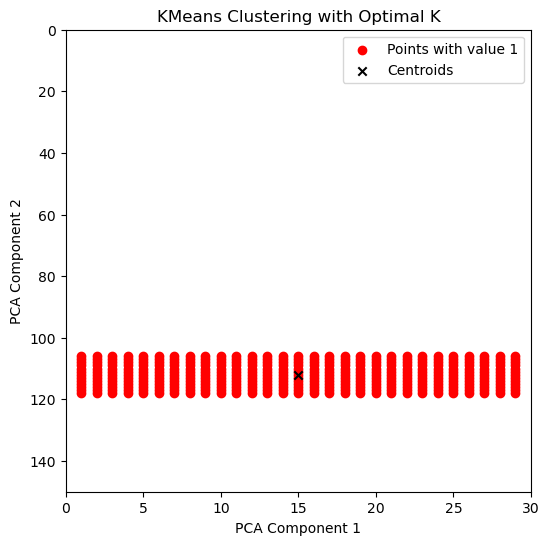

Coordinates of cluster centers:
Cluster 1: (15.0, 112.0)
seen: 1
checking image number: 186


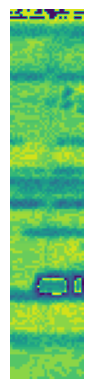

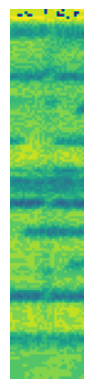

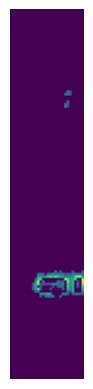

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

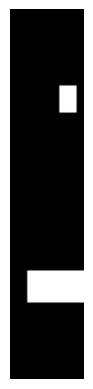

[[ 23.  36.]
 [ 18. 112.]]


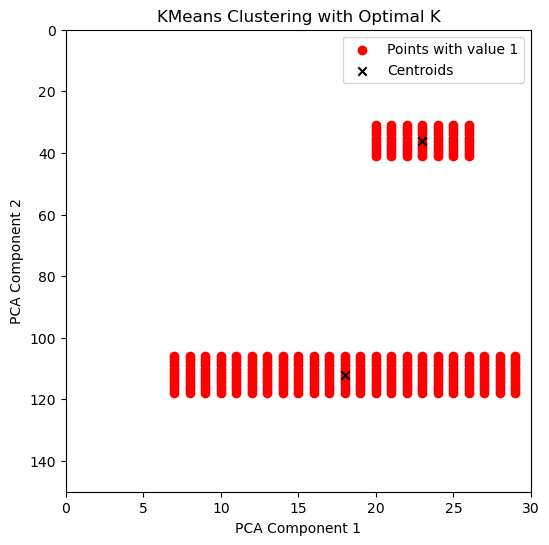

Coordinates of cluster centers:
Cluster 1: (23.0, 36.0)
Cluster 2: (18.0, 112.0)
seen: 2
checking image number: 187


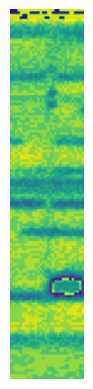

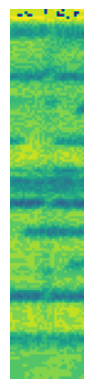

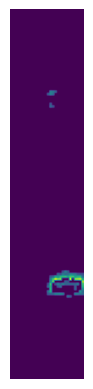

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

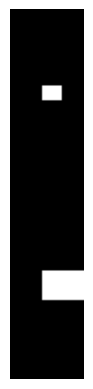

[[ 16.5  33.5]
 [ 21.  111.5]]


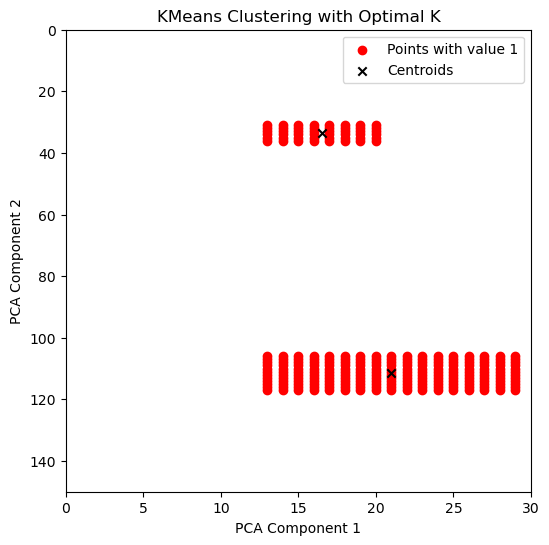

Coordinates of cluster centers:
Cluster 1: (16.5, 33.5)
Cluster 2: (21.0, 111.5)
seen: 2
checking image number: 188


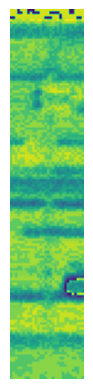

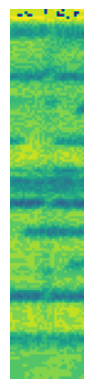

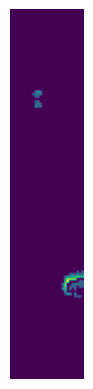

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

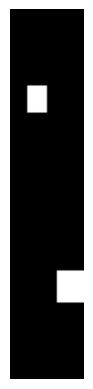

[[ 10.5  36. ]
 [ 24.  112. ]]


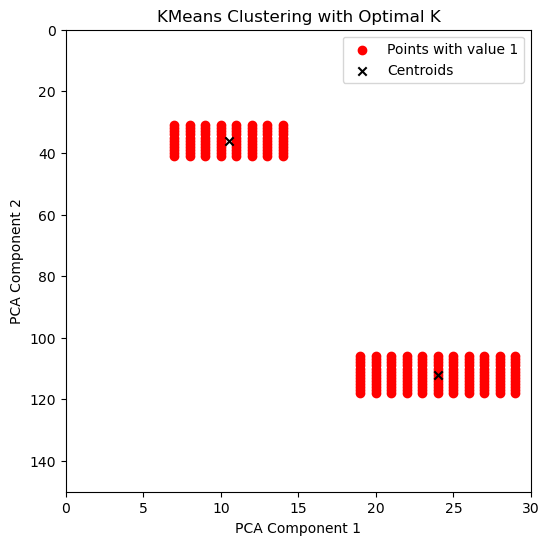

Coordinates of cluster centers:
Cluster 1: (10.5, 36.0)
Cluster 2: (24.0, 112.0)
seen: 2
checking image number: 189


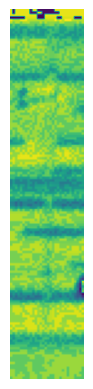

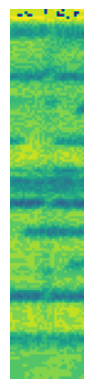

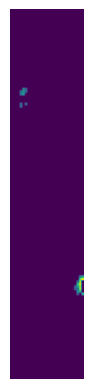

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

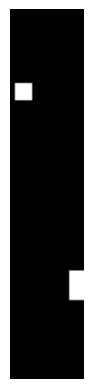

[[  5.   33. ]
 [ 26.5 111.5]]


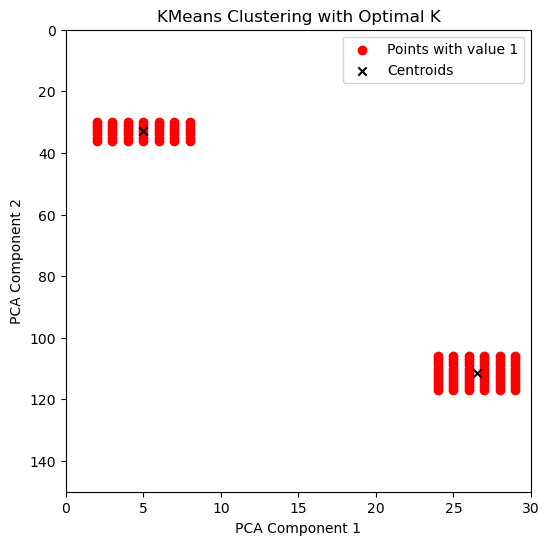

Coordinates of cluster centers:
Cluster 1: (5.0, 33.0)
Cluster 2: (26.5, 111.5)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 4.
checking image number: 190


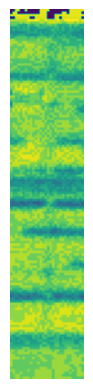

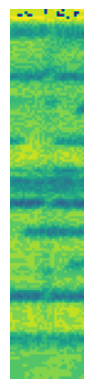

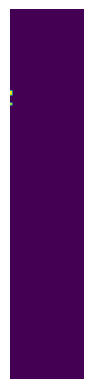

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


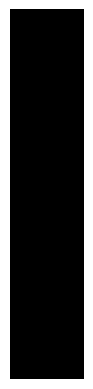

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 191


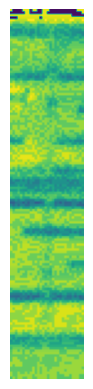

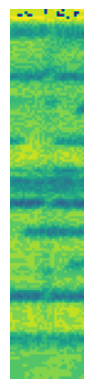

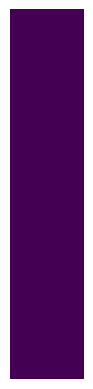

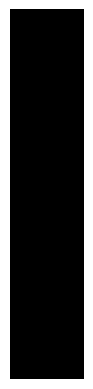

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 192


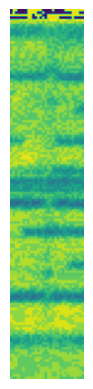

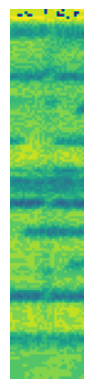

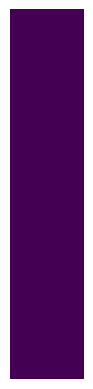

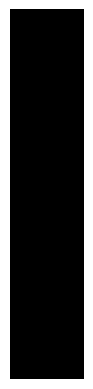

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 193


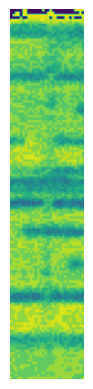

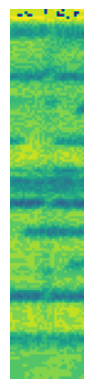

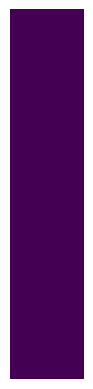

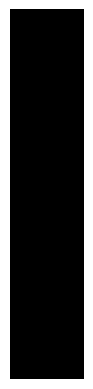

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 194


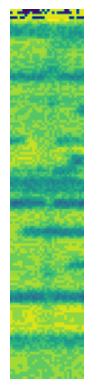

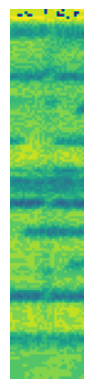

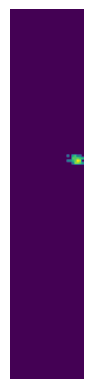

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


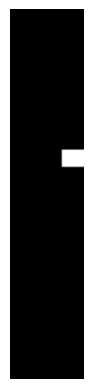

[[25. 60.]]


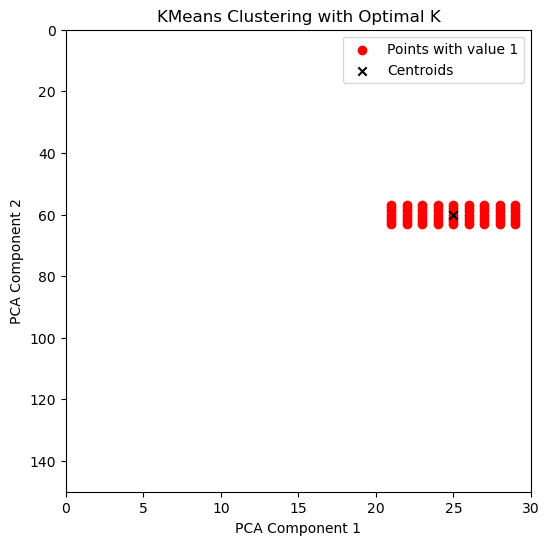

Coordinates of cluster centers:
Cluster 1: (25.0, 60.0)
seen: 1
checking image number: 195


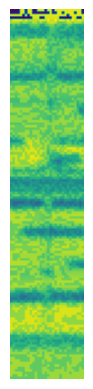

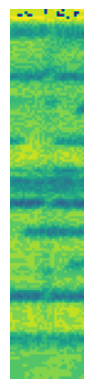

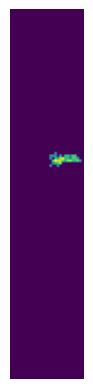

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


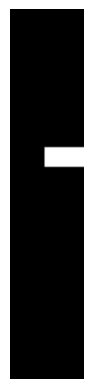

[[21.5 59.5]]


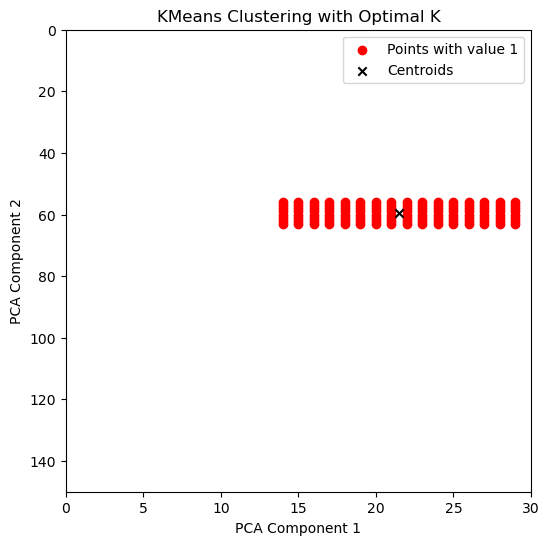

Coordinates of cluster centers:
Cluster 1: (21.5, 59.5)
seen: 1
checking image number: 196


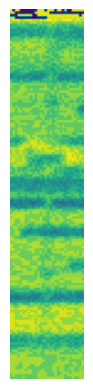

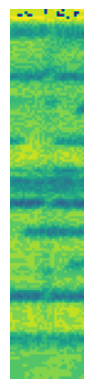

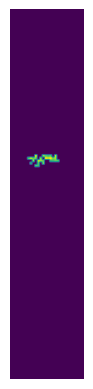

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


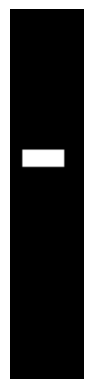

[[13. 60.]]


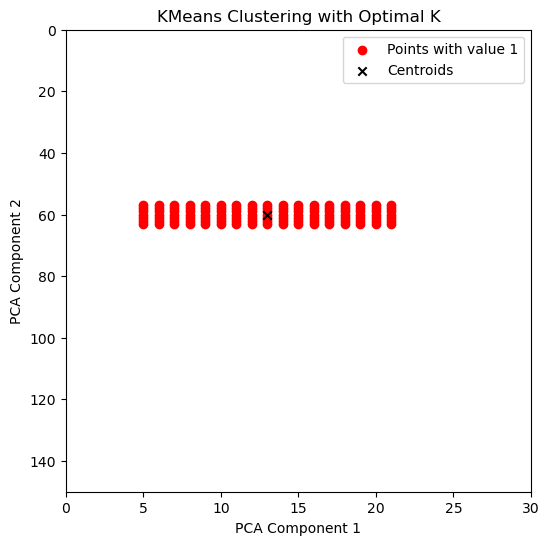

Coordinates of cluster centers:
Cluster 1: (13.0, 60.0)
seen: 1
checking image number: 197


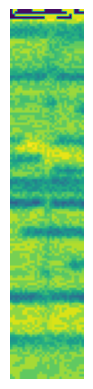

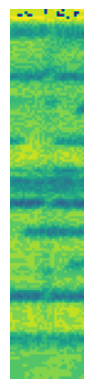

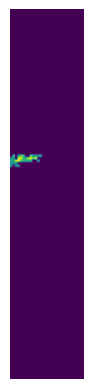

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


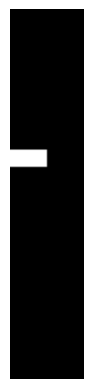

[[ 7. 60.]]


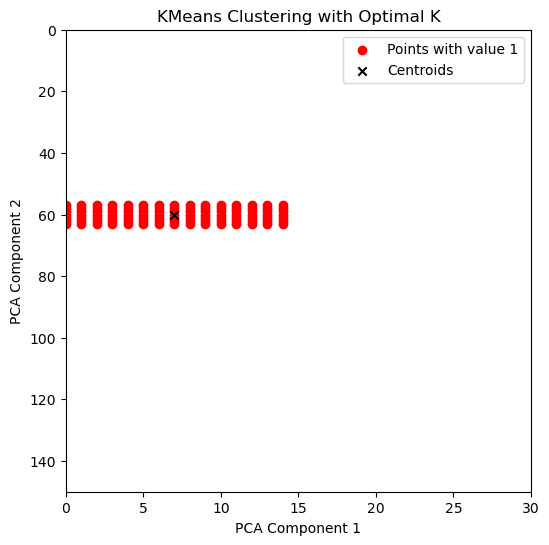

Coordinates of cluster centers:
Cluster 1: (7.0, 60.0)
seen: 1
checking image number: 198


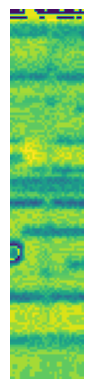

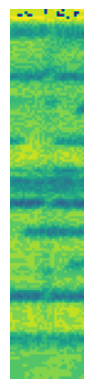

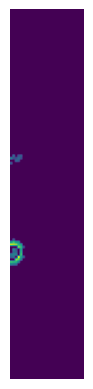

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

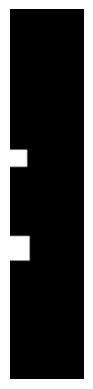

[[ 3.  60. ]
 [ 3.5 96.5]]


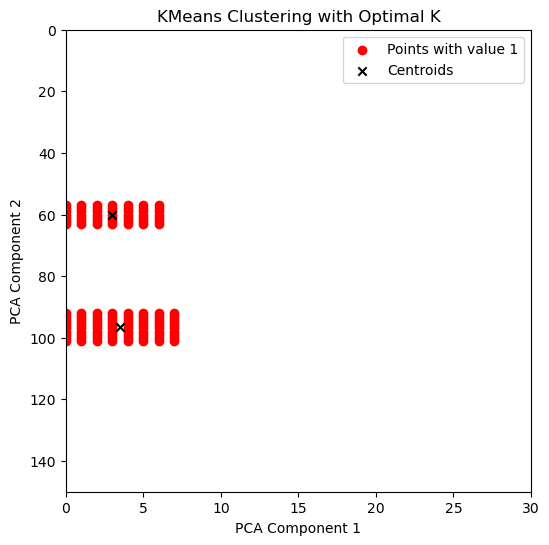

Coordinates of cluster centers:
Cluster 1: (3.0, 60.0)
Cluster 2: (3.5, 96.5)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 21.
checking image number: 199


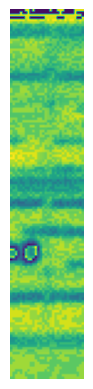

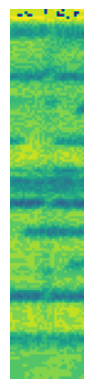

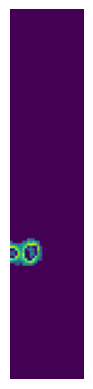

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


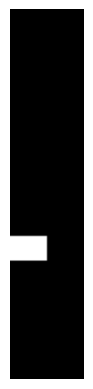

[[ 7.  96.5]]


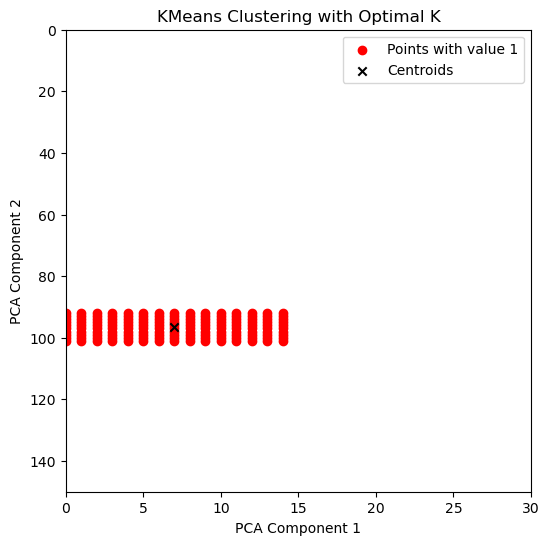

Coordinates of cluster centers:
Cluster 1: (7.0, 96.5)
seen: 1
checking image number: 200


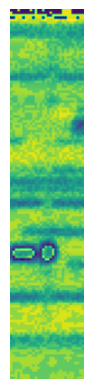

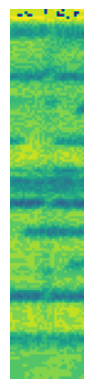

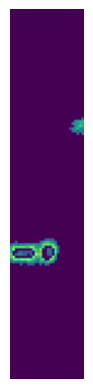

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

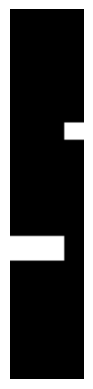

[[25.5 49. ]
 [10.5 96.5]]


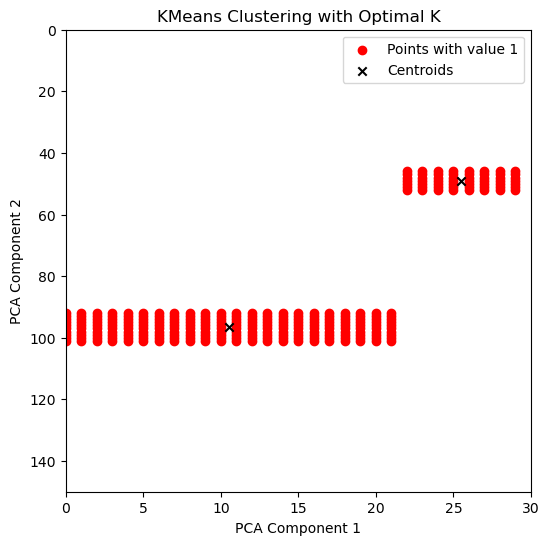

Coordinates of cluster centers:
Cluster 1: (25.5, 49.0)
Cluster 2: (10.5, 96.5)
seen: 2
checking image number: 201


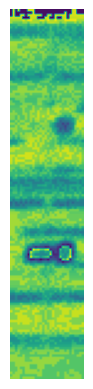

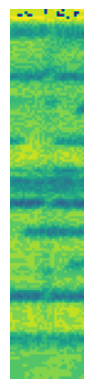

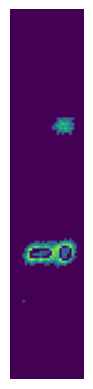

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

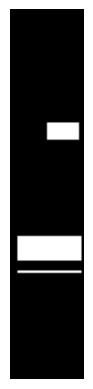

[[ 21.   49. ]
 [ 15.5  96.5]
 [ 15.5 106. ]]


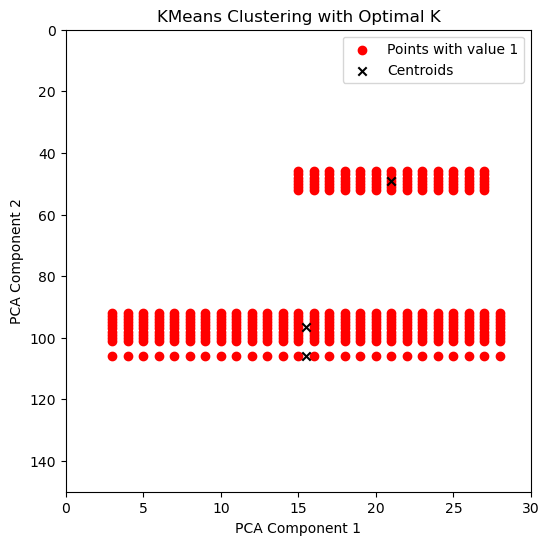

Coordinates of cluster centers:
Cluster 1: (21.0, 49.0)
Cluster 2: (15.5, 96.5)
Cluster 3: (15.5, 106.0)
seen: 3
checking image number: 202


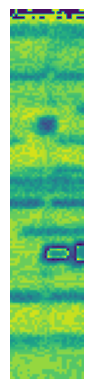

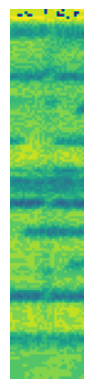

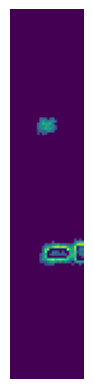

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

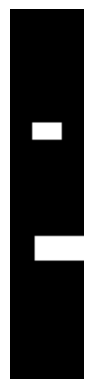

[[14.5 49. ]
 [19.5 96.5]]


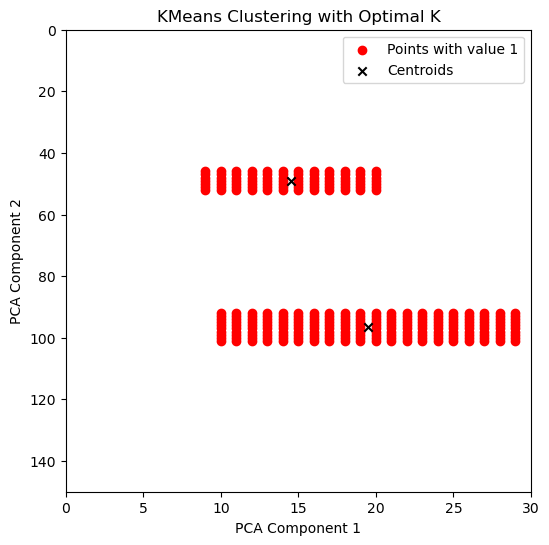

Coordinates of cluster centers:
Cluster 1: (14.5, 49.0)
Cluster 2: (19.5, 96.5)
seen: 2
checking image number: 203


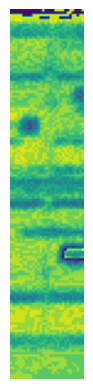

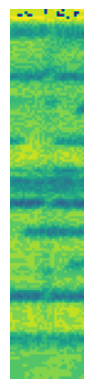

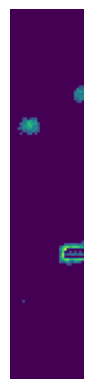

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

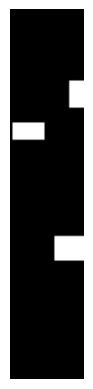

[[26.5 34. ]
 [ 7.  49. ]
 [23.5 96.5]]


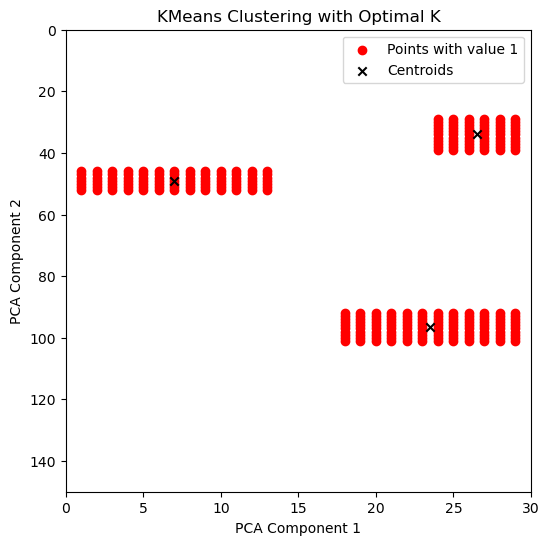

Coordinates of cluster centers:
Cluster 1: (26.5, 34.0)
Cluster 2: (7.0, 49.0)
Cluster 3: (23.5, 96.5)
seen: 3
checking image number: 204


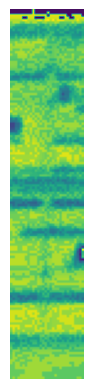

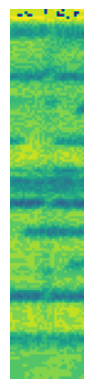

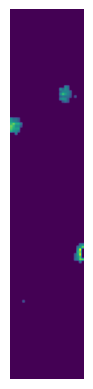

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

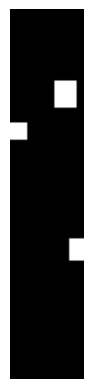

[[22.  34. ]
 [ 3.  49. ]
 [26.5 97. ]]


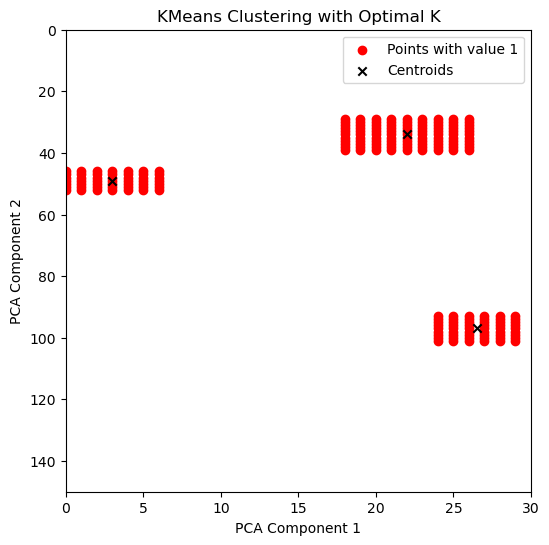

Coordinates of cluster centers:
Cluster 1: (22.0, 34.0)
Cluster 2: (3.0, 49.0)
Cluster 3: (26.5, 97.0)
seen: 3
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 22.
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 5.
checking image number: 205


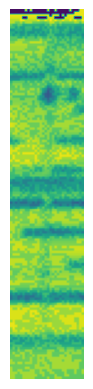

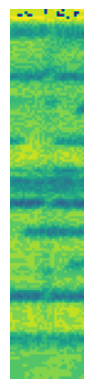

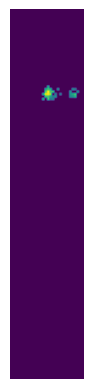

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

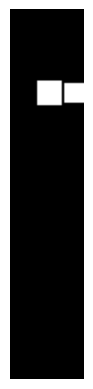

[[15.5 33.5]
 [25.5 33.5]]


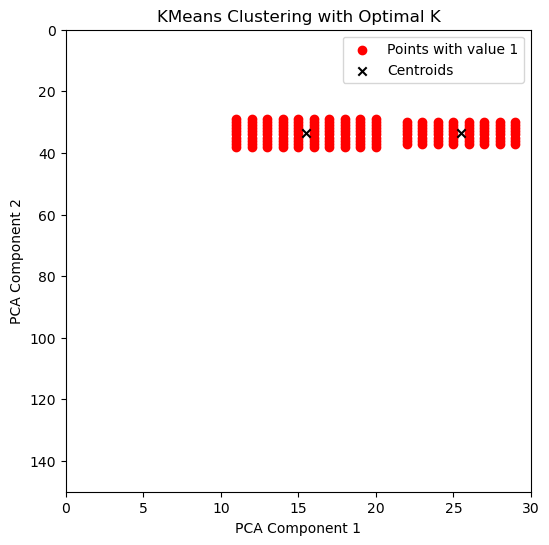

Coordinates of cluster centers:
Cluster 1: (15.5, 33.5)
Cluster 2: (25.5, 33.5)
seen: 2
checking image number: 206


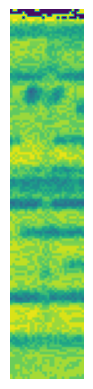

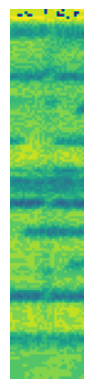

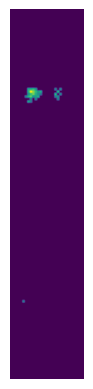

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

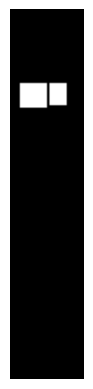

[[ 9.  34.5]
 [19.  34. ]]


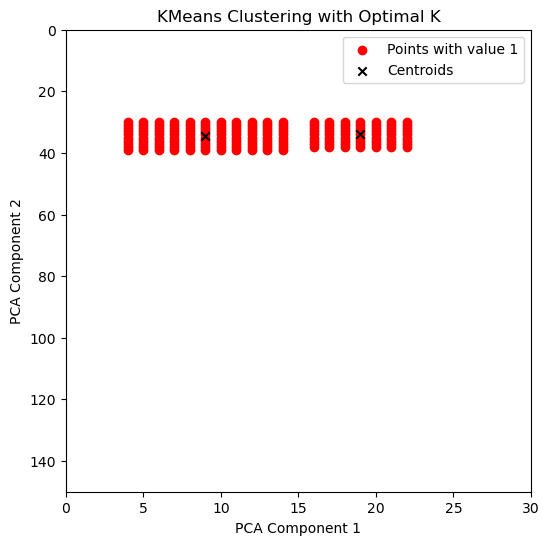

Coordinates of cluster centers:
Cluster 1: (9.0, 34.5)
Cluster 2: (19.0, 34.0)
seen: 2
checking image number: 207


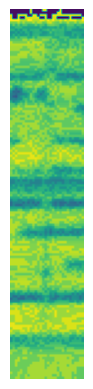

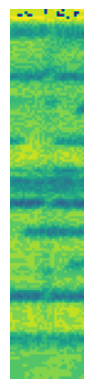

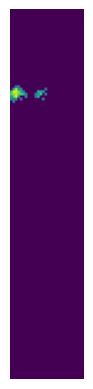

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

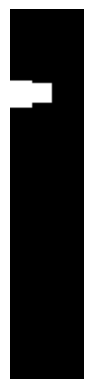

[[ 7.33742331 33.80368098]]


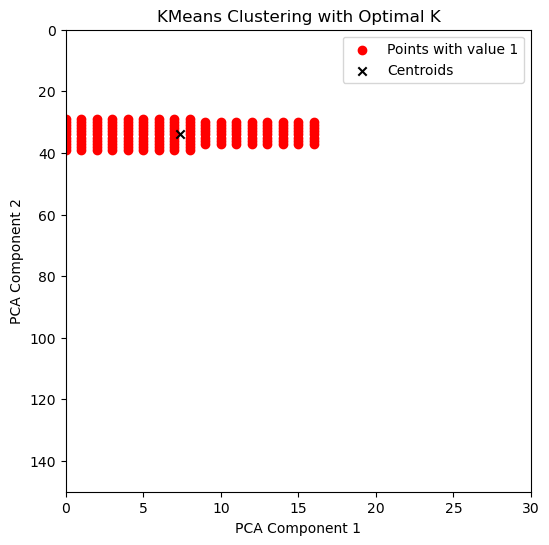

Coordinates of cluster centers:
Cluster 1: (7.337423312883436, 33.80368098159509)
seen: 1
checking image number: 208


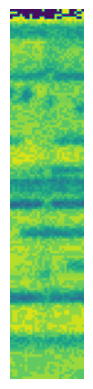

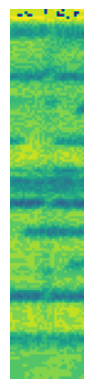

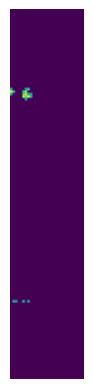

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

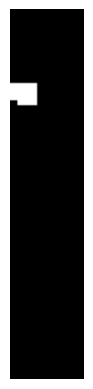

[[ 5.25806452 33.77419355]]


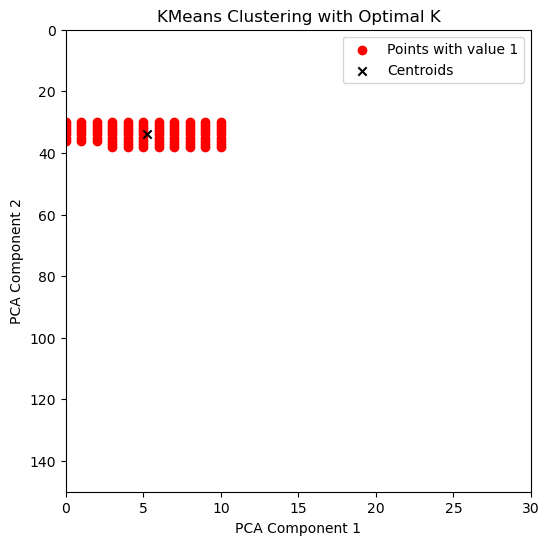

Coordinates of cluster centers:
Cluster 1: (5.258064516129032, 33.774193548387096)
seen: 1
checking image number: 209


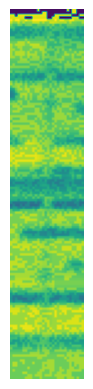

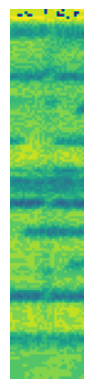

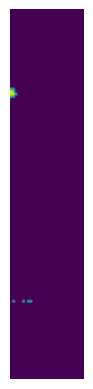

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


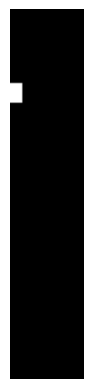

[[ 2.  33.5]]


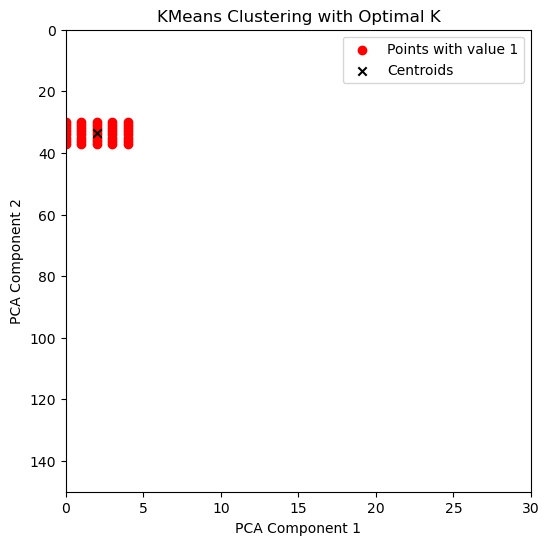

Coordinates of cluster centers:
Cluster 1: (2.0, 33.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 6.
checking image number: 210


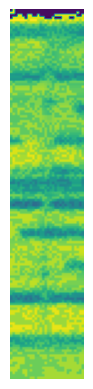

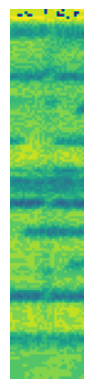

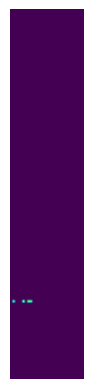

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


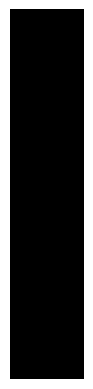

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 211


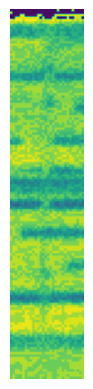

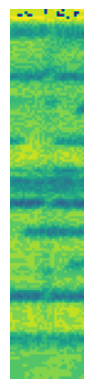

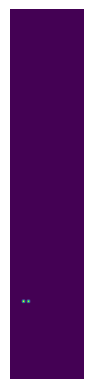

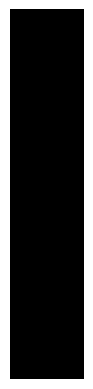

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 212


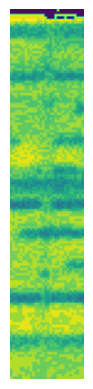

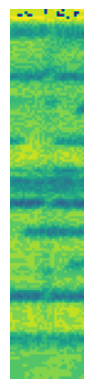

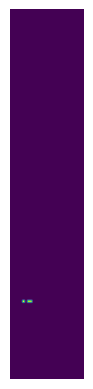

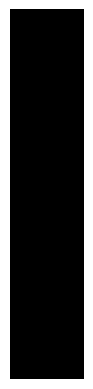

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 213


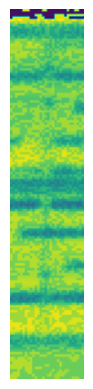

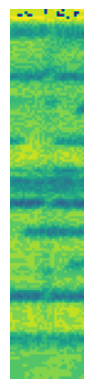

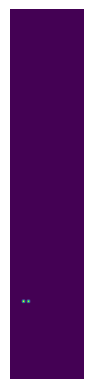

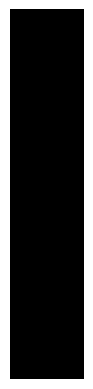

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 214


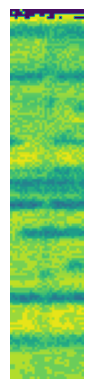

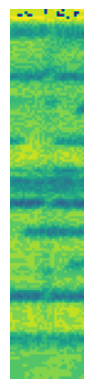

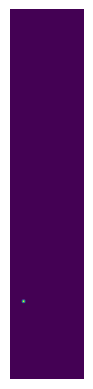

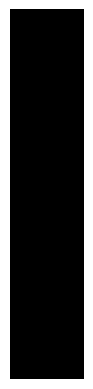

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 215


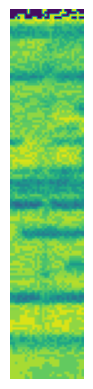

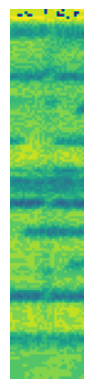

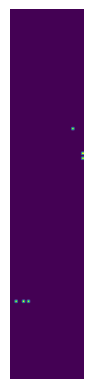

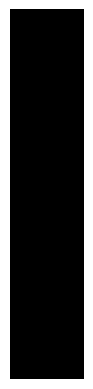

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 216


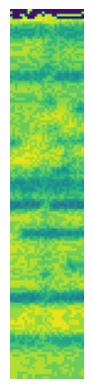

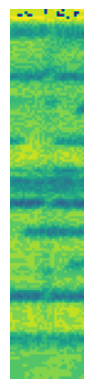

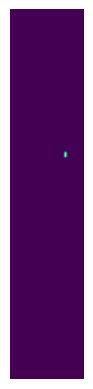

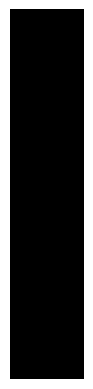

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 217


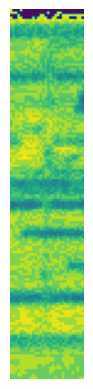

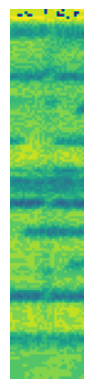

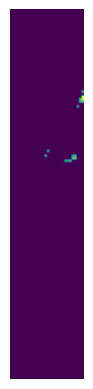

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows wi

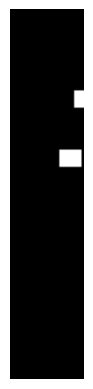

[[27.5 36. ]
 [24.  60. ]]


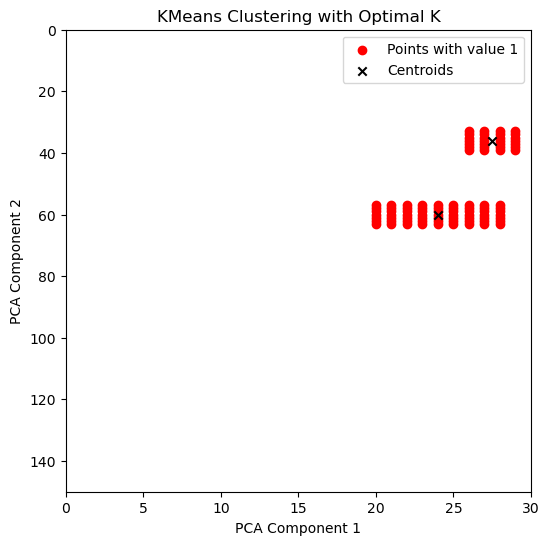

Coordinates of cluster centers:
Cluster 1: (27.5, 36.0)
Cluster 2: (24.0, 60.0)
seen: 2
checking image number: 218


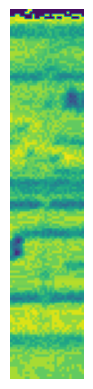

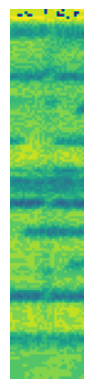

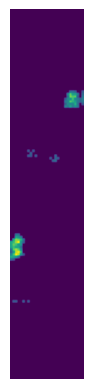

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

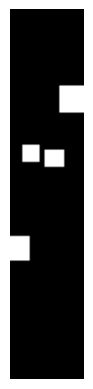

[[24.5 36. ]
 [ 8.  58. ]
 [17.5 60. ]
 [ 3.5 96.5]]


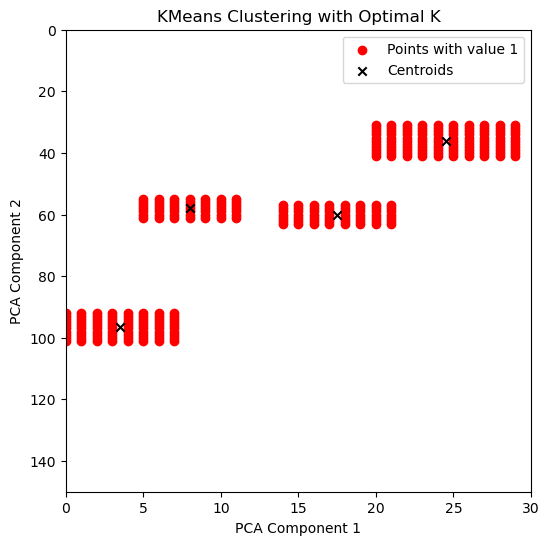

Coordinates of cluster centers:
Cluster 1: (24.5, 36.0)
Cluster 2: (8.0, 58.0)
Cluster 3: (17.5, 60.0)
Cluster 4: (3.5, 96.5)
seen: 4
checking image number: 219


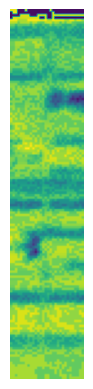

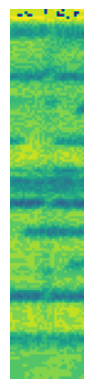

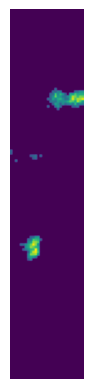

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

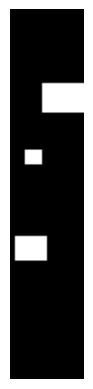

[[21.  35.5]
 [ 9.  59.5]
 [ 8.  96.5]]


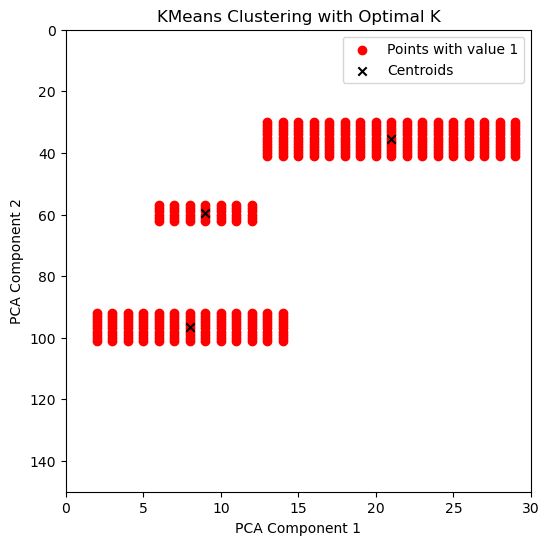

Coordinates of cluster centers:
Cluster 1: (21.0, 35.5)
Cluster 2: (9.0, 59.5)
Cluster 3: (8.0, 96.5)
seen: 3
checking image number: 220


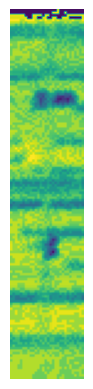

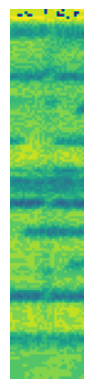

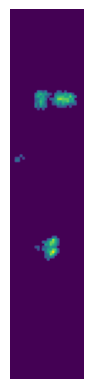

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

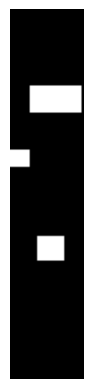

[[18.  36. ]
 [ 3.5 60. ]
 [16.  96.5]]


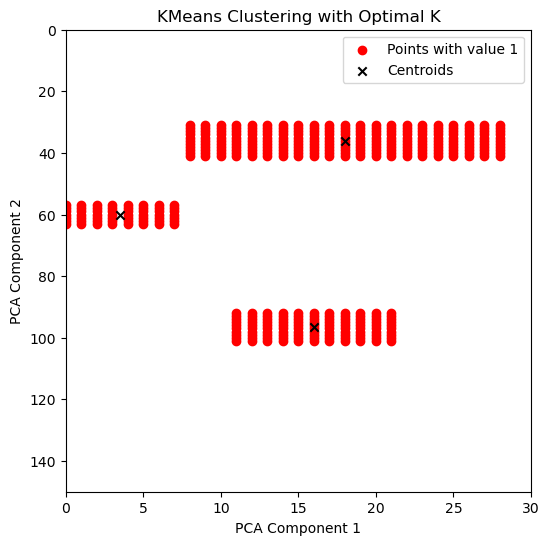

Coordinates of cluster centers:
Cluster 1: (18.0, 36.0)
Cluster 2: (3.5, 60.0)
Cluster 3: (16.0, 96.5)
seen: 3
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 23.
checking image number: 221


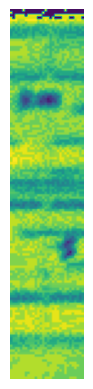

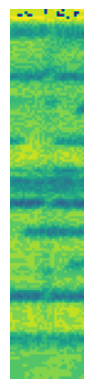

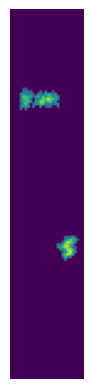

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

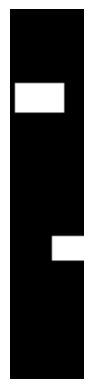

[[11.5 35.5]
 [23.  96.5]]


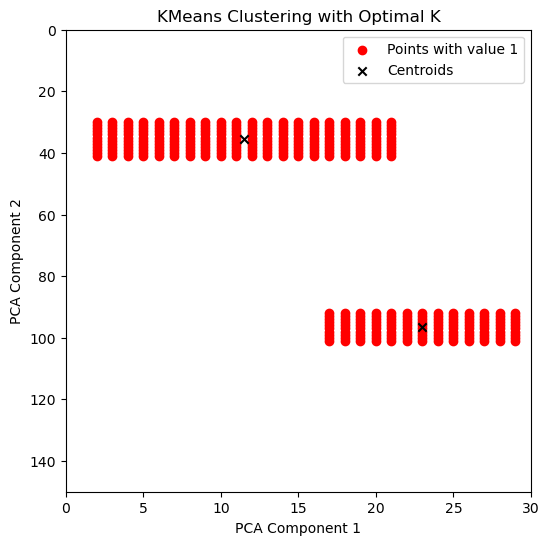

Coordinates of cluster centers:
Cluster 1: (11.5, 35.5)
Cluster 2: (23.0, 96.5)
seen: 2
checking image number: 222


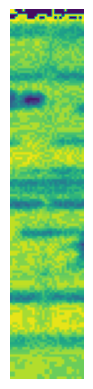

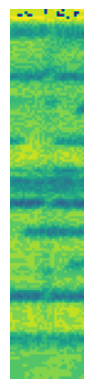

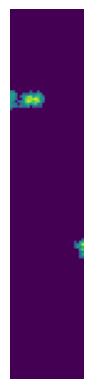

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

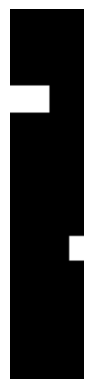

[[ 7.5 36. ]
 [26.5 96.5]]


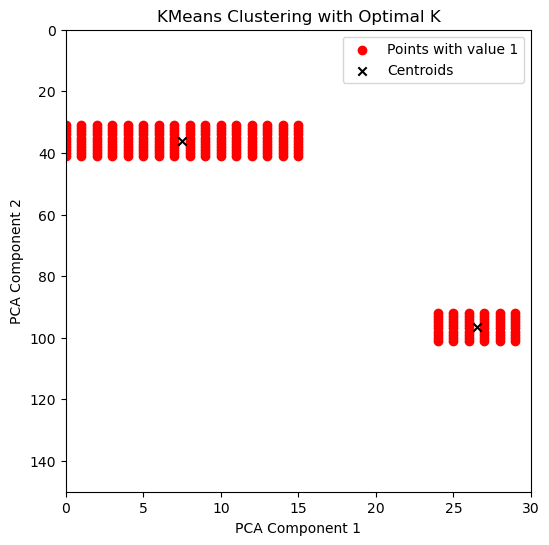

Coordinates of cluster centers:
Cluster 1: (7.5, 36.0)
Cluster 2: (26.5, 96.5)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 24.
checking image number: 223


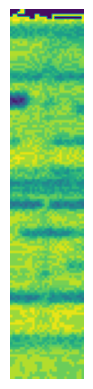

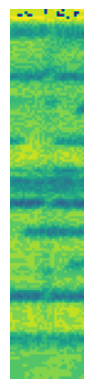

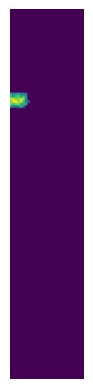

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


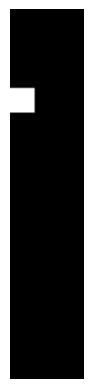

[[ 4.5 36.5]]


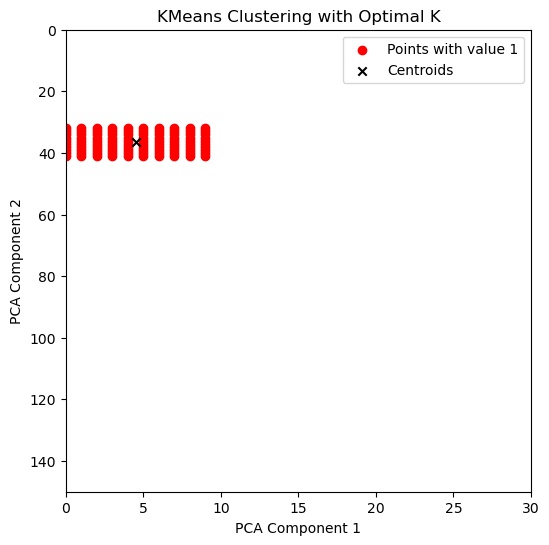

Coordinates of cluster centers:
Cluster 1: (4.5, 36.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 25.
checking image number: 224


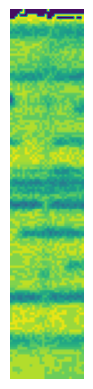

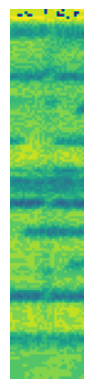

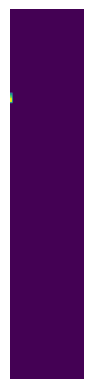

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


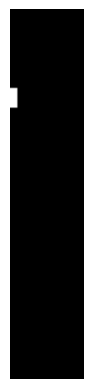

[[ 1.  35.5]]


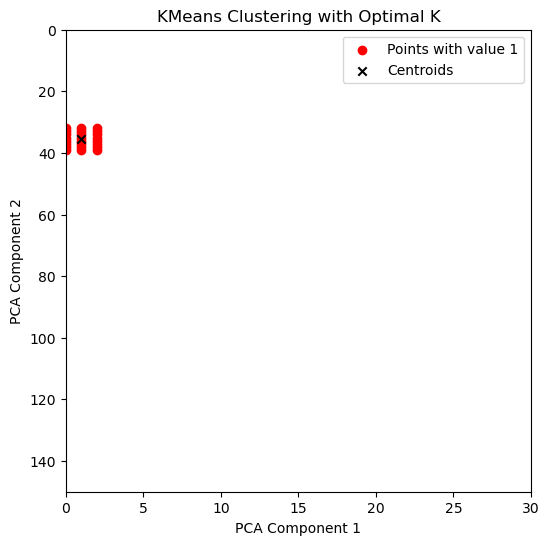

Coordinates of cluster centers:
Cluster 1: (1.0, 35.5)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 26.
checking image number: 225


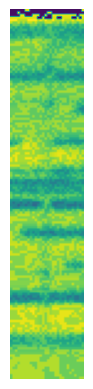

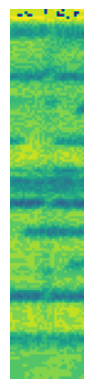

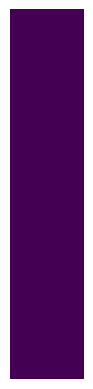

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


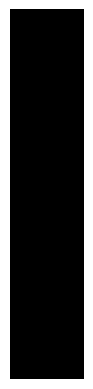

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 226


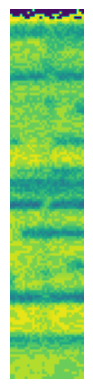

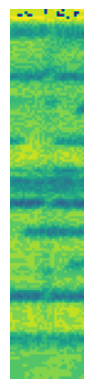

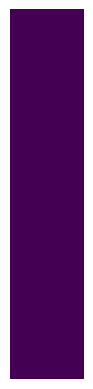

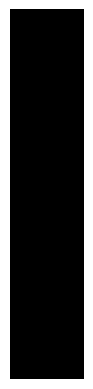

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 227


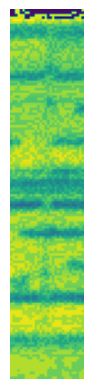

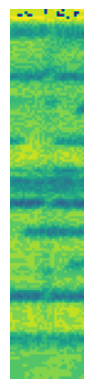

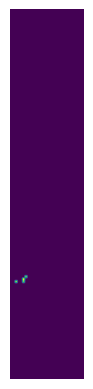

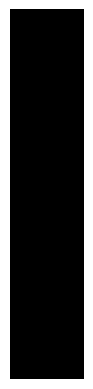

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 228


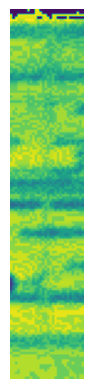

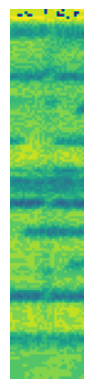

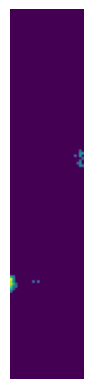

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows wi

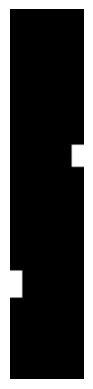

[[ 27.  59.]
 [  2. 111.]]


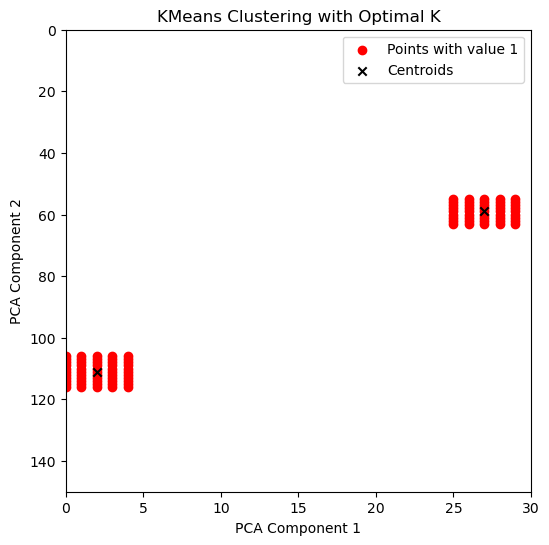

Coordinates of cluster centers:
Cluster 1: (27.0, 59.0)
Cluster 2: (2.0, 111.0)
seen: 2
checking image number: 229


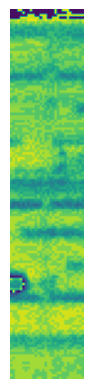

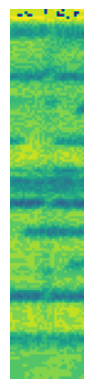

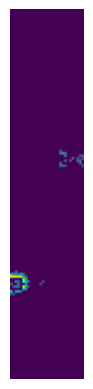

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

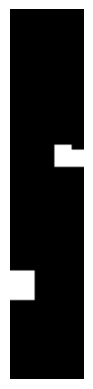

[[ 23.14285714  59.35714286]
 [  4.5        111.5       ]]


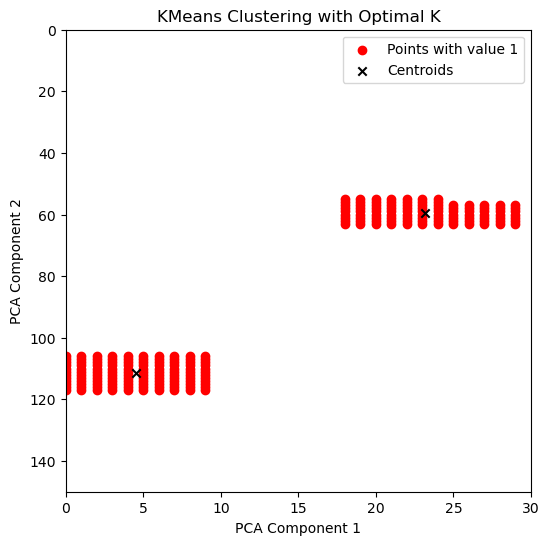

Coordinates of cluster centers:
Cluster 1: (23.142857142857142, 59.357142857142854)
Cluster 2: (4.5, 111.5)
seen: 2
checking image number: 230


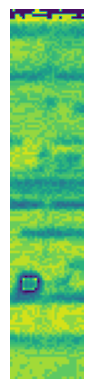

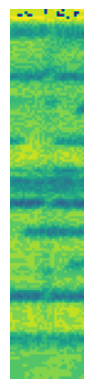

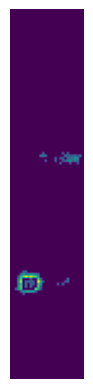

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

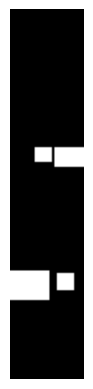

[[ 13.   58.5]
 [ 23.5  59.5]
 [  7.5 111.5]
 [ 22.  110. ]]


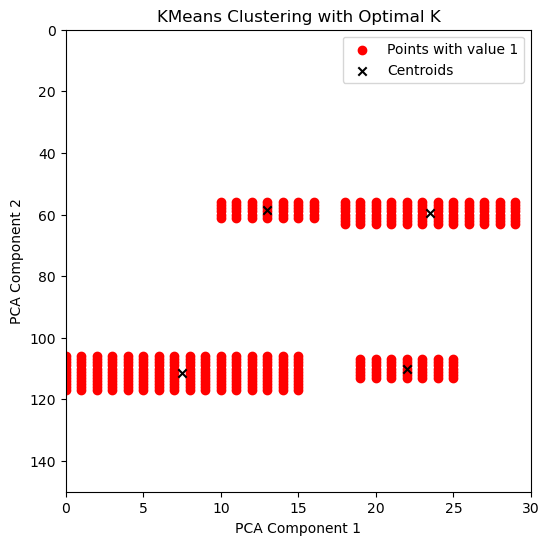

Coordinates of cluster centers:
Cluster 1: (13.0, 58.5)
Cluster 2: (23.5, 59.5)
Cluster 3: (7.5, 111.5)
Cluster 4: (22.0, 110.0)
seen: 4
checking image number: 231


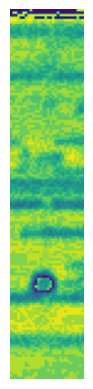

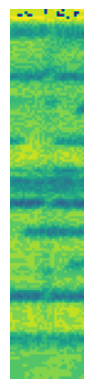

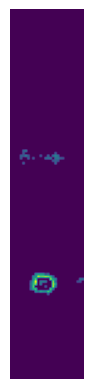

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

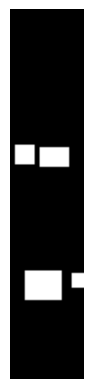

[[  5.5  58.5]
 [ 17.5  59.5]
 [ 13.  111.5]
 [ 27.  109.5]]


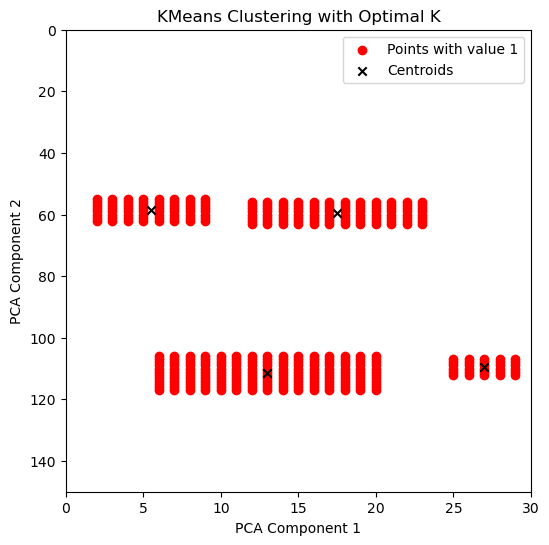

Coordinates of cluster centers:
Cluster 1: (5.5, 58.5)
Cluster 2: (17.5, 59.5)
Cluster 3: (13.0, 111.5)
Cluster 4: (27.0, 109.5)
seen: 4
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 27.
checking image number: 232


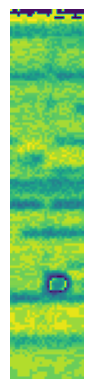

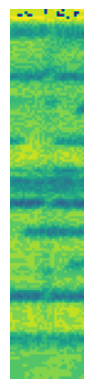

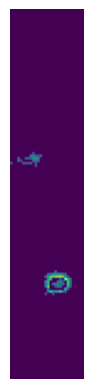

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

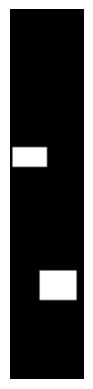

[[  7.5  59.5]
 [ 19.  111.5]]


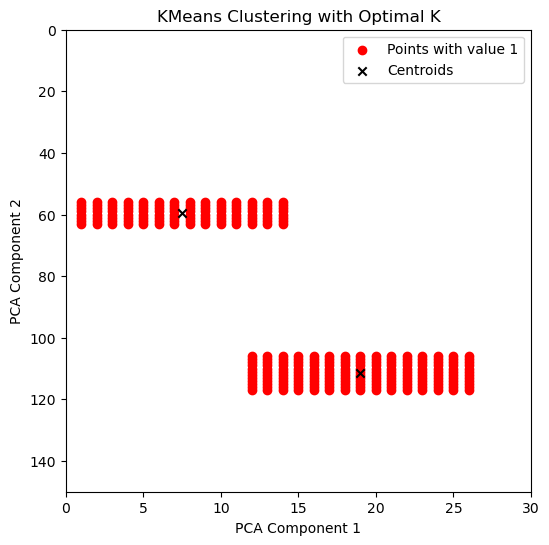

Coordinates of cluster centers:
Cluster 1: (7.5, 59.5)
Cluster 2: (19.0, 111.5)
seen: 2
checking image number: 233


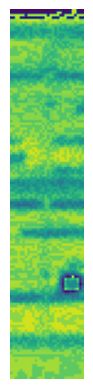

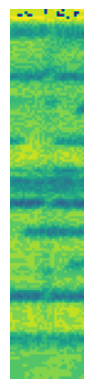

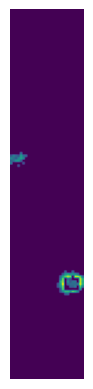

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

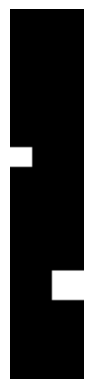

[[  4.   59.5]
 [ 23.  111.5]]


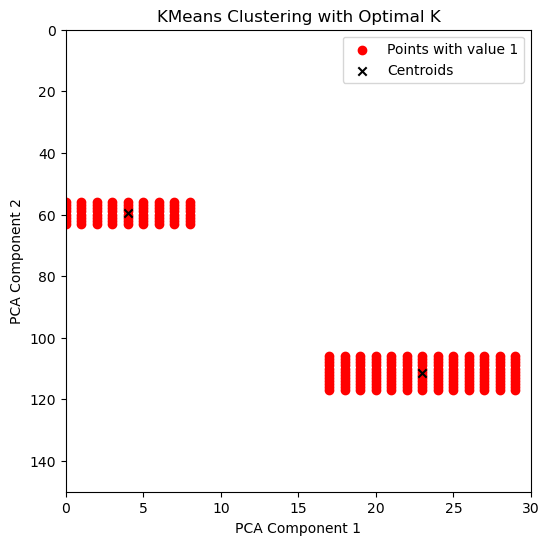

Coordinates of cluster centers:
Cluster 1: (4.0, 59.5)
Cluster 2: (23.0, 111.5)
seen: 2
checking image number: 234


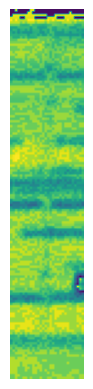

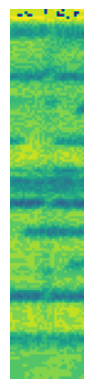

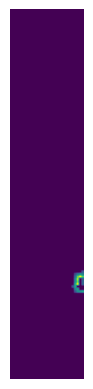

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


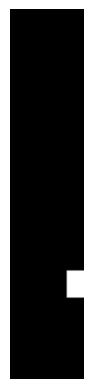

[[ 26. 111.]]


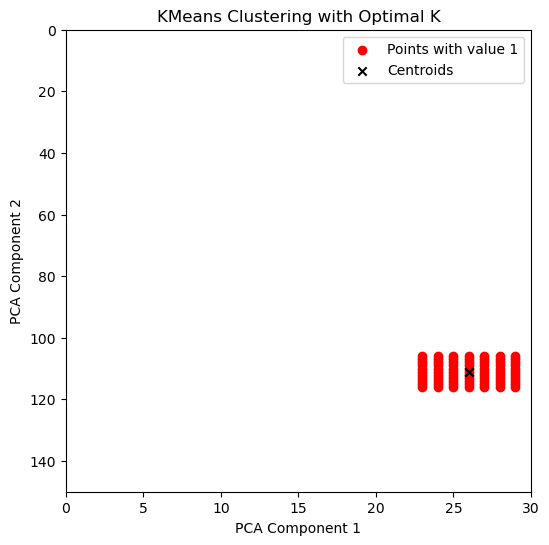

Coordinates of cluster centers:
Cluster 1: (26.0, 111.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 28.
checking image number: 235


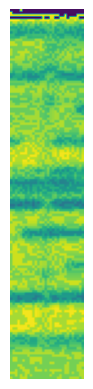

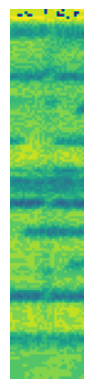

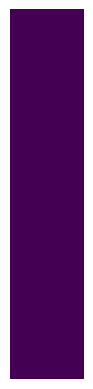

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)


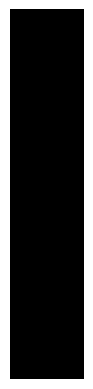

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 236


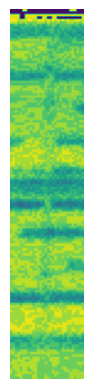

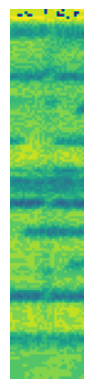

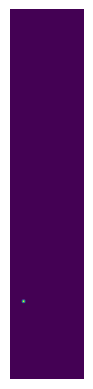

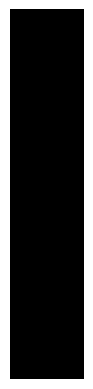

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 237


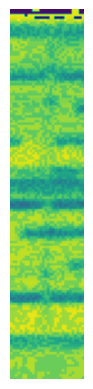

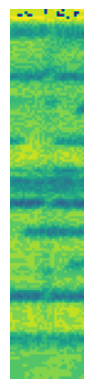

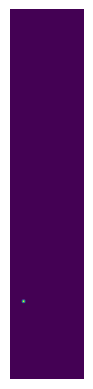

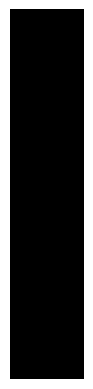

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 238


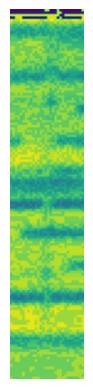

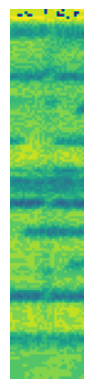

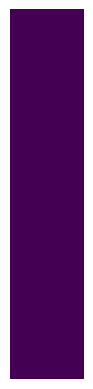

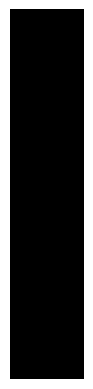

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 239


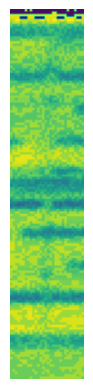

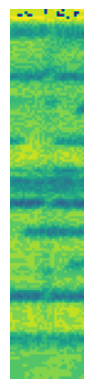

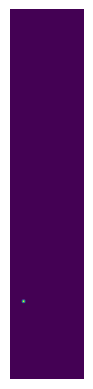

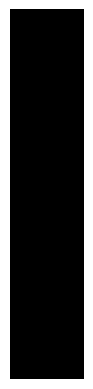

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 240


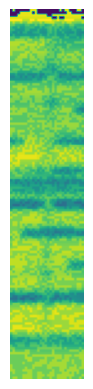

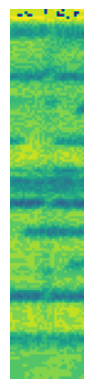

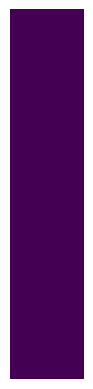

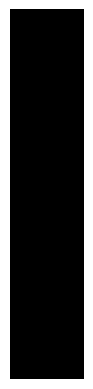

[]
X_pca is empty. Clustering plotting cannot be performed.
seen: 0
checking image number: 241


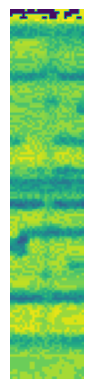

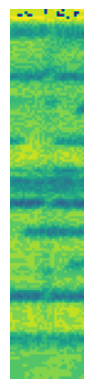

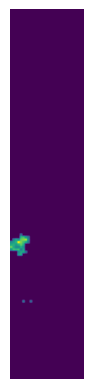

D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


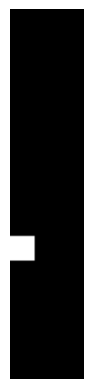

[[ 4.5 96.5]]


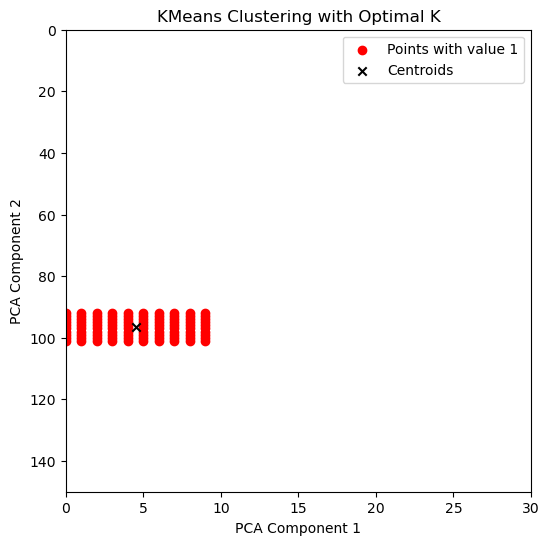

Coordinates of cluster centers:
Cluster 1: (4.5, 96.5)
seen: 1
checking image number: 242


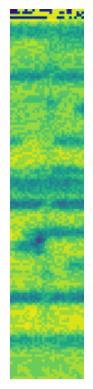

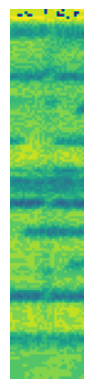

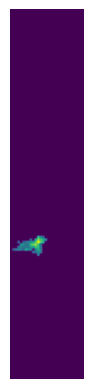

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


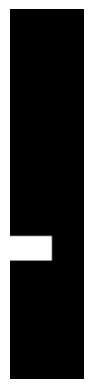

[[ 8.  96.5]]


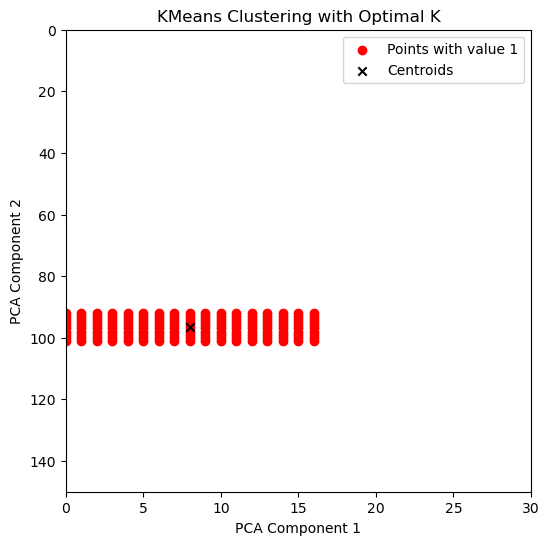

Coordinates of cluster centers:
Cluster 1: (8.0, 96.5)
seen: 1
checking image number: 243


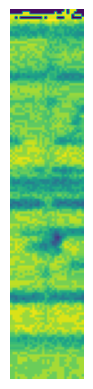

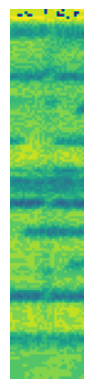

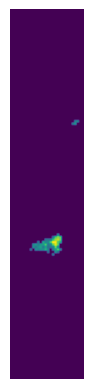

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

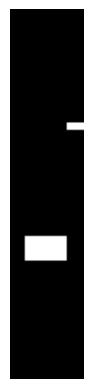

[[26.  47. ]
 [14.  96.5]]


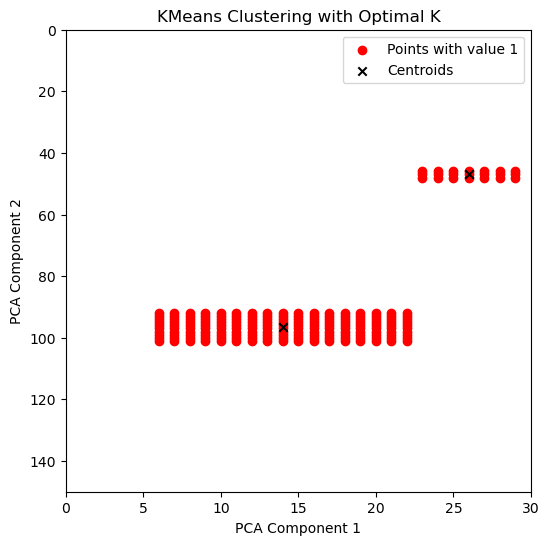

Coordinates of cluster centers:
Cluster 1: (26.0, 47.0)
Cluster 2: (14.0, 96.5)
seen: 2
checking image number: 244


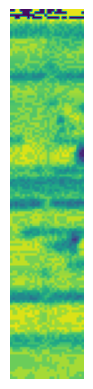

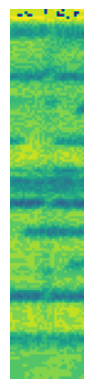

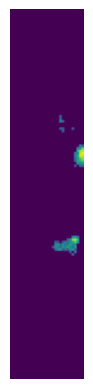

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

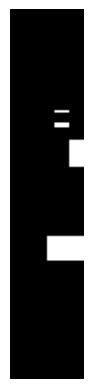

[[20.5 41. ]
 [20.5 46.5]
 [26.5 58. ]
 [22.  96.5]]


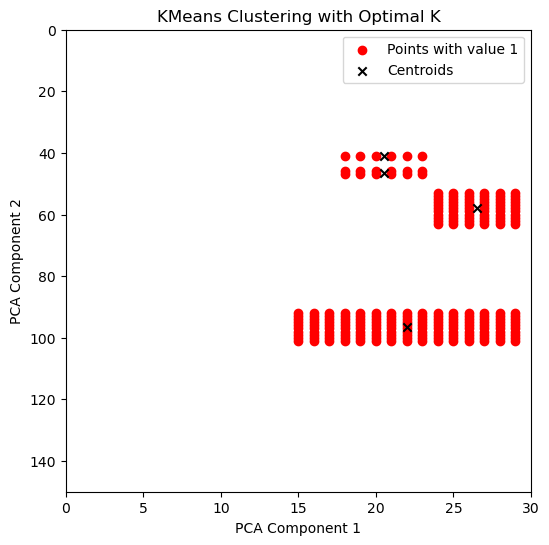

Coordinates of cluster centers:
Cluster 1: (20.5, 41.0)
Cluster 2: (20.5, 46.5)
Cluster 3: (26.5, 58.0)
Cluster 4: (22.0, 96.5)
seen: 4
checking image number: 245


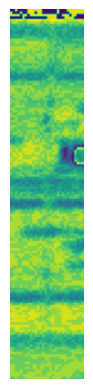

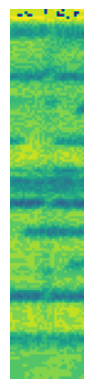

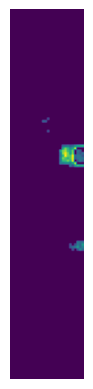

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

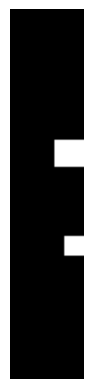

[[23.5 58. ]
 [25.5 95.5]]


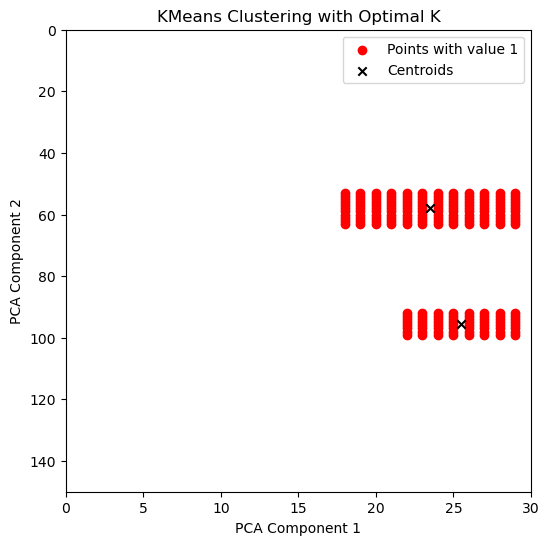

Coordinates of cluster centers:
Cluster 1: (23.5, 58.0)
Cluster 2: (25.5, 95.5)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 29.
checking image number: 246


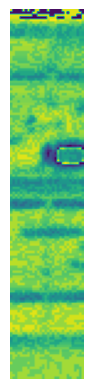

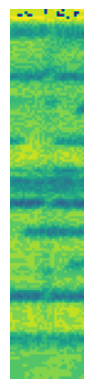

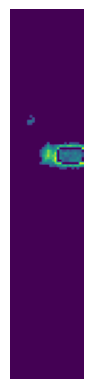

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

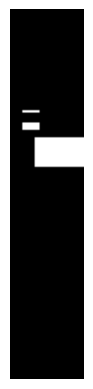

[[ 8.  41. ]
 [ 8.  47. ]
 [19.5 57.5]]


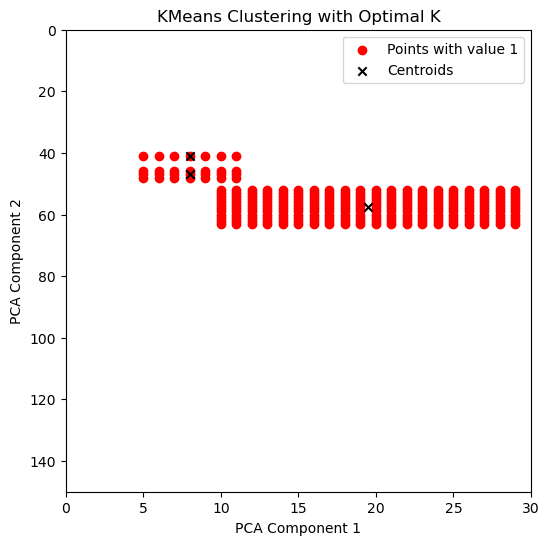

Coordinates of cluster centers:
Cluster 1: (8.0, 41.0)
Cluster 2: (8.0, 47.0)
Cluster 3: (19.5, 57.5)
seen: 3
checking image number: 247


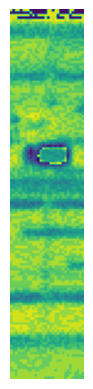

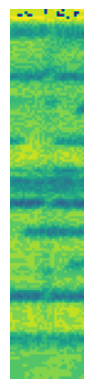

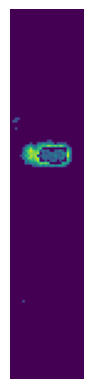

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there

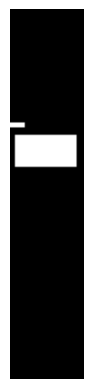

[[ 2.5 46.5]
 [14.  57. ]]


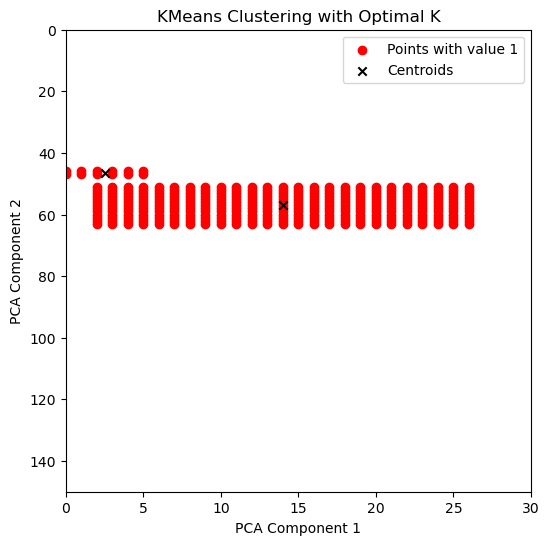

Coordinates of cluster centers:
Cluster 1: (2.5, 46.5)
Cluster 2: (14.0, 57.0)
seen: 2
Vehicle disappeared from the frame. Analyzing...
It's a truck.
Trucks counted so far: 7.
checking image number: 248


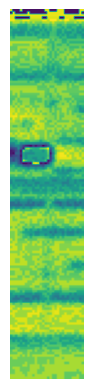

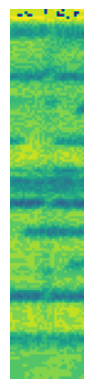

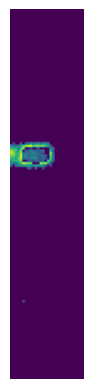

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


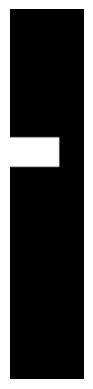

[[ 9.5 57.5]]


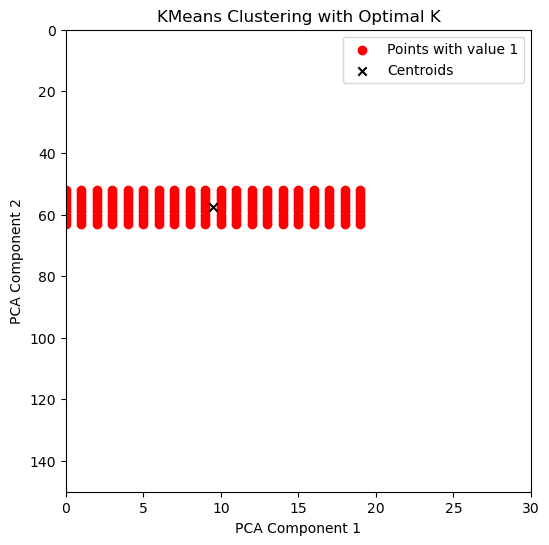

Coordinates of cluster centers:
Cluster 1: (9.5, 57.5)
seen: 1
checking image number: 249


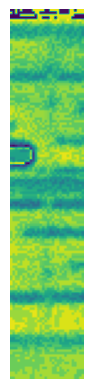

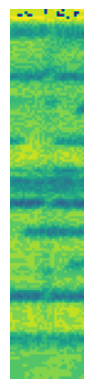

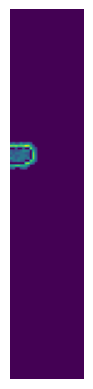

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


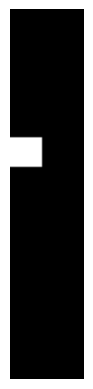

[[ 6.  57.5]]


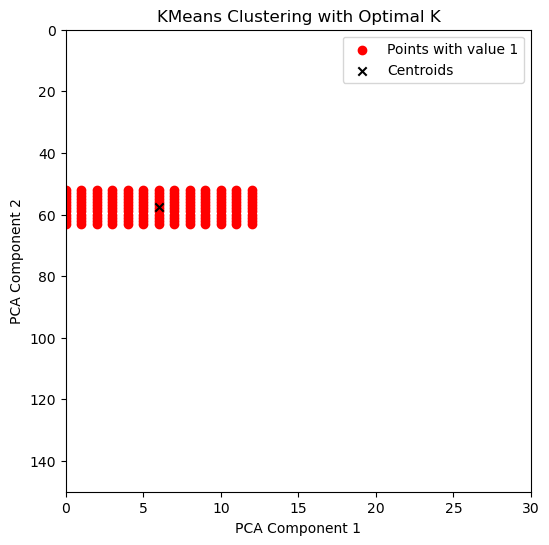

Coordinates of cluster centers:
Cluster 1: (6.0, 57.5)
seen: 1
checking image number: 250


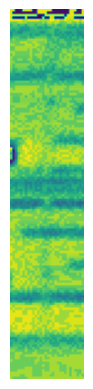

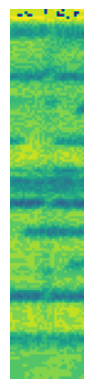

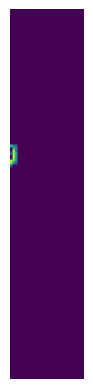

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_15880\2349344194.py:54: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
D:\Programs_D\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


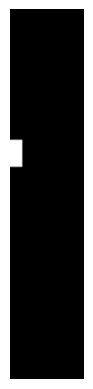

[[ 2. 58.]]


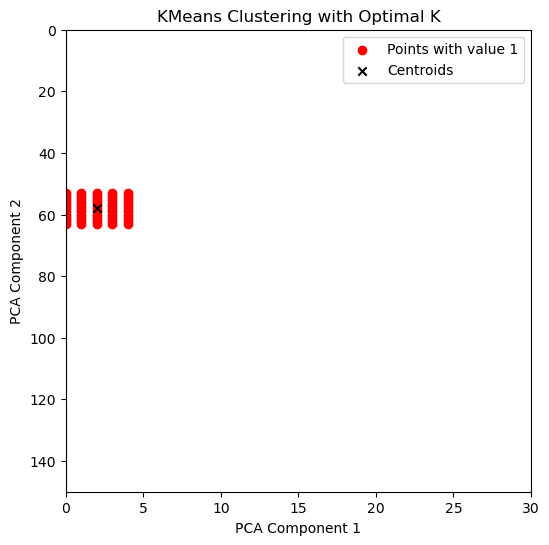

Coordinates of cluster centers:
Cluster 1: (2.0, 58.0)
seen: 1
Vehicle disappeared from the frame. Analyzing...
It's a car.
Cars counted so far: 30.
The final count is as follows: 30 cars and 7 trucks
lane 1 had: 7 small vehicles and 2 trucks going to the left
lane 2 had: 9 small vehicles and 2 trucks going to the left
lane 3 had: 0 small vehicles and 0 trucks going to the right
lane 4 had: 3 small vehicles and 1 trucks going to the right
lane 5 had: 7 small vehicles and 1 trucks going to the right


In [13]:
cars=0
trucks=0
cars=carsl+carsr
trucks=trucksl+trucksr

positionslane1 = np.empty((0,2))
positionslane2 = np.empty((0,2))
positionslane3 = np.empty((0,2))
positionslane4 = np.empty((0,2))
positionslane5 = np.empty((0,2))

frames_lane1 = 0
frames_lane2 = 0
frames_lane3 = 0
frames_lane4 = 0
frames_lane5 = 0

vehiclelane1 = 0
trucklane1=0
vehiclelane2 = 0
trucklane2=0
vehiclelane3 = 0
trucklane3=0
vehiclelane4 = 0
trucklane4=0
vehiclelane5 = 0
trucklane5=0

# Loop over all images from 1 to 2000
for image_to_check in range(1, 251):
    print(f"checking image number: {image_to_check}")
    sample = (pixel_values_array[image_to_check]).reshape(150, img_width)  # sample number from 0 to 69999

    # Display the sample image
    plt.imshow(sample)
    plt.axis('off')
    plt.show()

    emptyroad = (pixel_values_array[70]).reshape(150, img_width)  # This image is constant and helps us identify when the road is empty
    # Display the empty road image
    plt.imshow(emptyroad)
    plt.axis('off')
    plt.show()

    difference = (pixel_values_array[70] - pixel_values_array[image_to_check]).reshape(150, img_width)
    difference = np.where(difference < 0.2, 0, difference)
    difference[0:8, :] = 0
    # Display the difference image
    plt.imshow(difference)
    plt.axis('off')
    plt.show()

    # Thresholding and morphological operations
    threshold_value = 0.2  # Adjust this threshold as needed
    binary_image = (difference > threshold_value).astype(np.uint8)
    filled_image = morphology.remove_small_holes(binary_image, area_threshold=1)
    id_clean= lonely_pixels_to_0(filled_image)
    refilled = morphology.remove_small_holes(id_clean, area_threshold=200)
    rectangled=lonely_pixels_to_0(refilled)
    
    linelimit1=42
    linelimit2=64
    linelimit3=88
    linelimit4=102
    
    rectangled[linelimit1:(linelimit1+4),:]=0
    rectangled[linelimit2:(linelimit2+4),:]=0
    rectangled[linelimit3:(linelimit3+4),:]=0
    rectangled[linelimit4:(linelimit4+4),:]=0
  
    
    # Display the filled image
    plt.imshow(rectangled, cmap='gray')
    plt.axis('off')
    plt.show()
    
    identificator = np.where(rectangled, 1, 0)

    # Get the indices where the value is 1
    indices = np.argwhere(identificator == 1)
    # Extract x and y coordinates
    x_coords, y_coords = indices[:, 1], indices[:, 0]

    # Preprocess the data
    X_pca = indices.astype(float)
    preprocessed_points = preprocess_data(X_pca)
    
   # if len(X_pca) > 0:
        # Based on the elbow method, determine a sensible number of clusters
        #k_optimal = elbow_method(preprocessed_points)
        #kmeans_optimal = kmeans_clustering(preprocessed_points, k_optimal)
        #cluster_centers = kmeans_optimal.cluster_centers_
    cluster_centers = find_group_centroids(rectangled)
    cluster_centers =np.array(cluster_centers)
    print(cluster_centers)
    
    # Plot clusters
    if len(cluster_centers) > 0:
        plt.figure(figsize=(6, 6))
        
        plt.scatter(x_coords, y_coords, color='red', marker='o', label='Points with value 1')
        plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], color='black', marker='x', label='Centroids')
        plt.xlim(0, 30)
        plt.ylim(0, 150)
        plt.gca().invert_yaxis()
        plt.title('KMeans Clustering with Optimal K')
        plt.xlabel('PCA Component 1')
        plt.ylabel('PCA Component 2')
        plt.legend()
        plt.show()

        centroids = np.vstack(cluster_centers)
    else:
        print("X_pca is empty. Clustering plotting cannot be performed.")

    # Print the coordinates of the cluster centers
    if len(X_pca) > 0:
        print("Coordinates of cluster centers:")
        for i, center in enumerate(cluster_centers):
            print(f"Cluster {i+1}: ({center[0]}, {center[1]})")

    seen = len(cluster_centers)
    print(f"seen: {seen}")

    positionslane1_history = np.empty((0, 2))  # History of positions for lane 1
    positionslane2_history = np.empty((0, 2))  # History of positions for lane 2
    positionslane3_history = np.empty((0, 2))  # History of positions for lane 3
    positionslane4_history = np.empty((0, 2))  # History of positions for lane 4
    positionslane5_history = np.empty((0, 2))  # History of positions for lane 4

    positionslane1_current = np.empty((0, 2))  # Current positions for lane 1
    positionslane2_current = np.empty((0, 2))  # Current positions for lane 2
    positionslane3_current = np.empty((0, 2))  # Current positions for lane 3
    positionslane4_current = np.empty((0, 2))  # Current positions for lane 4
    positionslane5_current = np.empty((0, 2))  # Current positions for lane 4







    for i in range(seen):
        if 0 < cluster_centers[i, 1] <= linelimit1:
            
            positionslane1_history = np.vstack((positionslane1_history, cluster_centers[i]))
            positionslane1_current = np.vstack((positionslane1_current, cluster_centers[i]))
            

            if cluster_centers[i, 0] < 5:
                print("Vehicle disappeared from the frame. Analyzing...")
                
                if frames_lane1 <= 6:
                    print("It's a car.")
                    cars+=1
                    vehiclelane1 += 1
                    print(f"Cars counted so far: {cars}.")
                else:
                    print("It's a truck.")
                    trucks+=1
                    trucklane1 +=1
                    print(f"Trucks counted so far: {trucks}.")
                frames_lane1 = 0  # Reset frame count for lane 1
                positionslane1_current = np.empty((0, 2))  # Clear current positions array for lane 
            else:
                frames_lane1 += 1
    
        
        elif (linelimit1+4) <= cluster_centers[i, 1] <= linelimit2:
            
            positionslane2_history = np.vstack((positionslane2_history, cluster_centers[i]))
            positionslane2_current = np.vstack((positionslane2_current, cluster_centers[i]))
            #print(f"Lane 2 has: {vehiclelane2} unidentified vehicles going to the left")
            #print(f"Lane 2 has: {len(positionslane2_history)} unidentified vehicles SO FAR going to the left")
        
            if cluster_centers[i, 0] < 4:
                print("Vehicle disappeared from the frame. Analyzing...")
                
                if frames_lane2 <= 6:
                    print("It's a car.")
                    cars+=1
                    vehiclelane2 += 1
                    print(f"Cars counted so far: {cars}.")
                else:
                    print("It's a truck.")
                    trucks+=1
                    trucklane2 +=1
                    print(f"Trucks counted so far: {trucks}.")
                frames_lane2 = 0  # Reset frame count for lane 1
                positionslane2_current = np.empty((0, 2))  # Clear current positions array for lane 1
            else:
                frames_lane2 += 1        
        
        
        elif (linelimit2+4) <= cluster_centers[i, 1] <= linelimit3:
         
            positionslane3_history = np.vstack((positionslane3_history, cluster_centers[i]))
            positionslane3_current = np.vstack((positionslane3_current, cluster_centers[i]))
            #print(f"Lane 3 has: {vehiclelane3} unidentified vehicles going to the right")
            #print(f"Lane 3 has: {len(positionslane3_history)} unidentified vehicles SO FAR going to the left")
        
            if cluster_centers[i, 0] > 25:
                print("Vehicle disappeared from the frame. Analyzing...")
                
                if frames_lane3 <= 6:
                    print("It's a car.")
                    cars+=1
                    vehiclelane3 += 1
                    print(f"Cars counted so far: {cars}.")
                else:
                    print("It's a truck.")
                    trucks+=1
                    trucklane3 +=1
                    print(f"Trucks counted so far: {trucks}.")
                frames_lane3 = 0  # Reset frame count for lane 1
                positionslane3_current = np.empty((0, 2))  # Clear current positions array for lane 1
            else:
                frames_lane3 += 1
        
        elif (linelimit3+4) <= cluster_centers[i, 1] <= linelimit4:
            
            positionslane4_history = np.vstack((positionslane4_history, cluster_centers[i]))
            positionslane4_current = np.vstack((positionslane4_current, cluster_centers[i]))
            #print(f"Lane 4 has: {vehiclelane4} unidentified vehicles going to the right")
            #print(f"Lane 4 has: {len(positionslane4_history)} unidentified vehicles SO FAR going to the left")
        
            if cluster_centers[i, 0] > 25:
                print("Vehicle disappeared from the frame. Analyzing...")
                
                if frames_lane4 <= 6:
                    print("It's a car.")
                    cars+=1
                    vehiclelane4 += 1
                    print(f"Cars counted so far: {cars}.")
                else:
                    print("It's a truck.")
                    trucks+=1
                    trucklane4 +=1
                    print(f"Trucks counted so far: {trucks}.")
                frames_lane4 = 0  # Reset frame count for lane 1
                positionslane4_current = np.empty((0, 2))  # Clear current positions array for lane 1
            else:
                frames_lane4 += 1
                
        elif (linelimit4+4) <= cluster_centers[i, 1] <= 150:
            
            positionslane5_history = np.vstack((positionslane5_history, cluster_centers[i]))
            positionslane5_current = np.vstack((positionslane5_current, cluster_centers[i]))
            #print(f"Lane 4 has: {vehiclelane5} unidentified vehicles going to the right")
            #print(f"Lane 4 has: {len(positionslane5_history)} unidentified vehicles SO FAR going to the left")
        
            if cluster_centers[i, 0] > 25:
                print("Vehicle disappeared from the frame. Analyzing...")
                
                if frames_lane5 <= 6:
                    print("It's a car.")
                    cars+=1
                    vehiclelane5 += 1
                    print(f"Cars counted so far: {cars}.")
                else:
                    print("It's a truck.")
                    trucks+=1
                    trucklane5 +=1
                    print(f"Trucks counted so far: {trucks}.")
                frames_lane5 = 0  # Reset frame count for lane 1
                positionslane5_current = np.empty((0, 2))  # Clear current positions array for lane 1
            else:
                frames_lane5 += 1
                
        else:
            print(f"no vehicles found")


print(f"The final count is as follows: {cars} cars and {trucks} trucks")

print(f"lane 1 had: {vehiclelane1} small vehicles and {trucklane1} trucks going to the left")
print(f"lane 2 had: {vehiclelane2} small vehicles and {trucklane2} trucks going to the left")
print(f"lane 3 had: {vehiclelane3} small vehicles and {trucklane3} trucks going to the right")
print(f"lane 4 had: {vehiclelane4} small vehicles and {trucklane4} trucks going to the right")
print(f"lane 5 had: {vehiclelane5} small vehicles and {trucklane5} trucks going to the right")
      
      
    
    
    


